# Capstone Project - The Battle of Neighborhoods

### Introduction

New York City's demographics show that it is a large and ethnically diverse metropolis. It is the largest city in the United States with a long history of international immigration. New York City was home to nearly 8.5 million people in 2014, accounting for over 40% of the population of New York State and a slightly lower percentage of the New York metropolitan area, home to approximately 23.6 million. Over the last decade the city has been growing faster than the region. The New York region continues to be by far the leading metropolitan gateway for legal immigrants admitted into the United States.

Throughout its history, New York City has been a major point of entry for immigrants; the term "melting pot" was coined to describe densely populated immigrant neighborhoods on the Lower East Side. As many as 800 languages are spoken in New York, making it the most linguistically diverse city in the world. English remains the most widely spoken language, although there are areas in the outer boroughs in which up to 25% of people speak English as an alternate language, and/or have limited or no English language fluency. English is least spoken in neighborhoods such as Flushing, Sunset Park, and Corona.

With it's diverse culture , comes diverse food items. There are many resturants in New york City, each beloning to different categories like Chinese , Indian , French etc.

So as part of this project , we will list and visualize all major parts of New York City that has great indian resturants.

### Data 
For this project we need the following data :
<ul>
<li> New York City data that contains list Boroughs, Neighborhoods along with their latitude and longitude.
    <ul>
        <li>Data source : https://cocl.us/new_york_dataset
        <li> Description : This data set contains the required information. And we will use this data set to explore various neighborhoods of new york city.
     </ul>
<li> Indian resturants in each neighborhood of new york city.
        <ul>
        <li>Data source : Fousquare API
        <li> Description : By using this api we will get all the venues in each neighborhood. We can filter these venues to get only indian resturants.
     </ul>
<li> GeoSpace data
          <ul>
        <li>Data source : https://data.cityofnewyork.us/City-Government/Borough-Boundaries/tqmj-j8zm
        <li> Description : By using this geo space data we will get the New york Borough boundaries that will help us visualize choropleth map.
  
</ul>

### Approach
- Collect the new york city data from https://cocl.us/new_york_dataset
- Using FourSquare API we will find all venues for each neighborhood.
- Filter out all venues that are Indian Resturants.
- Find rating , tips and like count for each Indian Resturants using FourSquare API.
- Using rating for each resturant , we will sort that data.
- Visualize the Ranking of neighborhoods using folium library(python)

### Questions that can be asked using the above mentioned datasets
- What is best location in New York City for Indian Cuisine ? 
- Which areas have potential Indian Resturant Market ? 
- Which all areas lack Indian Resturants ?
- Which is the best place to stay if I prefer Indian Cuisine ?

### Analysis

We will import the required libraries for python.

- pandas and numpy for handling data.
- request module for using FourSquare API.
- geopy to get co-ordinates of City of New York.
- folium to visualize the results on a map

In [146]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import requests
from bs4 import BeautifulSoup
import geocoder
import os
import folium # map rendering library
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values
# Matplotlib and associated plotting modules
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
%matplotlib inline


print('Libraries imported.')

Libraries imported.


Now we define a function to get the geocodes i.e latitude and longitude of a given location using geopy.

In [147]:
def geo_location(address):
    # get geo location of address
    geolocator = Nominatim(user_agent="ny_explorer")
    location = geolocator.geocode(address)
    latitude = location.latitude
    longitude = location.longitude
    return latitude,longitude

We define a function to intract with FourSquare API and get top 100 venues within a radius of 1000 metres for a given  latitude and longitude. Below function will return us the venue id , venue name and category.

In [148]:
def get_venues(lat,lng):
    
    #set variables
    radius=1000
    LIMIT=100
    CLIENT_ID = 'L3O0TA4J1WJWE2XZPJW2DY5ACD4HR1K0GHPDSEFWXRPI3JNF' # your Foursquare ID
    CLIENT_SECRET = 'GFXGZQNAAIR0FIUTAMABEB1ALXDIWNTO5SPGGKFMINIR1GYM' # your Foursquare Secret
    VERSION = '20180605' # Foursquare API version
    
    #url to fetch data from foursquare api
    url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
    
    # get all the data
    results = requests.get(url).json()
    print(results)
    venue_data=results["response"]["groups"][0]['items']
    venue_details=[]
    for row in venue_data:
        try:
            venue_id=row['venue']['id']
            venue_name=row['venue']['name']
            venue_category=row['venue']['categories'][0]['name']
            venue_details.append([venue_id,venue_name,venue_category])
        except KeyError:
            pass
        
    column_names=['ID','Name','Category']
    df = pd.DataFrame(venue_details,columns=column_names)
    return df
    

Now we will define a function to get venue details like like count , rating , tip counts for a given venue id.
This will be used for ranking.

In [149]:
def get_venue_details(venue_id):
        
    CLIENT_ID = 'L3O0TA4J1WJWE2XZPJW2DY5ACD4HR1K0GHPDSEFWXRPI3JNF' # your Foursquare ID
    CLIENT_SECRET = 'GFXGZQNAAIR0FIUTAMABEB1ALXDIWNTO5SPGGKFMINIR1GYM' # your Foursquare Secret
    VERSION = '20180605' # Foursquare API version
    
    #url to fetch data from foursquare api
    url = 'https://api.foursquare.com/v2/venues/{}?&client_id={}&client_secret={}&v={}'.format(
            venue_id,
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION)
    
    # get all the data
    results = requests.get(url).json()
    venue_data=results['response']['venue']
    venue_details=[]
    try:
        venue_id=venue_data['id']
        venue_name=venue_data['name']
        venue_likes=venue_data['likes']['count']
        venue_rating=venue_data['rating']
        venue_tips=venue_data['tips']['count']
        venue_details.append([venue_id,venue_name,venue_likes,venue_rating,venue_tips])
    except KeyError:
        pass
        
    column_names=['ID','Name','Likes','Rating','Tips']
    df = pd.DataFrame(venue_details,columns=column_names)
    return df


Now we define a funtion to get the new york city data such as Boroughs, Neighborhoods along with their latitude and longitude.

In [150]:
def get_new_york_data():
    url='https://cocl.us/new_york_dataset'
    resp=requests.get(url).json()
    # all data is present in features label
    features=resp['features']
    
    # define the dataframe columns
    column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 
    # instantiate the dataframe
    new_york_data = pd.DataFrame(columns=column_names)
    
    for data in features:
        borough = data['properties']['borough'] 
        neighborhood_name = data['properties']['name']
        
        neighborhood_latlon = data['geometry']['coordinates']
        neighborhood_lat = neighborhood_latlon[1]
        neighborhood_lon = neighborhood_latlon[0]
    
        new_york_data = new_york_data.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)
    
    return new_york_data

We will call the above funtion to get the new york city data.

In [151]:
# get new york data
new_york_data=get_new_york_data()
new_york_data.head()

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585


In [152]:
new_york_data.shape

(306, 4)

So there are total of 306 different Neighborhoods in New York


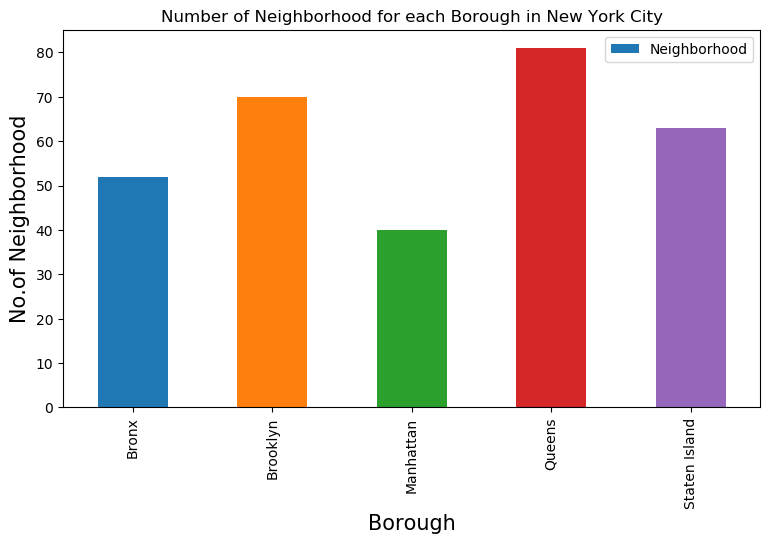

In [153]:
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Number of Neighborhood for each Borough in New York City')
#On x-axis
plt.xlabel('Borough', fontsize = 15)
#On y-axis
plt.ylabel('No.of Neighborhood', fontsize=15)
#giving a bar plot
new_york_data.groupby('Borough')['Neighborhood'].count().plot(kind='bar')
#legend
plt.legend()
#displays the plot
plt.show()

We see that Queens has highest number of neighborhoods

Now we will collect Indian resturants for each Neighborhood

In [155]:
# prepare neighborhood list that contains indian resturants
column_names=['Borough', 'Neighborhood', 'ID','Name']
indian_rest_ny=pd.DataFrame(columns=column_names)
count=1
for row in new_york_data.values.tolist():
    Borough, Neighborhood, Latitude, Longitude=row
    venues = get_venues(Latitude,Longitude)
    indian_resturants=venues[venues['Category']=='Indian Restaurant']   
    print('(',count,'/',len(new_york_data),')','Indian Resturants in '+Neighborhood+', '+Borough+':'+str(len(indian_resturants)))
    for resturant_detail in indian_resturants.values.tolist():
        id, name , category=resturant_detail
        indian_rest_ny = indian_rest_ny.append({'Borough': Borough,
                                                'Neighborhood': Neighborhood, 
                                                'ID': id,
                                                'Name' : name
                                               }, ignore_index=True)
    count+=1

{'meta': {'code': 200, 'requestId': '5e0f6d0b9da7ee001b03d52b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Wakefield', 'headerFullLocation': 'Wakefield, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 42, 'suggestedBounds': {'ne': {'lat': 40.903705185610015, 'lng': -73.83531662200086}, 'sw': {'lat': 40.88570516760999, 'lng': -73.85908441909719}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c537892fd2ea593cb077a28', 'name': 'Lollipops Gelato', 'location': {'address': '4120 Baychester Ave', 'crossStreet': 'Edenwald & Bussing Ave', 'lat': 40.894123150205274, 'lng': -73.84589162362325, 'labeledLatLngs': [{'label': 'display', 'lat': 40.894123150205274, 'lng': -73.84

{'meta': {'code': 200, 'requestId': '5e0f6cfc83525f001b36fd13'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Co-Op City', 'headerFullLocation': 'Co-Op City, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 88, 'suggestedBounds': {'ne': {'lat': 40.88329420203013, 'lng': -73.81805887418497}, 'sw': {'lat': 40.865294184030105, 'lng': -73.84181934206299}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '524b6ca6498e92aa03e03ff4', 'name': 'Dumplin Shop', 'location': {'address': '1530 E 222nd St', 'lat': 40.876042191838856, 'lng': -73.83595004760689, 'labeledLatLngs': [{'label': 'display', 'lat': 40.876042191838856, 'lng': -73.83595004760689}], 'distance': 542, 'postalCode': 

{'meta': {'code': 200, 'requestId': '5e0f6d310be7b4001b792abf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Eastchester', 'headerFullLocation': 'Eastchester, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 71, 'suggestedBounds': {'ne': {'lat': 40.89655568635079, 'lng': -73.8159238326733}, 'sw': {'lat': 40.878555668350764, 'lng': -73.83968906165494}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '515cc20ce4b0deb133b8e89b', 'name': 'Fish & Ting', 'location': {'address': '4063 Boston Rd', 'lat': 40.885656, 'lng': -73.829197, 'labeledLatLngs': [{'label': 'display', 'lat': 40.885656, 'lng': -73.829197}], 'distance': 241, 'postalCode': '10466', 'cc': 'US', 'city': 'Bronx

{'meta': {'code': 200, 'requestId': '5e0f6cdce826ac001e43fb73'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Fieldston', 'headerFullLocation': 'Fieldston, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 51, 'suggestedBounds': {'ne': {'lat': 40.904437435903844, 'lng': -73.89375856582964}, 'sw': {'lat': 40.88643741790382, 'lng': -73.91752662600399}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49e33171f964a5206a621fe3', 'name': 'Wave Hill', 'location': {'address': '675 W 252nd St', 'crossStreet': 'Independence Ave', 'lat': 40.900062189494726, 'lng': -73.9124461576627, 'labeledLatLngs': [{'label': 'display', 'lat': 40.900062189494726, 'lng': -73.9124461576627}], 'dis

{'meta': {'code': 200, 'requestId': '5e0f6d399da7ee001b0460c9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Riverdale', 'headerFullLocation': 'Riverdale, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 48, 'suggestedBounds': {'ne': {'lat': 40.899834502891316, 'lng': -73.90070225777352}, 'sw': {'lat': 40.88183448489129, 'lng': -73.92446866439788}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c268383136d20a15a83e561', 'name': 'Riverdale Ave', 'location': {'lat': 40.890424929507866, 'lng': -73.91024841803598, 'labeledLatLngs': [{'label': 'display', 'lat': 40.890424929507866, 'lng': -73.91024841803598}], 'distance': 201, 'postalCode': '10463', 'cc': 'US', 'city': 'B

{'meta': {'code': 200, 'requestId': '5e0f6d1e0cc1fd001b1696f5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Kingsbridge', 'headerFullLocation': 'Kingsbridge, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 103, 'suggestedBounds': {'ne': {'lat': 40.89068738020522, 'lng': -73.8909364263634}, 'sw': {'lat': 40.8726873622052, 'lng': -73.91469954812868}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4af8b2c0f964a520460f22e3', 'name': 'Garden Gourmet Market', 'location': {'address': '5665 Broadway', 'crossStreet': 'btwn W 233rd & W 234th St', 'lat': 40.88135023917183, 'lng': -73.90338943716417, 'labeledLatLngs': [{'label': 'display', 'lat': 40.88135023917183, 'lng': -73.

{'meta': {'code': 200, 'requestId': '5e0f6cfa882fc7001bffda9b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Marble Hill', 'headerFullLocation': 'Marble Hill, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 82, 'suggestedBounds': {'ne': {'lat': 40.88555078779965, 'lng': -73.89877901972629}, 'sw': {'lat': 40.86755076979963, 'lng': -73.92254029753333}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4baf59e8f964a520a6f93be3', 'name': 'Bikram Yoga', 'location': {'address': '5500 Broadway', 'crossStreet': '230th Street', 'lat': 40.876843690797934, 'lng': -73.90620384419528, 'labeledLatLngs': [{'label': 'display', 'lat': 40.876843690797934, 'lng': -73.90620384419528}],

{'meta': {'code': 200, 'requestId': '5e0f6d4ec8cff2001b6d287f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Woodlawn Heights', 'headerFullLocation': 'Woodlawn Heights, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 49, 'suggestedBounds': {'ne': {'lat': 40.90727262113806, 'lng': -73.85543042870555}, 'sw': {'lat': 40.88927260313804, 'lng': -73.87919950757797}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba50da6f964a52046d638e3', 'name': 'Katonah Pizza and Pasta', 'location': {'address': '4307 Katonah Ave', 'lat': 40.89878411126604, 'lng': -73.86745706580207, 'labeledLatLngs': [{'label': 'display', 'lat': 40.89878411126604, 'lng': -73.86745706580207}], 'distance'

{'meta': {'code': 200, 'requestId': '5e0f6d586001fe001bca5fc5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Norwood', 'headerFullLocation': 'Norwood, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 78, 'suggestedBounds': {'ne': {'lat': 40.88622416499447, 'lng': -73.8675099798121}, 'sw': {'lat': 40.86822414699445, 'lng': -73.89127149932409}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb626e0f562ef3b2fb32f97', 'name': "Sal's Pizzeria", 'location': {'address': '3167 Bainbridge Ave', 'crossStreet': 'E 205th St', 'lat': 40.875269350530566, 'lng': -73.87956260705728, 'labeledLatLngs': [{'label': 'display', 'lat': 40.875269350530566, 'lng': -73.87956260705728}], 'dis

{'meta': {'code': 200, 'requestId': '5e0f6cf295feaf001b139a9d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Williamsbridge', 'headerFullLocation': 'Williamsbridge, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 62, 'suggestedBounds': {'ne': {'lat': 40.89003888719212, 'lng': -73.84556498527213}, 'sw': {'lat': 40.872038869192096, 'lng': -73.869327874212}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bbf1a10006dc9b6eb00fc3f', 'name': "Frank's Soup Bowl", 'location': {'address': '3580 Bronxwood Ave', 'crossStreet': 'Gunhill Road', 'lat': 40.877494, 'lng': -73.85914100000001, 'labeledLatLngs': [{'label': 'display', 'lat': 40.877494, 'lng': -73.85914100000001}], 'dis

{'meta': {'code': 200, 'requestId': '5e0f6d447828ae001b48d2d5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Baychester', 'headerFullLocation': 'Baychester, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 103, 'suggestedBounds': {'ne': {'lat': 40.87585811625271, 'lng': -73.8239186982885}, 'sw': {'lat': 40.857858098252684, 'lng': -73.84767649787385}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be2ecf6b02ec9b6a5064ec0', 'name': 'Caridad & Louie', 'location': {'address': '1660 E Gun Hill Rd', 'lat': 40.86584304086998, 'lng': -73.83770669702484, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86584304086998, 'lng': -73.83770669702484}], 'distance': 196, 'postalCod

{'meta': {'code': 200, 'requestId': '5e0f6d53c94979268cfa5a90'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pelham Parkway', 'headerFullLocation': 'Pelham Parkway, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 40.86641350708866, 'lng': -73.84287843417286}, 'sw': {'lat': 40.848413489088635, 'lng': -73.86663284618712}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '51cca5f5498e2220a7f4f0cf', 'name': 'Peach Wave', 'location': {'address': '2125 Williamsbridge Rd', 'crossStreet': 'Pelham Parkway', 'lat': 40.85605141607515, 'lng': -73.85570606675319, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85605141607515, 'lng': -73.85570

{'meta': {'code': 200, 'requestId': '5e0f6d4fedbcad001bf6064c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'City Island', 'headerFullLocation': 'City Island, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 44, 'suggestedBounds': {'ne': {'lat': 40.85624671391814, 'lng': -73.77461306906787}, 'sw': {'lat': 40.838246695918116, 'lng': -73.7983638362804}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4514ed4df964a520e5391fe3', 'name': "Artie's Steak and Seafood", 'location': {'address': '394 City Island Ave', 'lat': 40.849542144998146, 'lng': -73.78731730033616, 'labeledLatLngs': [{'label': 'display', 'lat': 40.849542144998146, 'lng': -73.78731730033616}], 'distance': 2

{'meta': {'code': 200, 'requestId': '5e0f6d486d8c56001b9efc02'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bedford Park', 'headerFullLocation': 'Bedford Park, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 77, 'suggestedBounds': {'ne': {'lat': 40.87918517397534, 'lng': -73.87363268753589}, 'sw': {'lat': 40.86118515597531, 'lng': -73.89739168084671}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e20d96152b1f82ffb98c3a5', 'name': 'E. Mosholu Parkway South and Bainbridge Ave', 'location': {'lat': 40.87224819764808, 'lng': -73.88228625969055, 'labeledLatLngs': [{'label': 'display', 'lat': 40.87224819764808, 'lng': -73.88228625969055}], 'distance': 355, 'cc': 'US', 

{'meta': {'code': 200, 'requestId': '5e0f6d57542890001b8b94bb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'University Heights', 'headerFullLocation': 'University Heights, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 61, 'suggestedBounds': {'ne': {'lat': 40.86472708619665, 'lng': -73.89853905826202}, 'sw': {'lat': 40.84672706819663, 'lng': -73.92229286556419}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50bd5089e4b0e53ea372c8ec', 'name': 'Salsa Con Fuego', 'location': {'address': '2297 Cedar Ave', 'lat': 40.86266522656766, 'lng': -73.9115300460878, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86266522656766, 'lng': -73.9115300460878}], 'distance': 778, '

{'meta': {'code': 200, 'requestId': '5e0f6d5cc8cff2001b6d7a20'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Morris Heights', 'headerFullLocation': 'Morris Heights, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 61, 'suggestedBounds': {'ne': {'lat': 40.85689793506272, 'lng': -73.90779609088577}, 'sw': {'lat': 40.838897917062695, 'lng': -73.93154709150554}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e39863dae60f589a5dc0dcb', 'name': 'Yoly Restaurant', 'location': {'address': 'Featherbed Lane & Nelson Ave.', 'lat': 40.8460420585989, 'lng': -73.91971559956264, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8460420585989, 'lng': -73.91971559956264}], 'distance'

{'meta': {'code': 200, 'requestId': '5e0f6d4a6d8c56001b9f09ca'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Bronx', 'headerFullLocation': 'West Bronx, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 141, 'suggestedBounds': {'ne': {'lat': 40.86999680538655, 'lng': -73.8845487112793}, 'sw': {'lat': 40.851996787386526, 'lng': -73.90830440835317}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5647571c498e97b3fdee10fd', 'name': 'Fresh Frutii', 'location': {'address': '2449 Creston Ave', 'lat': 40.861625, 'lng': -73.89894699999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.861625, 'lng': -73.89894699999999}], 'distance': 223, 'postalCode': '10468', 'cc': 'U

{'meta': {'code': 200, 'requestId': '5e0f6d65be61c9001ba47dbe'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Farms', 'headerFullLocation': 'West Farms, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 73, 'suggestedBounds': {'ne': {'lat': 40.85169616686054, 'lng': -73.87548160710183}, 'sw': {'lat': 40.83369614886052, 'lng': -73.89923074354492}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d39a9bacc48224b57ae354f', 'name': 'North Star Cafe', 'location': {'address': '850 E Tremont Ave', 'crossStreet': 'Corner of Marmion', 'lat': 40.84333558876738, 'lng': -73.88698194733944, 'labeledLatLngs': [{'label': 'display', 'lat': 40.84333558876738, 'lng': -73.88698194733

{'meta': {'code': 200, 'requestId': '5e0f6cef963d29001b651ebc'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'West Farms', 'headerFullLocation': 'West Farms, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 47, 'suggestedBounds': {'ne': {'lat': 40.84847506572654, 'lng': -73.86587075794037}, 'sw': {'lat': 40.830475047726516, 'lng': -73.88961874027052}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb2d8f214cfd13abf7c15ab', 'name': 'Tropicana Theatere & Lounge', 'location': {'address': '1060 Home St', 'crossStreet': 'Westchester Ave', 'lat': 40.83740441148761, 'lng': -73.87792219453874, 'labeledLatLngs': [{'label': 'display', 'lat': 40.83740441148761, 'lng': -73.87792219453874}], 'distance': 230, 'posta

{'meta': {'code': 200, 'requestId': '5e0f6cf9006dce001b8f977a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Highbridge', 'headerFullLocation': 'Highbridge, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 39, 'suggestedBounds': {'ne': {'lat': 40.84562301970607, 'lng': -73.91422861327878}, 'sw': {'lat': 40.827623001706044, 'lng': -73.93797557388383}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5578d1fc498efdba911d7b1b', 'name': 'High Bridge', 'location': {'address': 'Harlem River Dr. & W. 172nd St.', 'lat': 40.84204906609031, 'lng': -73.9270467509362, 'distance': 609, 'postalCode': '10452', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States',

{'meta': {'code': 200, 'requestId': '5e0f6d4ad03993001c798e50'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Bronx', 'headerFullLocation': 'West Bronx, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 94, 'suggestedBounds': {'ne': {'lat': 40.82875437959495, 'lng': -73.89755114730674}, 'sw': {'lat': 40.810754361594924, 'lng': -73.92129206784197}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f0f4fe14fc6e3adf353a950', 'name': 'Blink Fitness', 'location': {'address': '744 Saint Anns Ave', 'crossStreet': "St. Ann's Avenue & E 156 St", 'lat': 40.819348335992856, 'lng': -73.91037296422388, 'labeledLatLngs': [{'label': 'display', 'lat': 40.819348335992856, 'lng': -73

{'meta': {'code': 200, 'requestId': '5e0f6d4aad1ab4001b016cca'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Mott Haven', 'headerFullLocation': 'Mott Haven, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 66, 'suggestedBounds': {'ne': {'lat': 40.81523875835178, 'lng': -73.90423183249315}, 'sw': {'lat': 40.79723874035176, 'lng': -73.92796791725836}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb28791715eef3b9f5e85bb', 'name': 'Pio Pio', 'location': {'address': '264 Cypress Ave', 'crossStreet': 'at E 139th St', 'lat': 40.80604732187535, 'lng': -73.91418540969559, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80604732187535, 'lng': -73.91418540969559}], 'distan

{'meta': {'code': 200, 'requestId': '5e0f6d507828ae001b4916c9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Port Morris', 'headerFullLocation': 'Port Morris, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 38, 'suggestedBounds': {'ne': {'lat': 40.81066363675622, 'lng': -73.9013541695751}, 'sw': {'lat': 40.792663618756194, 'lng': -73.9250886181476}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5151c128e4b026975853f870', 'name': 'The Bronx Brewery', 'location': {'address': '856 E 136th St', 'crossStreet': 'between Willow Ave and Walnut Ave', 'lat': 40.80177432001329, 'lng': -73.91029715538025, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80177432001329, 'lng':

{'meta': {'code': 200, 'requestId': '5e0f6d749fcb92001b2da089'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Longwood', 'headerFullLocation': 'Longwood, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 70, 'suggestedBounds': {'ne': {'lat': 40.82409905445823, 'lng': -73.88391857367989}, 'sw': {'lat': 40.80609903645821, 'lng': -73.9076578282093}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d893cf17139b1f73ed0b1d4', 'name': 'Margherita Pizza & Mexican Cuisine', 'location': {'address': '945 east 163 rd street', 'lat': 40.821000372481556, 'lng': -73.89627705627265, 'labeledLatLngs': [{'label': 'display', 'lat': 40.821000372481556, 'lng': -73.89627705627265}], 'distanc

{'meta': {'code': 200, 'requestId': '5e0f6d516d8c56001b9f3459'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Hunts Point', 'headerFullLocation': 'Hunts Point, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 23, 'suggestedBounds': {'ne': {'lat': 40.818729888387104, 'lng': -73.87144639278017}, 'sw': {'lat': 40.80072987038708, 'lng': -73.89518372632566}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '520e520a498e22ba57599f67', 'name': 'Hunts Point Juice Bar', 'location': {'address': '620 Manida St', 'crossStreet': 'Randall Avenue', 'lat': 40.812228000000005, 'lng': -73.887617, 'labeledLatLngs': [{'label': 'display', 'lat': 40.812228000000005, 'lng': -73.887617}], 'dist

{'meta': {'code': 200, 'requestId': '5e0f6d73618f43001b3d33a6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Morrisania', 'headerFullLocation': 'Morrisania, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 64, 'suggestedBounds': {'ne': {'lat': 40.83259199485535, 'lng': -73.88963534233052}, 'sw': {'lat': 40.814591976855326, 'lng': -73.91337763653065}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e849ef577c8d65b90709b8b', 'name': "Giovani's Big Pizza", 'location': {'address': '839A Prospect Ave', 'crossStreet': 'Westchester Ave', 'lat': 40.81970573131934, 'lng': -73.90166616609164, 'labeledLatLngs': [{'label': 'display', 'lat': 40.81970573131934, 'lng': -73.90166616

{'meta': {'code': 200, 'requestId': '5e0f6d0f0f5968001b4c5ab9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Soundview', 'headerFullLocation': 'Soundview, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 55, 'suggestedBounds': {'ne': {'lat': 40.83001220691403, 'lng': -73.85387541017815}, 'sw': {'lat': 40.812012188914004, 'lng': -73.87761678092033}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b674194f964a5202f442be3', 'name': "Jimbo's", 'location': {'address': '912 Soundview Ave', 'crossStreet': 'Noble Ave', 'lat': 40.82336160292545, 'lng': -73.86814504394364, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82336160292545, 'lng': -73.86814504394364}], 'distance': 330, 'postalCode': '10473', 'cc': 

{'meta': {'code': 200, 'requestId': '5e0f6d65c8cff2001b6db870'}, 'response': {'headerLocation': 'Harding Park', 'headerFullLocation': 'Harding Park, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 9, 'suggestedBounds': {'ne': {'lat': 40.8155511290359, 'lng': -73.8422760636469}, 'sw': {'lat': 40.79755111103588, 'lng': -73.86601226013842}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3b27a1def90f47946ffd2d', 'name': 'Clason Point Park', 'location': {'lat': 40.80601244585228, 'lng': -73.84957637783666, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80601244585228, 'lng': -73.84957637783666}], 'distance': 389, 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Bronx, NY', 'United States']}, 'categories': [{'id': '4bf58dd8d48988d163941735', 'na

{'meta': {'code': 200, 'requestId': '5e0f6d789fcb92001b2db5ef'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Throgs Neck', 'headerFullLocation': 'Throgs Neck, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 29, 'suggestedBounds': {'ne': {'lat': 40.824109267040065, 'lng': -73.80448039249254}, 'sw': {'lat': 40.80610924904004, 'lng': -73.82821965067629}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf471c198ac0f47190664a8', 'name': 'Muscle Maker Grill', 'location': {'address': '4041 E Tremont Ave', 'crossStreet': 'at Miles Ave', 'lat': 40.81939123374593, 'lng': -73.81729767562672, 'labeledLatLngs': [{'label': 'display', 'lat': 40.81939123374593, 'lng': -73.817297675

{'meta': {'code': 200, 'requestId': '5e0f6d75f7706a001bd1f461'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Country Club', 'headerFullLocation': 'Country Club, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 64, 'suggestedBounds': {'ne': {'lat': 40.853245945947386, 'lng': -73.8122244216425}, 'sw': {'lat': 40.83524592794736, 'lng': -73.8359741134345}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9205941adc370460a134d1', 'name': 'Zeppieri & Sons Italian Bakery', 'location': {'address': '3004 Buhre Ave', 'crossStreet': 'Crosby Avenue', 'lat': 40.847119272159645, 'lng': -73.83205709805584, 'labeledLatLngs': [{'label': 'display', 'lat': 40.847119272159645, 'lng': -7

{'meta': {'code': 200, 'requestId': '5e0f6cf9963d29001b65569d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Parkchester', 'headerFullLocation': 'Parkchester, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 99, 'suggestedBounds': {'ne': {'lat': 40.8469378312673, 'lng': -73.8441293895535}, 'sw': {'lat': 40.828937813267274, 'lng': -73.86787682116216}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4929d2f964a520656826e3', 'name': 'Taqueria Tlaxcali', 'location': {'address': '2103 Starling Ave', 'crossStreet': 'Olmstead St & Odell St', 'lat': 40.83609833012624, 'lng': -73.85494781241097, 'labeledLatLngs': [{'label': 'display', 'lat': 40.83609833012624, 'lng': -73.854

{'meta': {'code': 200, 'requestId': '5e0f6d5078a484001bb356a0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'East Bronx', 'headerFullLocation': 'East Bronx, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 66, 'suggestedBounds': {'ne': {'lat': 40.84961950543271, 'lng': -73.83031987986506}, 'sw': {'lat': 40.83161948743269, 'lng': -73.85406827222381}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b720280f964a520d9692de3', 'name': 'Estrellita Poblana IV', 'location': {'address': '45 Westchester Sq', 'crossStreet': 'at Roberts Ave.', 'lat': 40.842072240941214, 'lng': -73.84404435344297, 'labeledLatLngs': [{'label': 'display', 'lat': 40.842072240941214, 'lng': -73.84404

{'meta': {'code': 200, 'requestId': '5e0f6d4f69babe001bbfc7c1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Van Nest', 'headerFullLocation': 'Van Nest, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 71, 'suggestedBounds': {'ne': {'lat': 40.85260848024719, 'lng': -73.85442444907767}, 'sw': {'lat': 40.83460846224717, 'lng': -73.87817391243453}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b82c608f964a52001e430e3', 'name': 'Morris Park Pizza', 'location': {'address': '656 Morris Park Ave', 'crossStreet': 'at Unionport Rd.', 'lat': 40.844961992094355, 'lng': -73.867605559151, 'labeledLatLngs': [{'label': 'display', 'lat': 40.844961992094355, 'lng': -73.867605559151

{'meta': {'code': 200, 'requestId': '5e0f6d5069babe001bbfcb77'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Morris Park', 'headerFullLocation': 'Morris Park, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 98, 'suggestedBounds': {'ne': {'lat': 40.856549072536346, 'lng': -73.83852634251353}, 'sw': {'lat': 40.83854905453632, 'lng': -73.86227721809489}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ae0c38ef964a5203d8221e3', 'name': "Ann Clair's Salumeria", 'location': {'address': '1130 Morris Park Ave', 'crossStreet': 'Williamsbridge Road', 'lat': 40.85004616007053, 'lng': -73.8517963510315, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85004616007053, 'lng': -7

{'meta': {'code': 200, 'requestId': '5e0f6c8ddd0f850020670336'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Belmont', 'headerFullLocation': 'Belmont, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 153, 'suggestedBounds': {'ne': {'lat': 40.86627710973896, 'lng': -73.87657477979636}, 'sw': {'lat': 40.848277091738936, 'lng': -73.90032914289972}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4acf80aef964a52025d420e3', 'name': "Tino's Delicatessen", 'location': {'address': '2410 Arthur Ave', 'crossStreet': 'E. 187 St.', 'lat': 40.85588217093613, 'lng': -73.88716612015719, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85588217093613, 'lng': -73.88716612015719}], 'd

{'meta': {'code': 200, 'requestId': '5e0f6d439388d7001cb1fcd8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Spuyten Duyvil', 'headerFullLocation': 'Spuyten Duyvil, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 50, 'suggestedBounds': {'ne': {'lat': 40.89039498627087, 'lng': -73.90530897371018}, 'sw': {'lat': 40.87239496827085, 'lng': -73.92907199049769}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b79cc46f964a520c5122fe3', 'name': 'Tibbett Diner', 'location': {'address': '3033 Tibbett Ave', 'crossStreet': 'btwn 230th & 231st', 'lat': 40.8804044222466, 'lng': -73.90893738006402, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8804044222466, 'lng': -73.9089373

{'meta': {'code': 200, 'requestId': '5e0f6d69542890001b8c0192'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'North Riverdale', 'headerFullLocation': 'North Riverdale, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 45, 'suggestedBounds': {'ne': {'lat': 40.91754283850667, 'lng': -73.8926441639702}, 'sw': {'lat': 40.899542820506646, 'lng': -73.91641693420834}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ce56d672b4e721e46b8342b', 'name': "Nona's Pizza", 'location': {'address': '6100 Riverdale Ave', 'crossStreet': 'W 261 St', 'lat': 40.910155696805184, 'lng': -73.90302574970092, 'labeledLatLngs': [{'label': 'display', 'lat': 40.910155696805184, 'lng': -73.9030257497

{'meta': {'code': 200, 'requestId': '5e0f6d2f760a7f0fbe2092ce'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pelham Bay', 'headerFullLocation': 'Pelham Bay, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 67, 'suggestedBounds': {'ne': {'lat': 40.85964141840336, 'lng': -73.82019779040037}, 'sw': {'lat': 40.84164140040334, 'lng': -73.84394977440904}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c249bffa852c9285f52e36c', 'name': 'Empire Bagels', 'location': {'address': '3101 Westchester Ave', 'lat': 40.8493916428526, 'lng': -73.83052713165733, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8493916428526, 'lng': -73.83052713165733}], 'distance': 190, 'postalCode':

{'meta': {'code': 200, 'requestId': '5e0f6d5469babe001bbfe150'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Throgs Neck', 'headerFullLocation': 'Throgs Neck, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 56, 'suggestedBounds': {'ne': {'lat': 40.83557952586923, 'lng': -73.81433107805908}, 'sw': {'lat': 40.817579507869205, 'lng': -73.83807444182237}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f2e27bee4b010c5f6982ad7', 'name': "Brewski's Bar & Grill", 'location': {'address': '3518 E Tremont Ave.', 'crossStreet': 'at Phillip Ave.', 'lat': 40.82664104244332, 'lng': -73.82248599450232, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82664104244332, 'lng': -73.82

{'meta': {'code': 200, 'requestId': '5e0f6d3792393501a52eb7fb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Throgs Neck', 'headerFullLocation': 'Throgs Neck, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 42, 'suggestedBounds': {'ne': {'lat': 40.830986127163506, 'lng': -73.80201428461045}, 'sw': {'lat': 40.81298610916348, 'lng': -73.82575600396193}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf471c198ac0f47190664a8', 'name': 'Muscle Maker Grill', 'location': {'address': '4041 E Tremont Ave', 'crossStreet': 'at Miles Ave', 'lat': 40.81939123374593, 'lng': -73.81729767562672, 'labeledLatLngs': [{'label': 'display', 'lat': 40.81939123374593, 'lng': -73.817297675

{'meta': {'code': 200, 'requestId': '5e0f6d24882fc7001b00c9bd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Castle Hill', 'headerFullLocation': 'Castle Hill, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 44, 'suggestedBounds': {'ne': {'lat': 40.828014385988325, 'lng': -73.83615696798391}, 'sw': {'lat': 40.8100143679883, 'lng': -73.85989762367079}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c7af4b0a8683704ba64154d', 'name': 'Franks Original Pizza Italia', 'location': {'address': '768 Castle Hill Ave', 'lat': 40.82286427195636, 'lng': -73.84890931755929, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82286427195636, 'lng': -73.84890931755929}], 'distance': 

{'meta': {'code': 200, 'requestId': '5e0f6d6083525f001b388d7c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Allerton', 'headerFullLocation': 'Allerton, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 77, 'suggestedBounds': {'ne': {'lat': 40.88037079092372, 'lng': -73.85144390715257}, 'sw': {'lat': 40.8623707729237, 'lng': -73.87520332590296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f32177b19836c91c7b4f4d8', 'name': 'Lash West Indian and American Cuisine', 'location': {'address': '800 Burke Ave', 'lat': 40.871159000000006, 'lng': -73.86305, 'labeledLatLngs': [{'label': 'display', 'lat': 40.871159000000006, 'lng': -73.86305}], 'distance': 32, 'postalCode': '1

{'meta': {'code': 200, 'requestId': '5e0f6d4dfb34b5001bb44020'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Pelham Gardens', 'headerFullLocation': 'Pelham Gardens, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 43, 'suggestedBounds': {'ne': {'lat': 40.87196563377999, 'lng': -73.8297337466906}, 'sw': {'lat': 40.85396561577997, 'lng': -73.85349014993388}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c9518076b35a143d5dc21dc', 'name': "Fratelli's", 'location': {'address': '2507 Eastchester Rd', 'lat': 40.86301897888721, 'lng': -73.84360740712835, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86301897888721, 'lng': -73.84360740712835}], 'distance': 168, 'postalC

{'meta': {'code': 200, 'requestId': '5e0f6d5dd03993001c79f781'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Concourse', 'headerFullLocation': 'Concourse, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 66, 'suggestedBounds': {'ne': {'lat': 40.84328381633852, 'lng': -73.9037163563786}, 'sw': {'lat': 40.825283798338496, 'lng': -73.92746247909028}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '531285f5498e27c059004eee', 'name': 'El Gran Valle Restaurant', 'location': {'address': '268 E 167th St', 'crossStreet': 'Morris Avenue', 'lat': 40.833175, 'lng': -73.91447600000001, 'labeledLatLngs': [{'label': 'display', 'lat': 40.833175, 'lng': -73.91447600000001}], 'distance

{'meta': {'code': 200, 'requestId': '5e0f6d530cc1fd001b17a19e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'East Bronx', 'headerFullLocation': 'East Bronx, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 91, 'suggestedBounds': {'ne': {'lat': 40.83877430687162, 'lng': -73.83866299066841}, 'sw': {'lat': 40.8207742888716, 'lng': -73.86240749837029}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d9a67b8422ea1cdc8f0e54c', 'name': 'Juices for Life', 'location': {'address': '1026 Castle Hill Ave', 'lat': 40.82826262417189, 'lng': -73.85015410207522, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82826262417189, 'lng': -73.85015410207522}], 'distance': 171, 'postalCod

{'meta': {'code': 200, 'requestId': '5e0f6d6aedbcad001bf6a7f8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Edenwald', 'headerFullLocation': 'Edenwald, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 44, 'suggestedBounds': {'ne': {'lat': 40.893561312037335, 'lng': -73.83620064193612}, 'sw': {'lat': 40.87556129403731, 'lng': -73.85996479560724}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d93c7178deb8cfaacb231c0', 'name': "Jerry's Pizza", 'location': {'address': '3430 Boston Rd', 'crossStreet': 'Seymour Ave', 'lat': 40.87601797978397, 'lng': -73.84935772536127, 'labeledLatLngs': [{'label': 'display', 'lat': 40.87601797978397, 'lng': -73.84935772536127}], 'distan

{'meta': {'code': 200, 'requestId': '5e0f6d560cc1fd001b17b148'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bay Ridge', 'headerFullLocation': 'Bay Ridge, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 174, 'suggestedBounds': {'ne': {'lat': 40.63480107401067, 'lng': -74.01878477359382}, 'sw': {'lat': 40.616801056010644, 'lng': -74.04245661348243}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b895827f964a5206c2d32e3', 'name': 'Pilo Arts Day Spa and Salon', 'location': {'address': '8412 3rd Ave', 'lat': 40.62474788273414, 'lng': -74.03059056940135, 'labeledLatLngs': [{'label': 'display', 'lat': 40.62474788273414, 'lng': -74.03059056940135}], 'distance': 117, 'p

{'meta': {'code': 200, 'requestId': '5e0f6cfd40a7ea001bfd0c5b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bensonhurst', 'headerFullLocation': 'Bensonhurst, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 113, 'suggestedBounds': {'ne': {'lat': 40.62000891102045, 'lng': -73.98334668432983}, 'sw': {'lat': 40.602008893020425, 'lng': -74.00701328328475}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e30a139483bb3fdc436a7e3', 'name': 'Villa Fiorita', 'location': {'address': '7720 18th Ave', 'lat': 40.611931, 'lng': -73.997854, 'labeledLatLngs': [{'label': 'display', 'lat': 40.611931, 'lng': -73.997854}], 'distance': 248, 'postalCode': '11214', 'cc': 'US', 'city': 

{'meta': {'code': 200, 'requestId': '5e0f6d6660ba08001bfc88f3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Sunset Park', 'headerFullLocation': 'Sunset Park, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 156, 'suggestedBounds': {'ne': {'lat': 40.6541029582543, 'lng': -73.99847684302608}, 'sw': {'lat': 40.636102940254275, 'lng': -74.0221555275296}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d3780a19784a09387e0d7e8', 'name': 'La Isla Cuchifritos', 'location': {'address': '4920 5th Ave', 'lat': 40.64524495461266, 'lng': -74.01019971163103, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64524495461266, 'lng': -74.01019971163103}], 'distance': 18, 'postalCo

{'meta': {'code': 200, 'requestId': '5e0f6d97b57e88001b216488'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Greenpoint', 'headerFullLocation': 'Greenpoint, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 221, 'suggestedBounds': {'ne': {'lat': 40.73920099386471, 'lng': -73.94238646108975}, 'sw': {'lat': 40.72120097586469, 'lng': -73.9660954014581}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a916658f964a520151a20e3', 'name': 'Karczma', 'location': {'address': '136 Greenpoint Ave', 'lat': 40.730101974807546, 'lng': -73.95509198443229, 'labeledLatLngs': [{'label': 'display', 'lat': 40.730101974807546, 'lng': -73.95509198443229}], 'distance': 72, 'postalCode': '

{'meta': {'code': 200, 'requestId': '5e0f6d55fb34b5001bb46b9f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Gravesend', 'headerFullLocation': 'Gravesend, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 40.604260022065944, 'lng': -73.96164036541857}, 'sw': {'lat': 40.58626000406592, 'lng': -73.98530138875033}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ad8c329f964a520731421e3', 'name': "Joe's of Avenue U", 'location': {'address': '287 Avenue U', 'lat': 40.596970812269824, 'lng': -73.9736772701698, 'labeledLatLngs': [{'label': 'display', 'lat': 40.596970812269824, 'lng': -73.9736772701698}], 'distance': 191, 'postalCode':

{'meta': {'code': 200, 'requestId': '5e0f6d5edff8e6001b8bbeda'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Brighton Beach', 'headerFullLocation': 'Brighton Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 87, 'suggestedBounds': {'ne': {'lat': 40.585825074666054, 'lng': -73.95326723667232}, 'sw': {'lat': 40.56782505666603, 'lng': -73.97692173903441}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '46bbef4af964a520d4491fe3', 'name': 'Taste of Russia', 'location': {'address': '219 Brighton Beach Ave', 'crossStreet': 'Brighton 1st St', 'lat': 40.57662179440902, 'lng': -73.96639525809995, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57662179440902, 'lng': 

{'meta': {'code': 200, 'requestId': '5e0f6d5b0cc1fd001b17cbd1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Sheepshead Bay', 'headerFullLocation': 'Sheepshead Bay, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 120, 'suggestedBounds': {'ne': {'lat': 40.595890135783854, 'lng': -73.9313573738729}, 'sw': {'lat': 40.57789011778383, 'lng': -73.95501543578668}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4606214ef964a520c6441fe3', 'name': 'Roll N Roaster', 'location': {'address': '2901 Emmons Ave', 'crossStreet': 'at Nostrand Ave.', 'lat': 40.584143455001524, 'lng': -73.93955540497697, 'labeledLatLngs': [{'label': 'display', 'lat': 40.584143455001524, 'lng': -73.9

{'meta': {'code': 200, 'requestId': '5e0f6d77c94979268cfb26d5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Midwood', 'headerFullLocation': 'Midwood, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 94, 'suggestedBounds': {'ne': {'lat': 40.62343252235099, 'lng': -73.9456044997944}, 'sw': {'lat': 40.605432504350965, 'lng': -73.96927231140438}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4b9a1ff964a5209fa126e3', 'name': 'Nagoya Sushi', 'location': {'address': '1907 Kings Hwy', 'crossStreet': 'at E 19th St', 'lat': 40.610420177453136, 'lng': -73.95443181531823, 'labeledLatLngs': [{'label': 'display', 'lat': 40.610420177453136, 'lng': -73.95443181531823}], 'dist

{'meta': {'code': 200, 'requestId': '5e0f6d31882fc7001b010dfe'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Flatbush', 'headerFullLocation': 'Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 126, 'suggestedBounds': {'ne': {'lat': 40.64532589926678, 'lng': -73.94656327970964}, 'sw': {'lat': 40.627325881266756, 'lng': -73.97023885096843}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '52b1cc13498e28159d0fadb8', 'name': 'El Paso Mexican Grill', 'location': {'address': '387 Flatbush Ave', 'crossStreet': 'btwn East 16th & East 17th Sts', 'lat': 40.636081355334554, 'lng': -73.96207928816314, 'labeledLatLngs': [{'label': 'display', 'lat': 40.636081355334554, '

{'meta': {'code': 200, 'requestId': '5e0f6d6c14a126001b4a3c1f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Crown Heights', 'headerFullLocation': 'Crown Heights, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 115, 'suggestedBounds': {'ne': {'lat': 40.679829185952954, 'lng': -73.93144728194437}, 'sw': {'lat': 40.66182916795293, 'lng': -73.95513509952727}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c71917d9e706dcb9fa64862', 'name': 'Brower Park', 'location': {'address': '900 Prospect PL', 'lat': 40.67345269328077, 'lng': -73.94349347124385, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67345269328077, 'lng': -73.94349347124385}], 'distance': 292, 'postal

{'meta': {'code': 200, 'requestId': '5e0f6d6d14a126001b4a4128'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'East Flatbush', 'headerFullLocation': 'East Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 33, 'suggestedBounds': {'ne': {'lat': 40.65071777568962, 'lng': -73.92426382005436}, 'sw': {'lat': 40.6327177576896, 'lng': -73.94794130366236}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e5d9b2db0fbc0acda43d89e', 'name': 'VIVID Caribbean American Bistro', 'location': {'address': '4617 Avenue D', 'crossStreet': 'between Schenectady & East 46th Street', 'lat': 40.642024833999244, 'lng': -73.93263601861081, 'labeledLatLngs': [{'label': 'display', 'lat':

{'meta': {'code': 200, 'requestId': '5e0f6d12963d29001b65e2d9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Borough Park', 'headerFullLocation': 'Borough Park, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 108, 'suggestedBounds': {'ne': {'lat': 40.65138196700354, 'lng': -73.96858224598768}, 'sw': {'lat': 40.633381949003514, 'lng': -73.99225996520181}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55500209498e6a6680e2b147', 'name': 'Carnival Fresh Market', 'location': {'address': '130 Church Ave', 'crossStreet': 'Beverley Road', 'lat': 40.64319347990897, 'lng': -73.97846208034557, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64319347990897, 'lng': -73.978

{'meta': {'code': 200, 'requestId': '5e0f6ea21d67cb001b573a40'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Windsor Terrace', 'headerFullLocation': 'Windsor Terrace, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 101, 'suggestedBounds': {'ne': {'lat': 40.66594584475105, 'lng': -73.96823196060981}, 'sw': {'lat': 40.64794582675103, 'lng': -73.99191484799363}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ec468af775b7dea874f43d6', 'name': 'Argyle Yarn Shop', 'location': {'address': '288 Prospect Park W', 'crossStreet': '18th Street', 'lat': 40.657870657246505, 'lng': -73.98277353571012, 'labeledLatLngs': [{'label': 'display', 'lat': 40.657870657246505, 'lng': -7

{'meta': {'code': 200, 'requestId': '5e0f6ed8fb34b5001bbc127c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Prospect Heights', 'headerFullLocation': 'Prospect Heights, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.685822271254736, 'lng': -73.95301426918257}, 'sw': {'lat': 40.66782225325471, 'lng': -73.97670421607123}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a4d750e3fcee83d3f3ce36c', 'name': 'The Islands', 'location': {'address': '671 Washington Ave', 'lat': 40.67703587674722, 'lng': -73.96356321538423, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67703587674722, 'lng': -73.96356321538423}], 'distance': 111

{'meta': {'code': 200, 'requestId': '5e0f6efec8cff2001b75cb9b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Brownsville', 'headerFullLocation': 'Brownsville, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 70, 'suggestedBounds': {'ne': {'lat': 40.67294995239756, 'lng': -73.89839267465338}, 'sw': {'lat': 40.654949934397536, 'lng': -73.92207804887876}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '506ef5e6e4b06f9dbb264036', 'name': 'Tropical Coffee Shop', 'location': {'address': '584 Rockaway Ave', 'crossStreet': 'Blake Avenue', 'lat': 40.66583076337358, 'lng': -73.9099843178323, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66583076337358, 'lng': -73.9099843

{'meta': {'code': 200, 'requestId': '5e0f6edbfb34b5001bbc1fc6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Williamsburg', 'headerFullLocation': 'Williamsburg, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 219, 'suggestedBounds': {'ne': {'lat': 40.716144402442524, 'lng': -73.9462649272095}, 'sw': {'lat': 40.6981443844425, 'lng': -73.96996565720904}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '48a1f340f964a5208e511fe3', 'name': 'Trophy Bar', 'location': {'address': '351 Broadway', 'crossStreet': 'at Keap St.', 'lat': 40.70776758662049, 'lng': -73.9557816400034, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70776758662049, 'lng': -73.9557816400034}], 'dis

{'meta': {'code': 200, 'requestId': '5e0f6ea9211536001b8fadf9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bushwick', 'headerFullLocation': 'Bushwick, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 176, 'suggestedBounds': {'ne': {'lat': 40.70711611917902, 'lng': -73.913409216043}, 'sw': {'lat': 40.689116101178996, 'lng': -73.9371067336979}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5cf40f14d552c7002c6cc481', 'name': 'Kichin', 'location': {'address': '1264 Myrtle Ave', 'crossStreet': 'Cedar Street', 'lat': 40.69770571883561, 'lng': -73.92702341079712, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69770571883561, 'lng': -73.92702341079712}], 'distance':

{'meta': {'code': 200, 'requestId': '5e0f6ef083525f001b407b98'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bedford-Stuyvesant', 'headerFullLocation': 'Bedford-Stuyvesant, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 146, 'suggestedBounds': {'ne': {'lat': 40.69623161672047, 'lng': -73.9299380635078}, 'sw': {'lat': 40.678231598720444, 'lng': -73.95363171029813}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5425e79d498e56188b9a5a54', 'name': 'Sincerely Tommy', 'location': {'address': '343 Tompkins Ave', 'lat': 40.686066, 'lng': -73.944294, 'labeledLatLngs': [{'label': 'display', 'lat': 40.686066, 'lng': -73.944294}], 'distance': 248, 'postalCode': '11216', 'c

{'meta': {'code': 200, 'requestId': '5e0f6ef07828ae001b5157b3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Brooklyn Heights', 'headerFullLocation': 'Brooklyn Heights, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 234, 'suggestedBounds': {'ne': {'lat': 40.704863731724096, 'lng': -73.98193389673297}, 'sw': {'lat': 40.68686371372407, 'lng': -74.00563061319552}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a919ad7f964a520e81a20e3', 'name': 'Brooklyn Historical Society', 'location': {'address': '128 Pierrepont St', 'crossStreet': 'at Clinton St', 'lat': 40.69494199303208, 'lng': -73.9923327785124, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69494199303208

{'meta': {'code': 200, 'requestId': '5e0f6f000de0d9001b9d5cda'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Cobble Hill', 'headerFullLocation': 'Cobble Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 231, 'suggestedBounds': {'ne': {'lat': 40.696919731485586, 'lng': -73.98671444646344}, 'sw': {'lat': 40.67891971348556, 'lng': -74.01040833790582}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '43d102bff964a520fb2d1fe3', 'name': 'Cobble Hill Park', 'location': {'address': 'Clinton St', 'crossStreet': 'btwn Congress St & Verandah Pl', 'lat': 40.688148727061524, 'lng': -73.99575586235375, 'labeledLatLngs': [{'label': 'display', 'lat': 40.688148727061524, 'lng':

{'meta': {'code': 200, 'requestId': '5e0f6ee8dff8e6001b938076'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Carroll Gardens', 'headerFullLocation': 'Carroll Gardens, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 226, 'suggestedBounds': {'ne': {'lat': 40.6895402400765, 'lng': -73.98280809418883}, 'sw': {'lat': 40.67154022207647, 'lng': -74.00649936237129}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '58d933702f91cb026f478e38', 'name': 'East One Coffee Roasters', 'location': {'address': '384 Court St', 'crossStreet': 'at Carroll St', 'lat': 40.681128035266816, 'lng': -73.99652634325895, 'labeledLatLngs': [{'label': 'display', 'lat': 40.681128035266816, 'lng': 

{'meta': {'code': 200, 'requestId': '5e0f6f1d77af03001cb8d57e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Red Hook', 'headerFullLocation': 'Red Hook, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 99, 'suggestedBounds': {'ne': {'lat': 40.6852532392509, 'lng': -74.00091410239183}, 'sw': {'lat': 40.667253221250874, 'lng': -74.02460384707938}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5d30eeca3fa42a0008dee0e5', 'name': 'Red Hook Tavern', 'location': {'address': '329 Van Brunt St', 'lat': 40.677836, 'lng': -74.012036, 'labeledLatLngs': [{'label': 'display', 'lat': 40.677836, 'lng': -74.012036}], 'distance': 186, 'postalCode': '11231', 'cc': 'US', 'city': 'Ne

{'meta': {'code': 200, 'requestId': '5e0f6f03542890001b9419fe'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Gowanus', 'headerFullLocation': 'Gowanus, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 206, 'suggestedBounds': {'ne': {'lat': 40.682931152187166, 'lng': -73.9825964116474}, 'sw': {'lat': 40.66493113418714, 'lng': -74.00628533125938}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4901ef67f964a5205b521fe3', 'name': 'The Bell House', 'location': {'address': '149 7th St', 'crossStreet': 'btwn 2nd & 3rd Ave', 'lat': 40.673703858503, 'lng': -73.99169824616679, 'labeledLatLngs': [{'label': 'display', 'lat': 40.673703858503, 'lng': -73.99169824616679}], 'dista

{'meta': {'code': 200, 'requestId': '5e0f6f0fbe61c9001bacf842'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Fort Greene', 'headerFullLocation': 'Fort Greene, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 232, 'suggestedBounds': {'ne': {'lat': 40.697527269189784, 'lng': -73.96105868996435}, 'sw': {'lat': 40.67952725118976, 'lng': -73.98475279741749}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a00f3538496ca58fd9e2856', 'name': 'Evelina Restaurant', 'location': {'address': '211 Dekalb Ave', 'crossStreet': 'Adelphi', 'lat': 40.689629, 'lng': -73.971018, 'labeledLatLngs': [{'label': 'display', 'lat': 40.689629, 'lng': -73.971018}], 'distance': 201, 'postalCode': '11205', 'cc': 'US', 'city': 'Bro

{'meta': {'code': 200, 'requestId': '5e0f6f18f7706a001bda41b1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'North Slope', 'headerFullLocation': 'North Slope, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 225, 'suggestedBounds': {'ne': {'lat': 40.68132053168198, 'lng': -73.96520612814489}, 'sw': {'lat': 40.66332051368196, 'lng': -73.9888944755336}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '3fd66200f964a52076eb1ee3', 'name': 'Community Bookstore', 'location': {'address': '143 7th Ave', 'crossStreet': 'Carroll St', 'lat': 40.67277795840776, 'lng': -73.97663364033278, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67277795840776, 'lng': -73.97663364033278}

{'meta': {'code': 200, 'requestId': '5e0f6ef71e152c001b2eea8b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Cypress Hills', 'headerFullLocation': 'Cypress Hills, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 42, 'suggestedBounds': {'ne': {'lat': 40.69139102044212, 'lng': -73.86477000157}, 'sw': {'lat': 40.673391002442095, 'lng': -73.88846192757593}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc5fe25f360ef3b29f1da2d', 'name': "Original Mike's Pizza", 'location': {'address': '3337 Fulton St', 'lat': 40.68360015531762, 'lng': -73.8724819066971, 'labeledLatLngs': [{'label': 'display', 'lat': 40.68360015531762, 'lng': -73.8724819066971}], 'distance': 374, 'pos

{'meta': {'code': 200, 'requestId': '5e0f6e2ddd0f8500206f3e32'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'New Lots', 'headerFullLocation': 'New Lots, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 28, 'suggestedBounds': {'ne': {'lat': 40.67892570984706, 'lng': -73.86885489085408}, 'sw': {'lat': 40.660925691847034, 'lng': -73.89254238749324}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3c82a417f2ef3bcf1381f4', 'name': "Napoli's Pizza", 'location': {'address': '594 Crescent St', 'crossStreet': 'Corner of Sutter and  Crescent', 'lat': 40.67290189061204, 'lng': -73.87073587686076, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67290189061204, 'lng': -73.87073587686076}], 'distance': 904, 'p

{'meta': {'code': 200, 'requestId': '5e0f6ef6d03993001c820b8d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Starrett City', 'headerFullLocation': 'Starrett City, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 79, 'suggestedBounds': {'ne': {'lat': 40.65658906130875, 'lng': -73.86752991716862}, 'sw': {'lat': 40.63858904330873, 'lng': -73.89120948374888}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c50b5c90ef3a593ae43c67a', 'name': 'CVS pharmacy', 'location': {'address': '1346 Pennsylvania Ave', 'lat': 40.64731557725518, 'lng': -73.8829897895851, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64731557725518, 'lng': -73.8829897895851}], 'distance': 307, 'pos

{'meta': {'code': 200, 'requestId': '5e0f6eb8e826ac001e4d54be'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Canarsie', 'headerFullLocation': 'Canarsie, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 29, 'suggestedBounds': {'ne': {'lat': 40.64456433697429, 'lng': -73.89025504719189}, 'sw': {'lat': 40.62656431897427, 'lng': -73.91393034838742}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b083d08f964a520020723e3', 'name': 'Original Pizza', 'location': {'address': '9514 Avenue L', 'crossStreet': 'btwn E 95th & E 96th St', 'lat': 40.63782347477135, 'lng': -73.89631479978561, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63782347477135, 'lng': -73.89631479978

{'meta': {'code': 200, 'requestId': '5e0f6f4adf2774001bb7148e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Flatlands', 'headerFullLocation': 'Flatlands, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 40.63944605275748, 'lng': -73.91727628323116}, 'sw': {'lat': 40.621446034757454, 'lng': -73.94094976966232}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1321d0b7b9c928c029a937', 'name': 'Blue Mountain Farm', 'location': {'address': '1695 Utica Ave', 'crossStreet': 'Avenue I', 'lat': 40.6309744234342, 'lng': -73.92809302702906, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6309744234342, 'lng': -73.92809302702906}], 'd

{'meta': {'code': 200, 'requestId': '5e0f6f09c94979268c03127d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Mill Basin', 'headerFullLocation': 'Mill Basin, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 24, 'suggestedBounds': {'ne': {'lat': 40.61533643068564, 'lng': -73.89635324563275}, 'sw': {'lat': 40.597336412685614, 'lng': -73.92001818991571}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be6df68bcef2d7f7d8805e5', 'name': 'Jamaica Bay Riding Academy', 'location': {'address': 'Belt Pkwy', 'crossStreet': '7000 Shore Parkway', 'lat': 40.60778969727803, 'lng': -73.89741617925309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60778969727803, 'lng': -73.897

{'meta': {'code': 200, 'requestId': '5e0f6e9f963d29001b6db091'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Manhattan Beach', 'headerFullLocation': 'Manhattan Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 62, 'suggestedBounds': {'ne': {'lat': 40.58691351208658, 'lng': -73.93170978531597}, 'sw': {'lat': 40.56891349408656, 'lng': -73.95536467252174}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb78f733db7b713aa29209a', 'name': 'Manhattan Beach', 'location': {'lat': 40.577369807675716, 'lng': -73.94553127479593, 'labeledLatLngs': [{'label': 'display', 'lat': 40.577369807675716, 'lng': -73.94553127479593}], 'distance': 179, 'postalCode': '11235', 'cc': 

{'meta': {'code': 200, 'requestId': '5e0f6f4cdf2774001bb71ee6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Coney Island', 'headerFullLocation': 'Coney Island, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 104, 'suggestedBounds': {'ne': {'lat': 40.58329257371602, 'lng': -73.9768561547084}, 'sw': {'lat': 40.565292555716, 'lng': -74.00050976172435}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dfd172ad4c001cca36ee4ac', 'name': 'MCU Park', 'location': {'address': '1904 Surf Ave', 'lat': 40.574684916876095, 'lng': -73.98464798927307, 'labeledLatLngs': [{'label': 'display', 'lat': 40.574684916876095, 'lng': -73.98464798927307}], 'distance': 343, 'postalCode': '1

{'meta': {'code': 200, 'requestId': '5e0f6efc1e152c001b2f06cd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bath Beach', 'headerFullLocation': 'Bath Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 100, 'suggestedBounds': {'ne': {'lat': 40.60851871182239, 'lng': -73.98692094912916}, 'sw': {'lat': 40.59051869382237, 'lng': -74.01058347974121}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e4c72d418a822288dd34fd7', 'name': 'Bay Parkway Water Front', 'location': {'lat': 40.595941083263355, 'lng': -74.00091684248035, 'labeledLatLngs': [{'label': 'display', 'lat': 40.595941083263355, 'lng': -74.00091684248035}], 'distance': 438, 'cc': 'US', 'neighborhood': 'B

{'meta': {'code': 200, 'requestId': '5e0f6ebde826ac001e4d6b1d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Borough Park', 'headerFullLocation': 'Borough Park, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 53, 'suggestedBounds': {'ne': {'lat': 40.64213052175803, 'lng': -73.9786610113523}, 'sw': {'lat': 40.624130503758, 'lng': -74.00233544954392}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba7c919f964a52026b339e3', 'name': 'Orchidea', 'location': {'address': '4815 12th Ave', 'lat': 40.636390000000006, 'lng': -73.993899, 'labeledLatLngs': [{'label': 'display', 'lat': 40.636390000000006, 'lng': -73.993899}], 'distance': 462, 'postalCode': '11219', 'cc': 'US'

{'meta': {'code': 200, 'requestId': '5e0f6eecb9a389001b1f6660'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Dyker Heights', 'headerFullLocation': 'Dyker Heights, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 92, 'suggestedBounds': {'ne': {'lat': 40.62821946672265, 'lng': -74.007479002604}, 'sw': {'lat': 40.610219448722624, 'lng': -74.03114851011644}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba2e437f964a520d52038e3', 'name': 'Dyker Park Hot Bagels', 'location': {'address': '713 86th St', 'crossStreet': 'btwn 7th Ave & Dyker Pl', 'lat': 40.618768250991714, 'lng': -74.02165483966806, 'labeledLatLngs': [{'label': 'display', 'lat': 40.618768250991714, 'lng':

{'meta': {'code': 200, 'requestId': '5e0f6f007828ae001b51a9a2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Gerritsen Beach', 'headerFullLocation': 'Gerritsen Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 61, 'suggestedBounds': {'ne': {'lat': 40.59984844290206, 'lng': -73.91827197577221}, 'sw': {'lat': 40.581848424902034, 'lng': -73.9419314380517}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b92aeccf964a520141134e3', 'name': 'Gerritsen Beach Bagels', 'location': {'address': '2712 Gerritsen Ave', 'crossStreet': 'btwn Everett Ave. & Florence Ave.', 'lat': 40.59305539598851, 'lng': -73.92559432081805, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5

{'meta': {'code': 200, 'requestId': '5e0f6f0214a126001b523b88'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Marine Park', 'headerFullLocation': 'Marine Park, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 95, 'suggestedBounds': {'ne': {'lat': 40.618747788894616, 'lng': -73.91951096492812}, 'sw': {'lat': 40.60074777089459, 'lng': -73.94317711724182}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4de2ac08e4cd056f7449ed1f', 'name': 'Sweet Rosie', 'location': {'address': '3512 Avenue S', 'crossStreet': 'Between East 35th St. And East 36th St.', 'lat': 40.60950761879994, 'lng': -73.93173880087984, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60950761879994, 'l

{'meta': {'code': 200, 'requestId': '5e0f6efdad1ab4001b0a1006'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Clinton Hill', 'headerFullLocation': 'Clinton Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 173, 'suggestedBounds': {'ne': {'lat': 40.702229430881516, 'lng': -73.95599517239582}, 'sw': {'lat': 40.68422941288149, 'lng': -73.97969095193152}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '56b32020498ebc3a63a82b02', 'name': 'Cardiff Giant', 'location': {'address': '415 Myrtle Ave', 'crossStreet': 'Vanderbilt', 'lat': 40.69321522119974, 'lng': -73.96920306047333, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69321522119974, 'lng': -73.96920306047333

{'meta': {'code': 200, 'requestId': '5e0f6eb695feaf001b1caea8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Sea Gate', 'headerFullLocation': 'Sea Gate, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 15, 'suggestedBounds': {'ne': {'lat': 40.58537538790225, 'lng': -73.99604594031716}, 'sw': {'lat': 40.56737536990223, 'lng': -74.01970028368764}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a872319f964a520c90220e3', 'name': 'Mermaid Spa', 'location': {'address': '3703 Mermaid Ave', 'lat': 40.57496566573373, 'lng': -74.00324832085987, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57496566573373, 'lng': -74.00324832085987}], 'distance': 421, 'postalCode': '11224', 'cc': 'US', 'city': 'Brooklyn',

{'meta': {'code': 200, 'requestId': '5e0f6ec1e826ac001e4d82a4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Downtown Brooklyn', 'headerFullLocation': 'Downtown Brooklyn, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 227, 'suggestedBounds': {'ne': {'lat': 40.699844030098035, 'lng': -73.97161590869055}, 'sw': {'lat': 40.68184401209801, 'lng': -73.99531083993142}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5722dcad498e1dc59a10bca0', 'name': 'Alamo Drafthouse Cinema', 'location': {'address': '445 Albee Square West', 'crossStreet': 'Fulton St.', 'lat': 40.69101558292192, 'lng': -73.98368571874677, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69101558292192

{'meta': {'code': 200, 'requestId': '5e0f6eb0006dce001b984c3d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Boerum Hill', 'headerFullLocation': 'Boerum Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 227, 'suggestedBounds': {'ne': {'lat': 40.694682921091456, 'lng': -73.97190169305864}, 'sw': {'lat': 40.67668290309143, 'lng': -73.99559478925732}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d9f5a9efc4f721e7e5a9d5f', 'name': 'Rucola', 'location': {'address': '190 Dean St', 'crossStreet': 'at Bond St', 'lat': 40.685659406438404, 'lng': -73.98576926297605, 'labeledLatLngs': [{'label': 'display', 'lat': 40.685659406438404, 'lng': -73.98576926297605}], 'distance': 170, 'postalCode': '11217', 'c

{'meta': {'code': 200, 'requestId': '5e0f6ec371c42800206ae337'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': 'With specials', 'key': 'specials'}]}, 'headerLocation': 'Prospect Lefferts Gardens', 'headerFullLocation': 'Prospect Lefferts Gardens, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 137, 'suggestedBounds': {'ne': {'lat': 40.66742002646983, 'lng': -73.94305696541402}, 'sw': {'lat': 40.649420008469804, 'lng': -73.96674037614024}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5389f295498e264f18c5d652', 'name': 'PLG Coffee House and Tavern', 'location': {'address': '499 Rogers Ave', 'crossStreet': 'Midwood St', 'lat': 40.66000670620193, 'lng': -73.95336193974975, 'labeledLatLngs': [{'label': 'display', '

{'meta': {'code': 200, 'requestId': '5e0f6f189da7ee001b0dc8ad'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Ocean Hill', 'headerFullLocation': 'Ocean Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 69, 'suggestedBounds': {'ne': {'lat': 40.68740256379537, 'lng': -73.9012230636421}, 'sw': {'lat': 40.66940254579534, 'lng': -73.9249135721058}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '58bad25c4bc2f1632aace318', 'name': 'Daily Press Coffee', 'location': {'address': '38 Somers St', 'crossStreet': 'Rockaway Ave', 'lat': 40.6784899444382, 'lng': -73.91090903870442, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6784899444382, 'lng': -73.91090903870442}], '

{'meta': {'code': 200, 'requestId': '5e0f6f00b1cac0001b4abd92'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'City Line', 'headerFullLocation': 'City Line, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 57, 'suggestedBounds': {'ne': {'lat': 40.6875699662748, 'lng': -73.85613069683599}, 'sw': {'lat': 40.66956994827478, 'lng': -73.87982126479069}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54a70248498e077a282174f5', 'name': "Dunkin'", 'location': {'address': '439 Crescent St', 'crossStreet': 'Liberty Avenue', 'lat': 40.67810537947875, 'lng': -73.8704221693115, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67810537947875, 'lng': -73.8704221693115}], 'distanc

{'meta': {'code': 200, 'requestId': '5e0f6e0d02a172001b74cf2b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bergen Beach', 'headerFullLocation': 'Bergen Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 9, 'suggestedBounds': {'ne': {'lat': 40.624149559453095, 'lng': -73.88672230349644}, 'sw': {'lat': 40.60614954145307, 'lng': -73.9103903691099}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be6df68bcef2d7f7d8805e5', 'name': 'Jamaica Bay Riding Academy', 'location': {'address': 'Belt Pkwy', 'crossStreet': '7000 Shore Parkway', 'lat': 40.60778969727803, 'lng': -73.89741617925309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60778969727803, 'lng': -73.89741617925309}], 'distance': 824, 'p

{'meta': {'code': 200, 'requestId': '5e0f6eb4006dce001b9861d0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Midwood', 'headerFullLocation': 'Midwood, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 72, 'suggestedBounds': {'ne': {'lat': 40.63459590769844, 'lng': -73.94575935131311}, 'sw': {'lat': 40.61659588969842, 'lng': -73.96943111848364}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '40be6a00f964a520c4001fe3', 'name': 'Di Fara Pizza', 'location': {'address': '1424 Avenue J', 'crossStreet': 'at E 15th St', 'lat': 40.625134711225336, 'lng': -73.96147853933067, 'labeledLatLngs': [{'label': 'display', 'lat': 40.625134711225336, 'lng': -73.96147853933067}], 'dist

{'meta': {'code': 200, 'requestId': '5e0f6f11edbcad001bff0295'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'With specials', 'key': 'specials'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Flatbush', 'headerFullLocation': 'Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 130, 'suggestedBounds': {'ne': {'lat': 40.6560086121852, 'lng': -73.95077348684782}, 'sw': {'lat': 40.63800859418517, 'lng': -73.97445284747315}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d085ce3611ff04d92c31afb', 'name': 'Downtown Natural Market', 'location': {'address': '1701 Church Ave', 'lat': 40.64927097526767, 'lng': -73.96370682296741, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64927097526767, 'lng': -73.96370682296741}], 'distance': 26

{'meta': {'code': 200, 'requestId': '5e0f6f06d03993001c825f6f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bergen Beach', 'headerFullLocation': 'Bergen Beach, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 85, 'suggestedBounds': {'ne': {'lat': 40.632845253784204, 'lng': -73.90423926615898}, 'sw': {'lat': 40.61484523578418, 'lng': -73.9279104128675}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bfd730555539c7439abbcf3', 'name': 'Duane Reade', 'location': {'address': '2265 Ralph Ave', 'crossStreet': 'btwn Avenue M & 65th St.', 'lat': 40.6225443, 'lng': -73.9170047, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6225443, 'lng': -73.9170047}], 'distance': 16

{'meta': {'code': 200, 'requestId': '5e0f6f0c83525f001b4107df'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Williamsburg', 'headerFullLocation': 'East Williamsburg, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 203, 'suggestedBounds': {'ne': {'lat': 40.71749241941549, 'lng': -73.92700754781126}, 'sw': {'lat': 40.69949240141547, 'lng': -73.95070875757264}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a2048e8f964a520687c1fe3', 'name': 'Champs Diner', 'location': {'address': '197 Meserole St', 'crossStreet': 'btwn Bushwick Ave & Humboldt St', 'lat': 40.70833454520133, 'lng': -73.94081610648125, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70833454520

{'meta': {'code': 200, 'requestId': '5e0f6f2cf7706a001bdaa95a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Williamsburg', 'headerFullLocation': 'Williamsburg, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.723822915532025, 'lng': -73.94695684425962}, 'sw': {'lat': 40.705822897532, 'lng': -73.97066030749203}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '59a013947564f768b785adfb', 'name': 'Overthrow Boxing', 'location': {'address': '256 Grand St', 'lat': 40.71341935159598, 'lng': -73.95875922304612, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71341935159598, 'lng': -73.95875922304612}], 'distance': 156, 'postalCo

{'meta': {'code': 200, 'requestId': '5e0f6f1c0de0d9001b9dea25'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Williamsburg', 'headerFullLocation': 'Williamsburg, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 224, 'suggestedBounds': {'ne': {'lat': 40.71986148165065, 'lng': -73.9461499250363}, 'sw': {'lat': 40.70186146365063, 'lng': -73.96985197803032}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55135426498e9dee8f19cc5f', 'name': "L'Industrie Pizzeria", 'location': {'address': '254 S 2nd St', 'crossStreet': 'Havemeyer', 'lat': 40.7116752206617, 'lng': -73.95769662100513, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7116752206617, 'lng': -73.95769662100513

{'meta': {'code': 200, 'requestId': '5e0f6f0ad03993001c8271d3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Ocean Parkway', 'headerFullLocation': 'Ocean Parkway, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 103, 'suggestedBounds': {'ne': {'lat': 40.62205977567943, 'lng': -73.95653311767879}, 'sw': {'lat': 40.60405975767941, 'lng': -73.98020044303203}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a060d32f964a520b1721fe3', 'name': "Taci's Beyti Restaurant", 'location': {'address': '1953 Coney Island Ave', 'crossStreet': 'at Avenue P', 'lat': 40.60960801100409, 'lng': -73.96211811405868, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60960801100409, 'lng':

{'meta': {'code': 200, 'requestId': '5e0f6f209da7ee001b0df2b9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bay Ridge', 'headerFullLocation': 'Bay Ridge, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 123, 'suggestedBounds': {'ne': {'lat': 40.62376813594227, 'lng': -74.02014518013148}, 'sw': {'lat': 40.60576811794225, 'lng': -74.0438131106282}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '525c26bc11d277827d14468f', 'name': 'Campania Coal Fired Pizza', 'location': {'address': '9824 4th Ave', 'crossStreet': 'btwn 99th St & Marine Ave', 'lat': 40.613465980586724, 'lng': -74.0332371696127, 'labeledLatLngs': [{'label': 'display', 'lat': 40.613465980586724, 'lng': 

{'meta': {'code': 200, 'requestId': '5e0f6ee992393501a5374e4b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Chinatown', 'headerFullLocation': 'Chinatown, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 231, 'suggestedBounds': {'ne': {'lat': 40.72461843131433, 'lng': -73.98242748932805}, 'sw': {'lat': 40.70661841331431, 'lng': -74.00613123579151}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5521c2ff498ebe2368634187', 'name': "Kiki's", 'location': {'address': '130 Division St', 'crossStreet': 'btwn Orchard & Ludlow St', 'lat': 40.714476082876864, 'lng': -73.99203609673215, 'labeledLatLngs': [{'label': 'display', 'lat': 40.714476082876864, 'lng': -73.99203609673

{'meta': {'code': 200, 'requestId': '5e0f6ece1835dd001bd494e6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Hudson Heights', 'headerFullLocation': 'Hudson Heights, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 146, 'suggestedBounds': {'ne': {'lat': 40.86090253455306, 'lng': -73.92502406180459}, 'sw': {'lat': 40.84290251655304, 'lng': -73.94877649790008}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '59f76cd528374e40d82f761b', 'name': 'The Uptown Garrison', 'location': {'address': '821 West 181st street', 'crossStreet': 'Pinehurst', 'lat': 40.85125539385438, 'lng': -73.93947295544035, 'labeledLatLngs': [{'label': 'display', 'lat': 40.85125539385438, 'lng': -73

{'meta': {'code': 200, 'requestId': '5e0f6f19edbcad001bff2f1e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Inwood', 'headerFullLocation': 'Inwood, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 144, 'suggestedBounds': {'ne': {'lat': 40.87668397349916, 'lng': -73.90933137409966}, 'sw': {'lat': 40.85868395549914, 'lng': -73.93308946997827}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ad9ef84f964a520111c21e3', 'name': 'PJ Wine', 'location': {'address': '4898 Broadway', 'crossStreet': '204', 'lat': 40.86725069863996, 'lng': -73.92234862213004, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86725069863996, 'lng': -73.92234862213004}], 'distance': 107, 'posta

{'meta': {'code': 200, 'requestId': '5e0f6f2e6001fe001bd3b763'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Harlem', 'headerFullLocation': 'West Harlem, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 139, 'suggestedBounds': {'ne': {'lat': 40.83260429381195, 'lng': -73.93781676953219}, 'sw': {'lat': 40.814604275811924, 'lng': -73.96155906813513}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '572e70e4498e66d841e9c25e', 'name': 'R.O.K.C', 'location': {'address': '3452 Broadway', 'crossStreet': 'btwn W. 140 & W. 141 St', 'lat': 40.82365436586723, 'lng': -73.95250628936665, 'labeledLatLngs': [{'label': 'display', 'lat': 40.82365436586723, 'lng': -73.9525062893

{'meta': {'code': 200, 'requestId': '5e0f6eb7963d29001b6e2c4c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Manhattanville', 'headerFullLocation': 'Manhattanville, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 133, 'suggestedBounds': {'ne': {'lat': 40.82593443849781, 'lng': -73.94551543786207}, 'sw': {'lat': 40.80793442049779, 'lng': -73.96925534917554}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50a64d65e4b0c753d6ab47a3', 'name': 'Oasis Juice Bar', 'location': {'address': '3163 Broadway', 'lat': 40.815016957500134, 'lng': -73.95887946970998, 'labeledLatLngs': [{'label': 'display', 'lat': 40.815016957500134, 'lng': -73.95887946970998}], 'distance': 247, 'p

{'meta': {'code': 200, 'requestId': '5e0f6f2a0be7b4001b8323c5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Central Harlem', 'headerFullLocation': 'Central Harlem, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 164, 'suggestedBounds': {'ne': {'lat': 40.82497607642415, 'lng': -73.93134134185891}, 'sw': {'lat': 40.80697605842413, 'lng': -73.95508091021918}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '56ffcb8d498e9f8a61d39ff5', 'name': 'Harlem Cycle', 'location': {'address': '2350 Adam Clayton Powell Jr Blvd', 'crossStreet': 'b/w 137th and 138th', 'lat': 40.817201307497854, 'lng': -73.94259246278489, 'labeledLatLngs': [{'label': 'display', 'lat': 40.81720130749

{'meta': {'code': 200, 'requestId': '5e0f6f46b57e88001b29ec85'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Harlem', 'headerFullLocation': 'East Harlem, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 179, 'suggestedBounds': {'ne': {'lat': 40.80124947563034, 'lng': -73.93231668999123}, 'sw': {'lat': 40.78324945763032, 'lng': -73.95604777297926}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '57aba4b9498e20d64404646c', 'name': 'East Harlem Bottling Co.', 'location': {'address': '1711 Lexington Ave', 'lat': 40.793024298345586, 'lng': -73.94572705216947, 'labeledLatLngs': [{'label': 'display', 'lat': 40.793024298345586, 'lng': -73.94572705216947}], 'distance':

{'meta': {'code': 200, 'requestId': '5e0f6eee3907e7001bd31663'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Upper East Side', 'headerFullLocation': 'Upper East Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 233, 'suggestedBounds': {'ne': {'lat': 40.78463858230182, 'lng': -73.94864505712788}, 'sw': {'lat': 40.76663856430179, 'lng': -73.97237020557212}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a22d7f9f964a520977d1fe3', 'name': 'Sant Ambroeus', 'location': {'address': '1000 Madison Ave', 'crossStreet': 'btwn 77th & 78th St.', 'lat': 40.77532770471081, 'lng': -73.96281878358091, 'labeledLatLngs': [{'label': 'display', 'lat': 40.77532770471081, 'lng': -

{'meta': {'code': 200, 'requestId': '5e0f6f0a0cc1fd001b2047dc'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Yorkville', 'headerFullLocation': 'Yorkville, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 233, 'suggestedBounds': {'ne': {'lat': 40.78492985888489, 'lng': -73.9352552184856}, 'sw': {'lat': 40.76692984088486, 'lng': -73.95898047095093}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49ee4a7df964a52047681fe3', 'name': 'Carl Schurz Park', 'location': {'address': '599 E 86th St', 'crossStreet': 'at East End Ave', 'lat': 40.77511823969361, 'lng': -73.94376326618595, 'labeledLatLngs': [{'label': 'display', 'lat': 40.77511823969361, 'lng': -73.94376326618595}

{'meta': {'code': 200, 'requestId': '5e0f6ed61835dd001bd4c04c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Upper East Side', 'headerFullLocation': 'Upper East Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.77711266728734, 'lng': -73.94699845748391}, 'sw': {'lat': 40.75911264928732, 'lng': -73.97072091879127}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '52be229211d2aabfe6f24d20', 'name': 'Up Thai', 'location': {'address': '1411 2nd Ave', 'crossStreet': 'btwn E 73rd St & E 74th St', 'lat': 40.76989759006919, 'lng': -73.9575976933572, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76989759006919, 'lng': -73.95

{'meta': {'code': 200, 'requestId': '5e0f6ed871c42800206b4ee3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Roosevelt Island', 'headerFullLocation': 'Roosevelt Island, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 139, 'suggestedBounds': {'ne': {'lat': 40.771159614762844, 'lng': -73.93730752403759}, 'sw': {'lat': 40.75315959676282, 'lng': -73.96102786052147}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4db73c8a5da3b5fa68a6628b', 'name': 'Roosevelt Island Promenade', 'location': {'address': 'Roosevelt island', 'lat': 40.76087483014197, 'lng': -73.95243668606233, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76087483014197, 'lng': -73.95243668606233}], 'd

{'meta': {'code': 200, 'requestId': '5e0f6ebe963d29001b6e4f7f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Upper West Side', 'headerFullLocation': 'Upper West Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 238, 'suggestedBounds': {'ne': {'lat': 40.796658007534866, 'lng': -73.96519451525293}, 'sw': {'lat': 40.77865798953484, 'lng': -73.98892395735913}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a5e05c3f964a520e8bd1fe3', 'name': 'AMC Loews 84th Street 6', 'location': {'address': '2310 Broadway', 'crossStreet': 'btwn W 83rd & W 84th St', 'lat': 40.78677027405666, 'lng': -73.97760838294472, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7867702740566

{'meta': {'code': 200, 'requestId': '5e0f6f1b6d8c56001ba850f8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Lincoln Square', 'headerFullLocation': 'Lincoln Square, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 232, 'suggestedBounds': {'ne': {'lat': 40.782528898421674, 'lng': -73.97347557247441}, 'sw': {'lat': 40.76452888042165, 'lng': -73.99719996755083}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '48e480eef964a52022521fe3', 'name': 'The Metropolitan Opera (Metropolitan Opera)', 'location': {'address': '70 Lincoln Center Plz', 'crossStreet': 'at Columbus Ave', 'lat': 40.77274188001071, 'lng': -73.9844012260437, 'labeledLatLngs': [{'label': 'display', 'lat':

{'meta': {'code': 200, 'requestId': '5e0f6eb8bae9a21c9d64f19a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': "Hell's Kitchen", 'headerFullLocation': "Hell's Kitchen, New York", 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 40.76810090046213, 'lng': -73.98425974060261}, 'sw': {'lat': 40.75010088246211, 'lng': -74.00797898558697}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6a09cff964a5206ac32be3', 'name': 'Pershing Square Signature Theater', 'location': {'address': '480 W 42nd St', 'crossStreet': 'at 10th Ave', 'lat': 40.7592276, 'lng': -73.9952319, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7592276, 'lng': -73.9952319}], '

{'meta': {'code': 200, 'requestId': '5e0f6f6ddf2774001bb7ca36'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Midtown East', 'headerFullLocation': 'Midtown East, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 233, 'suggestedBounds': {'ne': {'lat': 40.763691111706244, 'lng': -73.9698099914776}, 'sw': {'lat': 40.74569109370622, 'lng': -73.99352766312848}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '3fd66200f964a520d7f11ee3', 'name': 'Bryant Park', 'location': {'address': 'E 42nd St', 'crossStreet': 'btwn 5th & 6th Ave', 'lat': 40.753621, 'lng': -73.983265, 'labeledLatLngs': [{'label': 'display', 'lat': 40.753621, 'lng': -73.983265}], 'distance': 179, 'postalCode

{'meta': {'code': 200, 'requestId': '5e0f6ea429ce6a001bdf281e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Murray Hill', 'headerFullLocation': 'Murray Hill, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 233, 'suggestedBounds': {'ne': {'lat': 40.757303086252186, 'lng': -73.96647438267262}, 'sw': {'lat': 40.73930306825216, 'lng': -73.99018977580992}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5159cf96e4b000869a178bbc', 'name': 'Ippodo Tea Co.', 'location': {'address': '125 E 39th St', 'crossStreet': 'btwn Park & Lexington Ave', 'lat': 40.749757350648515, 'lng': -73.9777326596245, 'labeledLatLngs': [{'label': 'display', 'lat': 40.749757350648515, 'lng': -73.

{'meta': {'code': 200, 'requestId': '5e0f6f120cc1fd001b207266'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Chelsea', 'headerFullLocation': 'Chelsea, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 229, 'suggestedBounds': {'ne': {'lat': 40.75303471574799, 'lng': -73.99125939918747}, 'sw': {'lat': 40.73503469774796, 'lng': -74.0149732702688}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5699bc8e498ed04928d4ee79', 'name': 'Milk & Hops Chelsea', 'location': {'address': '166 9th Ave', 'crossStreet': 'btwn W 20th & 21st St', 'lat': 40.74475130697248, 'lng': -74.00259535094713, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74475130697248, 'lng': -74.002595350947

{'meta': {'code': 200, 'requestId': '5e0f6f28edbcad001bff7e27'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Greenwich Village', 'headerFullLocation': 'Greenwich Village, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 232, 'suggestedBounds': {'ne': {'lat': 40.73593289436129, 'lng': -73.98806014144381}, 'sw': {'lat': 40.71793287636127, 'lng': -74.01176791747423}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50002274e4b0deb8db4eea3b', 'name': 'Chobani', 'location': {'address': '152 Prince St', 'crossStreet': 'at W Broadway', 'lat': 40.72581867292355, 'lng': -74.00098495024535, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72581867292355, 'lng': -74.000984950

{'meta': {'code': 200, 'requestId': '5e0f6f621a4b0a001b021143'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'East Village', 'headerFullLocation': 'East Village, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 224, 'suggestedBounds': {'ne': {'lat': 40.736846786270256, 'lng': -73.97037211426077}, 'sw': {'lat': 40.71884676827023, 'lng': -73.99408021586756}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cb34b64aef16dcb6287c754', 'name': 'Good Beer NYC', 'location': {'address': '422 E 9th St', 'crossStreet': 'btwn Avenue A & 1st Ave', 'lat': 40.727643, 'lng': -73.983835, 'labeledLatLngs': [{'label': 'display', 'lat': 40.727643, 'lng': -73.983835}], 'distance': 137, 

{'meta': {'code': 200, 'requestId': '5e0f6f19dff8e6001b9479b3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Lower East Side', 'headerFullLocation': 'Lower East Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 228, 'suggestedBounds': {'ne': {'lat': 40.72680675792766, 'lng': -73.96903805717203}, 'sw': {'lat': 40.70880673992764, 'lng': -73.99274258281379}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f458580e4b0288c74fd21fc', 'name': 'Stanton Street Yoga', 'location': {'address': '196a Stanton St', 'crossStreet': 'Attorney St', 'lat': 40.71990787398364, 'lng': -73.98311496524775, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71990787398364, 'lng': -73.9

{'meta': {'code': 200, 'requestId': '5e0f6f45f7706a001bdb2d35'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Tribeca', 'headerFullLocation': 'Tribeca, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 228, 'suggestedBounds': {'ne': {'lat': 40.73052197644323, 'lng': -73.99883036124909}, 'sw': {'lat': 40.712521958443205, 'lng': -74.02253620993265}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '529fae49498e37041a8daeb7', 'name': 'Flywheel Sports', 'location': {'address': '415 Greenwich St', 'crossStreet': 'Hubert', 'lat': 40.72192, 'lng': -74.00969, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72192, 'lng': -74.00969}], 'distance': 94, 'postalCode': '10013', 'cc

{'meta': {'code': 200, 'requestId': '5e0f6f21ad1ab4001b0ac9d2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Little Italy', 'headerFullLocation': 'Little Italy, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 231, 'suggestedBounds': {'ne': {'lat': 40.72832380295908, 'lng': -73.9854521391542}, 'sw': {'lat': 40.71032378495906, 'lng': -74.00915720500726}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53506fd9498ebca706a7c170', 'name': 'La Compagnie des Vins Surnaturels', 'location': {'address': '249 Centre St', 'crossStreet': 'at Broome St', 'lat': 40.720447943059405, 'lng': -73.9979693380989, 'labeledLatLngs': [{'label': 'display', 'lat': 40.720447943059405, 'lng'

{'meta': {'code': 200, 'requestId': '5e0f6efe3907e7001bd36904'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'SoHo', 'headerFullLocation': 'SoHo, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 40.731183850317954, 'lng': -73.9888036273915}, 'sw': {'lat': 40.71318383231793, 'lng': -74.01250971180367}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6705a3f964a5207e352be3', 'name': 'Sam Brocato Salon', 'location': {'address': '42 Wooster St', 'crossStreet': 'btwn Grand & Broome St', 'lat': 40.72237108289381, 'lng': -74.00256220830157, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72237108289381, 'lng': -74.00256220830157}]

{'meta': {'code': 200, 'requestId': '5e0f6e5ddd0f850020703330'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Village', 'headerFullLocation': 'West Village, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 236, 'suggestedBounds': {'ne': {'lat': 40.74343394472435, 'lng': -73.99432475689704}, 'sw': {'lat': 40.72543392672433, 'lng': -74.0180352056392}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a27289cf964a52062911fe3', 'name': "L'Artusi", 'location': {'address': '228 W 10th St', 'crossStreet': 'btwn Bleecker & Hudson St', 'lat': 40.733887817554255, 'lng': -74.00511448337453, 'labeledLatLngs': [{'label': 'display', 'lat': 40.733887817554255, 'lng': -74.00511

{'meta': {'code': 200, 'requestId': '5e0f6f2a6d8c56001ba897ae'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Upper West Side', 'headerFullLocation': 'Upper West Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 233, 'suggestedBounds': {'ne': {'lat': 40.80630705070288, 'lng': -73.95241973196427}, 'sw': {'lat': 40.78830703270285, 'lng': -73.97615262284883}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fbf8018e4b083733d12db5a', 'name': 'Saiguette', 'location': {'address': '935 Columbus Ave', 'crossStreet': 'at W 106th St', 'lat': 40.79920874028028, 'lng': -73.96277971431024, 'labeledLatLngs': [{'label': 'display', 'lat': 40.79920874028028, 'lng': -73.96277971

{'meta': {'code': 200, 'requestId': '5e0f6f7b5fb726001beb09c9'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'West Harlem', 'headerFullLocation': 'West Harlem, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 210, 'suggestedBounds': {'ne': {'lat': 40.81699974716584, 'lng': -73.95202792173082}, 'sw': {'lat': 40.798999729165814, 'lng': -73.97576463637581}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb64fc7f562ef3bf2f52f97', 'name': 'Alma Mater Statue', 'location': {'address': 'W. 116th St.', 'crossStreet': 'btwn. Broadway and Amsterdam', 'lat': 40.80772569502726, 'lng': -73.96225166494271, 'labeledLatLngs': [{'label': 'display', 'lat': 40.80772569502726, 'lng': 

{'meta': {'code': 200, 'requestId': '5e0f6f2a1e152c001b2ff229'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'With specials', 'key': 'specials'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Gramercy Park', 'headerFullLocation': 'Gramercy Park, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.746209841715014, 'lng': -73.96952022929419}, 'sw': {'lat': 40.72820982371499, 'lng': -73.99323166737663}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '545fd218498e729596469903', 'name': 'Malt & Mold', 'location': {'address': '362 2nd Ave', 'crossStreet': 'btwn 21st & 22nd St', 'lat': 40.736677, 'lng': -73.981472, 'labeledLatLngs': [{'label': 'display', 'lat': 40.736677, 'lng': -73.981472}], 'distance': 

{'meta': {'code': 200, 'requestId': '5e0f6f28ad1ab4001b0aebf7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Battery Park City', 'headerFullLocation': 'Battery Park City, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 225, 'suggestedBounds': {'ne': {'lat': 40.72093199294566, 'lng': -74.00501808805635}, 'sw': {'lat': 40.702931974945635, 'lng': -74.028720522116}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1164576e5dc9b69506b02d', 'name': 'Battery Park City Esplanade', 'location': {'address': 'Battery Park City', 'crossStreet': 'From Chambers St to Battery Park', 'lat': 40.71162184551406, 'lng': -74.01790738105774, 'labeledLatLngs': [{'label': 'display', 'lat

{'meta': {'code': 200, 'requestId': '5e0f6f2778a484001bbca7d8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Financial District', 'headerFullLocation': 'Financial District, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.71610711627049, 'lng': -73.9988150868478}, 'sw': {'lat': 40.69810709827047, 'lng': -74.02251580357759}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5ada32224f0e584592628c1f', 'name': 'Manhatta', 'location': {'address': '28 Liberty St', 'lat': 40.70765446542056, 'lng': -74.00913779853676, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70765446542056, 'lng': -74.00913779853676}], 'distance': 142, 'pos

{'meta': {'code': 200, 'requestId': '5e0f6f2f14a126001b5324a5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Astoria', 'headerFullLocation': 'Astoria, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 40.777508602354935, 'lng': -73.9037924417168}, 'sw': {'lat': 40.75950858435491, 'lng': -73.92751504436788}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f496155e4b0156c2fae0d23', 'name': 'King Souvlaki of Astoria', 'location': {'address': '31st Street and 31st Avenue', 'lat': 40.7696832633289, 'lng': -73.91512846603175, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7696832633289, 'lng': -73.91512846603175}], 'distance': 138,

{'meta': {'code': 200, 'requestId': '5e0f6f48949393001b36a274'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Woodside', 'headerFullLocation': 'Woodside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 143, 'suggestedBounds': {'ne': {'lat': 40.755349097602235, 'lng': -73.88998432022036}, 'sw': {'lat': 40.73734907960221, 'lng': -73.91369901654532}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '3fd66200f964a5204ef11ee3', 'name': 'SriPraPhai', 'location': {'address': '64-13 39th Ave', 'crossStreet': 'btwn 64th & 65th St', 'lat': 40.7463421117063, 'lng': -73.89924799709517, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7463421117063, 'lng': -73.89924799709517}], 'd

{'meta': {'code': 200, 'requestId': '5e0f6f39c546f3176f91b1ba'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Jackson Heights', 'headerFullLocation': 'Jackson Heights, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 185, 'suggestedBounds': {'ne': {'lat': 40.760981389073685, 'lng': -73.87096273912181}, 'sw': {'lat': 40.74298137107366, 'lng': -73.89467944416549}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '573bb2ca498e6e5d815c3bc1', 'name': 'Oceanic Boil', 'location': {'address': '84-20 37th Ave', 'crossStreet': 'b/w 84 St. & 85 St.', 'lat': 40.749952326860104, 'lng': -73.88190264370934, 'labeledLatLngs': [{'label': 'display', 'lat': 40.749952326860104, 'lng': -73.

{'meta': {'code': 200, 'requestId': '5e0f6f240cc1fd001b20cd4a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Elmhurst', 'headerFullLocation': 'Elmhurst, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 191, 'suggestedBounds': {'ne': {'lat': 40.753048514122035, 'lng': -73.8697992848833}, 'sw': {'lat': 40.73504849612201, 'lng': -73.89351316088445}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '52f693e6498ed9d2a3fbad75', 'name': 'Eim Khao Mun Kai Elmhurst อิ่ม ข้าวมันไก่เอ็มเฮิสท์', 'location': {'address': '8132 Broadway Elmhurst', 'lat': 40.74301419509326, 'lng': -73.8830565603355, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74301419509326, 'lng': -73.883056560

{'meta': {'code': 200, 'requestId': '5e0f6f5947b43d00239df491'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Old Howard Beach', 'headerFullLocation': 'Old Howard Beach, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 63, 'suggestedBounds': {'ne': {'lat': 40.66322528638488, 'lng': -73.82629668516635}, 'sw': {'lat': 40.645225268384856, 'lng': -73.84997860683926}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4af23b33f964a520c9e621e3', 'name': "Lenny's Clam Bar", 'location': {'address': '16102 Crossbay Blvd', 'crossStreet': 'at 161st Ave', 'lat': 40.65574925807263, 'lng': -73.83900434409004, 'labeledLatLngs': [{'label': 'display', 'lat': 40.65574925807263, 'lng': -73

{'meta': {'code': 200, 'requestId': '5e0f6f2db1cac0001b4ba171'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'South Corona', 'headerFullLocation': 'South Corona, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 102, 'suggestedBounds': {'ne': {'lat': 40.75138175915668, 'lng': -73.84496833258144}, 'sw': {'lat': 40.733381741156656, 'lng': -73.8686816143237}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b808501f964a5207b7930e3', 'name': 'Park Side', 'location': {'address': '107-01 Corona Ave', 'lat': 40.74366966519212, 'lng': -73.85584371341943, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74366966519212, 'lng': -73.85584371341943}], 'distance': 165, 'postalCode'

{'meta': {'code': 200, 'requestId': '5e0f6f5e77af03001cba20cb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Forest Hills', 'headerFullLocation': 'Forest Hills, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 119, 'suggestedBounds': {'ne': {'lat': 40.73426379116504, 'lng': -73.83262141716648}, 'sw': {'lat': 40.71626377316502, 'lng': -73.85632859861317}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b7ff72ff964a520684730e3', 'name': 'Forest Hills Bagels', 'location': {'address': '10441 Queens Blvd', 'lat': 40.7236, 'lng': -73.84782, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7236, 'lng': -73.84782}], 'distance': 337, 'postalCode': '11375', 'cc': 'US', 'city

{'meta': {'code': 200, 'requestId': '5e0f6f751a4b0a001b027138'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Kew Gardens', 'headerFullLocation': 'Kew Gardens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 42, 'suggestedBounds': {'ne': {'lat': 40.71417904441481, 'lng': -73.81796904296544}, 'sw': {'lat': 40.69617902641479, 'lng': -73.84166907354862}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4adf9cacf964a520167c21e3', 'name': 'Tu Casa Restaurant', 'location': {'address': '11905 Metropolitan Ave', 'lat': 40.706112585751946, 'lng': -73.83158644780553, 'labeledLatLngs': [{'label': 'display', 'lat': 40.706112585751946, 'lng': -73.83158644780553}], 'distance': 181,

{'meta': {'code': 200, 'requestId': '5e0f6f0a760a7f0fbe29f5ce'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Richmond Hill', 'headerFullLocation': 'Richmond Hill, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 63, 'suggestedBounds': {'ne': {'lat': 40.70694732371764, 'lng': -73.81998448566394}, 'sw': {'lat': 40.68894730571762, 'lng': -73.84368194327381}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bcb5757b6c49c74e8fd9191', 'name': "Alfie's Pizza", 'location': {'address': '8608 117th St', 'crossStreet': 'at Myrtle Ave', 'lat': 40.69986036500267, 'lng': -73.83251858445236, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69986036500267, 'lng': -73.83251858445236

{'meta': {'code': 200, 'requestId': '5e0f6ecf40a7ea001b064085'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Flushing', 'headerFullLocation': 'Flushing, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 171, 'suggestedBounds': {'ne': {'lat': 40.773454205978474, 'lng': -73.81991242558728}, 'sw': {'lat': 40.75545418797845, 'lng': -73.84363358100437}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ae39cb6f964a520439721e3', 'name': 'Debasaki', 'location': {'address': '33-67 Farrington St', 'lat': 40.764851521130126, 'lng': -73.83176733519196, 'labeledLatLngs': [{'label': 'display', 'lat': 40.764851521130126, 'lng': -73.83176733519196}], 'distance': 44, 'postalCode': '11

{'meta': {'code': 200, 'requestId': '5e0f6f361e152c001b302cbd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Long Island City', 'headerFullLocation': 'Long Island City, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 160, 'suggestedBounds': {'ne': {'lat': 40.75921735510529, 'lng': -73.92734420122923}, 'sw': {'lat': 40.74121733710527, 'lng': -73.95106027708087}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49ff6b95f964a5201f701fe3', 'name': 'Dutch Kills', 'location': {'address': '27-24 Jackson Ave', 'crossStreet': 'btwn Queens & Dutch Kills St', 'lat': 40.74783043428339, 'lng': -73.94010843485533, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74783043428339, '

{'meta': {'code': 200, 'requestId': '5e0f6eff882fc7001b0a2f99'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Sunnyside', 'headerFullLocation': 'Sunnyside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 114, 'suggestedBounds': {'ne': {'lat': 40.74917629251925, 'lng': -73.91505992787097}, 'sw': {'lat': 40.73117627451923, 'lng': -73.93877242336058}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b7ff78ff964a5207c4730e3', 'name': "Nita's European Bakery", 'location': {'address': '4010 Greenpoint Ave', 'crossStreet': '40th Street', 'lat': 40.73968122217404, 'lng': -73.92476940874033, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73968122217404, 'lng': -73.92476940

{'meta': {'code': 200, 'requestId': '5e0f6f0d760a7f0fbe2a074b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'East Elmhurst', 'headerFullLocation': 'East Elmhurst, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 90, 'suggestedBounds': {'ne': {'lat': 40.77307324783092, 'lng': -73.8551809668639}, 'sw': {'lat': 40.7550732298309, 'lng': -73.87890198631153}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a674fdff964a52027c91fe3', 'name': 'Delta Sky Club', 'location': {'address': 'Terminal D', 'crossStreet': 'LaGuardia Airport', 'lat': 40.76910140032645, 'lng': -73.86233711828737, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76910140032645, 'lng': -73.86233711828737

{'meta': {'code': 200, 'requestId': '5e0f6f3478a484001bbce5ba'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Maspeth', 'headerFullLocation': 'Maspeth, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 82, 'suggestedBounds': {'ne': {'lat': 40.73442738309362, 'lng': -73.88436351640821}, 'sw': {'lat': 40.716427365093594, 'lng': -73.90807075612896}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4add1b9af964a520196421e3', 'name': "Rosa's Pizza", 'location': {'address': '5526 69th St', 'crossStreet': 'Clinton Ave', 'lat': 40.72686299417401, 'lng': -73.89551730598838, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72686299417401, 'lng': -73.89551730598838}], 'distance':

{'meta': {'code': 200, 'requestId': '5e0f6e4102a172001b75d521'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ridgewood', 'headerFullLocation': 'Ridgewood, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 169, 'suggestedBounds': {'ne': {'lat': 40.717323165138595, 'lng': -73.88958460083505}, 'sw': {'lat': 40.69932314713857, 'lng': -73.91328575035674}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '51609091498eedc7cf34d817', 'name': 'Taquerias Kermes', 'location': {'address': '66-36 Fresh Pond Rd', 'crossStreet': 'at Woodbine St', 'lat': 40.70789873691417, 'lng': -73.89776182399763, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70789873691417, 'lng': -73.8977618239

{'meta': {'code': 200, 'requestId': '5e0f6e4102a172001b75d9a3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Glendale', 'headerFullLocation': 'Glendale, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 66, 'suggestedBounds': {'ne': {'lat': 40.71176243867839, 'lng': -73.85889208901852}, 'sw': {'lat': 40.69376242067837, 'lng': -73.88259125969358}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf59791004ed13a56e540a0', 'name': "Cook's Arts & Crafts Shoppe", 'location': {'address': '80-09 Myrtle Ave', 'crossStreet': '80th Street', 'lat': 40.70316969249906, 'lng': -73.86783671477868, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70316969249906, 'lng': -73.867836714

{'meta': {'code': 200, 'requestId': '5e0f6f6db57e88001b2ab04d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Rego Park', 'headerFullLocation': 'Rego Park, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 119, 'suggestedBounds': {'ne': {'lat': 40.73797410380736, 'lng': -73.84597261743508}, 'sw': {'lat': 40.71997408580734, 'lng': -73.86968112067231}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c50f9ae9d642d7f357fc6dc', 'name': 'Avellino Ristorante & Pizzeria', 'location': {'address': '9703 64th Ave', 'crossStreet': 'at Queens Blvd', 'lat': 40.72976798666398, 'lng': -73.86045074006529, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72976798666398, 'lng': -73.860

{'meta': {'code': 200, 'requestId': '5e0f6f5e618f43001b46f44e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Woodhaven', 'headerFullLocation': 'Woodhaven, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 73, 'suggestedBounds': {'ne': {'lat': 40.6988868881579, 'lng': -73.84626317009759}, 'sw': {'lat': 40.68088687015788, 'lng': -73.86995776098883}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd09e4b9854d13a1616f84d', 'name': "Neir's Tavern", 'location': {'address': '87-48 78th St', 'crossStreet': '78th Street & 88th Avenue', 'lat': 40.689789441128106, 'lng': -73.8634186513688, 'labeledLatLngs': [{'label': 'display', 'lat': 40.689789441128106, 'lng': -73.8634186513

{'meta': {'code': 200, 'requestId': '5e0f6f3d1e152c001b304d46'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Ozone Park', 'headerFullLocation': 'Ozone Park, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 83, 'suggestedBounds': {'ne': {'lat': 40.68970847726543, 'lng': -73.8313569977462}, 'sw': {'lat': 40.6717084592654, 'lng': -73.85504832572273}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c0aea66340720a1875b8793', 'name': 'Ozone Pizzeria', 'location': {'address': '96-15 Liberty Ave', 'crossStreet': 'btwn 96th & 97th St.', 'lat': 40.680732739560426, 'lng': -73.8425328646759, 'labeledLatLngs': [{'label': 'display', 'lat': 40.680732739560426, 'lng': -73.842532864

{'meta': {'code': 200, 'requestId': '5e0f6f4cc94979268c04674d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'South Ozone Park', 'headerFullLocation': 'South Ozone Park, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 47, 'suggestedBounds': {'ne': {'lat': 40.677549586671965, 'lng': -73.7980212825784}, 'sw': {'lat': 40.65954956867194, 'lng': -73.82170829040241}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '505e482fe4b0ad0a3ed7c2e8', 'name': 'Nanking Asian fusion', 'location': {'address': '134-07 Rockaway Blvd', 'crossStreet': '35 st', 'lat': 40.67464621915444, 'lng': -73.80375934580849, 'labeledLatLngs': [{'label': 'display', 'lat': 40.67464621915444, 'lng': -73.80

{'meta': {'code': 200, 'requestId': '5e0f6f639fcb92001b376f1f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'College Point', 'headerFullLocation': 'College Point, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 78, 'suggestedBounds': {'ne': {'lat': 40.79390275826022, 'lng': -73.8311810601475}, 'sw': {'lat': 40.77590274026019, 'lng': -73.854909517775}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf86c605ec320a16ec788d3', 'name': 'La Cheesecake', 'location': {'address': '126-06 14th Ave', 'crossStreet': 'btwn 126th & 127th St', 'lat': 40.78517323544634, 'lng': -73.8418485146766, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78517323544634, 'lng': -73.84184851

{'meta': {'code': 200, 'requestId': '5e0f6effe826ac001e4ebe3b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Whitestone', 'headerFullLocation': 'Whitestone, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 64, 'suggestedBounds': {'ne': {'lat': 40.79029077502695, 'lng': -73.80233858249069}, 'sw': {'lat': 40.77229075702693, 'lng': -73.82606574972657}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be211e01dd22d7f584993bd', 'name': 'Tasty Grill', 'location': {'address': '1422 150th St', 'crossStreet': 'btwn14th Ave & Cross Island Pkwy', 'lat': 40.78820362662151, 'lng': -73.81380954785857, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78820362662151, 'lng': -73.813

{'meta': {'code': 200, 'requestId': '5e0f6f3ed03993001c837c27'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bayside', 'headerFullLocation': 'Bayside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 115, 'suggestedBounds': {'ne': {'lat': 40.775040641810655, 'lng': -73.76241276985324}, 'sw': {'lat': 40.75704062381063, 'lng': -73.78613449152014}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '566e263c498e6356a9f22248', 'name': 'The French Workshop', 'location': {'address': '3839 Bell Blvd', 'crossStreet': 'at 39th Ave', 'lat': 40.76540402414712, 'lng': -73.7718613465587, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76540402414712, 'lng': -73.7718613465587}], 'di

{'meta': {'code': 200, 'requestId': '5e0f6f5cbe61c9001bae8174'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 105, 'suggestedBounds': {'ne': {'lat': 40.770729558032635, 'lng': -73.77990234577642}, 'sw': {'lat': 40.75272954003261, 'lng': -73.8036225287848}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b96ab2af964a520bfdc34e3', 'name': "Durso's Pasta & Ravioli Company", 'location': {'address': '189-01 Crocheron Ave', 'crossStreet': 'at Utopia Pkwy', 'lat': 40.7633382071267, 'lng': -73.7930568493998, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7633

{'meta': {'code': 200, 'requestId': '5e0f6f000f5968001b563583'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Little Neck', 'headerFullLocation': 'Little Neck, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 74, 'suggestedBounds': {'ne': {'lat': 40.779826201826715, 'lng': -73.72703604077704}, 'sw': {'lat': 40.76182618382669, 'lng': -73.75075947083776}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '53696c9b498ef94c9f2bc134', 'name': 'Tei Nei Ya', 'location': {'address': '25120 Northern Blvd', 'lat': 40.76933551580838, 'lng': -73.73662086699395, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76933551580838, 'lng': -73.73662086699395}], 'distance': 253, 'postalCode

{'meta': {'code': 200, 'requestId': '5e0f6f32b9a389001b20c743'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Douglaston', 'headerFullLocation': 'Douglaston, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 67, 'suggestedBounds': {'ne': {'lat': 40.77584610690764, 'lng': -73.73063720268303}, 'sw': {'lat': 40.75784608890762, 'lng': -73.75435921186357}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49f39d66f964a520c06a1fe3', 'name': 'Douglaston Delicatessen', 'location': {'address': '4423 Douglaston Pkwy', 'crossStreet': 'at Northern Blvd/25A', 'lat': 40.76577849701523, 'lng': -73.74480698673769, 'labeledLatLngs': [{'label': 'display', 'lat': 40.76577849701523, 'lng': 

{'meta': {'code': 200, 'requestId': '5e0f6ee1bae9a21c9d65bca7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Glen Oaks', 'headerFullLocation': 'Glen Oaks, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 44, 'suggestedBounds': {'ne': {'lat': 40.75844080874333, 'lng': -73.70362329054527}, 'sw': {'lat': 40.74044079074331, 'lng': -73.72733908943763}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb7b06998c7ef3b02333002', 'name': "Ralph's Famous Italian Ices", 'location': {'address': '264-21 Union Tpke', 'crossStreet': 'at 265th St.', 'lat': 40.74914704204528, 'lng': -73.70820093993929, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74914704204528, 'lng': -73.70820

{'meta': {'code': 200, 'requestId': '5e0f6f5c0be7b4001b841b6a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bellerose', 'headerFullLocation': 'Bellerose, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 51, 'suggestedBounds': {'ne': {'lat': 40.73757319076676, 'lng': -73.70827396806854}, 'sw': {'lat': 40.71957317276674, 'lng': -73.73198232846951}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dfa72cc18381da9362cd170', 'name': 'Foot Relaxing Station', 'location': {'address': '250-60 Jericho Tpke', 'lat': 40.72668995133916, 'lng': -73.71403277186324, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72668995133916, 'lng': -73.71403277186324}], 'distance': 555, 'post

{'meta': {'code': 200, 'requestId': '5e0f6f7177af03001cba7e9b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 69, 'suggestedBounds': {'ne': {'lat': 40.73157825322806, 'lng': -73.80902453689374}, 'sw': {'lat': 40.713578235228034, 'lng': -73.83273076177757}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bfae007bc8695218c017b6b', 'name': "Max and Mina's", 'location': {'address': '71-26 Main St', 'crossStreet': 'at 71st Rd.', 'lat': 40.72717045616057, 'lng': -73.82234631862603, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72717045616057, 'lng': -73.82

{'meta': {'code': 200, 'requestId': '5e0f6f040f5968001b5649e3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Fresh Meadows', 'headerFullLocation': 'Fresh Meadows, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 89, 'suggestedBounds': {'ne': {'lat': 40.74339447433131, 'lng': -73.77085815269476}, 'sw': {'lat': 40.72539445633129, 'lng': -73.79456858737052}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f9af161e4b03d83eba7bee5', 'name': 'Fresh Meadows Natural', 'location': {'address': '6974 188th St', 'crossStreet': '73rd ave', 'lat': 40.733394099973125, 'lng': -73.78366224909708, 'labeledLatLngs': [{'label': 'display', 'lat': 40.733394099973125, 'lng': -73.783662249

{'meta': {'code': 200, 'requestId': '5e0f6ee4bae9a21c9d65cbca'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Briarwood', 'headerFullLocation': 'Briarwood, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 79, 'suggestedBounds': {'ne': {'lat': 40.719935481522725, 'lng': -73.79989718491893}, 'sw': {'lat': 40.7019354635227, 'lng': -73.82359926425374}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bf55fe7e5eba593f3ad2090', 'name': "John's Pizza", 'location': {'address': '83-40 Parsons Blvd', 'crossStreet': 'at Hoover Ave', 'lat': 40.71459886097731, 'lng': -73.80759119544372, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71459886097731, 'lng': -73.80759119544372}], 

{'meta': {'code': 200, 'requestId': '5e0f6f213907e7001bd414fe'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Jamaica', 'headerFullLocation': 'Jamaica, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 91, 'suggestedBounds': {'ne': {'lat': 40.71365736968718, 'lng': -73.78505173641027}, 'sw': {'lat': 40.69565735168716, 'lng': -73.80875158135551}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '56153d98498ea3c98dd59e71', 'name': "Don Nico's", 'location': {'address': '90-08 161st St', 'crossStreet': 'Btwn Jamaica & 90', 'lat': 40.70513359256214, 'lng': -73.79925760949355, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70513359256214, 'lng': -73.79925760949355}], 'dista

{'meta': {'code': 200, 'requestId': '5e0f6f4269babe001bc9a4e2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Oakland Gardens', 'headerFullLocation': 'Oakland Gardens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 54, 'suggestedBounds': {'ne': {'lat': 40.75461858041856, 'lng': -73.743092544427}, 'sw': {'lat': 40.736618562418535, 'lng': -73.76680698025963}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b997b84f964a520f87d35e3', 'name': "Gino's Pizzeria", 'location': {'address': '6132 Springfield Blvd', 'lat': 40.74844544086946, 'lng': -73.75649772102554, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74844544086946, 'lng': -73.75649772102554}], 'distance': 340

{'meta': {'code': 200, 'requestId': '5e0f6f7477af03001cba915a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Queens Village', 'headerFullLocation': 'Queens Village, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 36, 'suggestedBounds': {'ne': {'lat': 40.72789310116737, 'lng': -73.72686238954508}, 'sw': {'lat': 40.709893083167344, 'lng': -73.75056730202341}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3e2a1f0e0d0f47452b157f', 'name': 'Kyodai Karate Do', 'location': {'address': '21948 Jamaica Ave', 'lat': 40.71880300000001, 'lng': -73.73452449999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71880300000001, 'lng': -73.73452449999999}], 'distance': 353, 'postalCode': '11428', 'cc': 'US', 'c

{'meta': {'code': 200, 'requestId': '5e0f6f5dc8cff2001b77ad05'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Hollis', 'headerFullLocation': 'Hollis, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 32, 'suggestedBounds': {'ne': {'lat': 40.72024345091905, 'lng': -73.74739899887606}, 'sw': {'lat': 40.702243432919026, 'lng': -73.77110118783582}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd39f8dcaff9521526fd5f0', 'name': "Elena's 43", 'location': {'address': '8948 Francis Lewis Blvd', 'crossStreet': '90th ave', 'lat': 40.71839156766392, 'lng': -73.75760730278846, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71839156766392, 'lng': -73.75760730278846}], 'distance': 807, 'postalCode': '11427', 'cc

{'meta': {'code': 200, 'requestId': '5e0f6f709fcb92001b37ae0e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Jamaica', 'headerFullLocation': 'Jamaica, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 29, 'suggestedBounds': {'ne': {'lat': 40.7059112627899, 'lng': -73.77857758682215}, 'sw': {'lat': 40.68791124478987, 'lng': -73.80227467588865}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50ddf853e4b01e17ddb6f816', 'name': 'Blink Fitness', 'location': {'address': '163-02 Jamaica Ave', 'lat': 40.704465555892526, 'lng': -73.7966098925308, 'labeledLatLngs': [{'label': 'display', 'lat': 40.704465555892526, 'lng': -73.7966098925308}], 'distance': 989, 'postalCode': '11432', 'cc': 'US', 'city': 'Queens', 's

{'meta': {'code': 200, 'requestId': '5e0f6f090f5968001b566361'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'St. Albans', 'headerFullLocation': 'St. Albans, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 40.7034453942236, 'lng': -73.74682793127964}, 'sw': {'lat': 40.685445376223576, 'lng': -73.7705241432747}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ca8f719d971b1f77e0b1ae1', 'name': 'The Smokehouse', 'location': {'address': '189-33 Linden Blvd', 'lat': 40.69206164216117, 'lng': -73.76123448080502, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69206164216117, 'lng': -73.76123448080502}], 'distance': 342, 'postalCode'

{'meta': {'code': 200, 'requestId': '5e0f6f3ab9a389001b20f35d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Rochdale', 'headerFullLocation': 'Rochdale, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 28, 'suggestedBounds': {'ne': {'lat': 40.68421140491734, 'lng': -73.76074318896165}, 'sw': {'lat': 40.66621138691732, 'lng': -73.78443256345646}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b778264f964a520d69e2ee3', 'name': 'The Door', 'location': {'address': '163-07 Baisley Blvd', 'crossStreet': 'Guy R. Brewer', 'lat': 40.678642763426055, 'lng': -73.77935884151232, 'labeledLatLngs': [{'label': 'display', 'lat': 40.678642763426055, 'lng': -73.77935884151232}], 'di

{'meta': {'code': 200, 'requestId': '5e0f6f4e6d8c56001ba94d95'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Springfield Gardens', 'headerFullLocation': 'Springfield Gardens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 31, 'suggestedBounds': {'ne': {'lat': 40.675230499368595, 'lng': -73.74857783475612}, 'sw': {'lat': 40.65723048136857, 'lng': -73.77226401888963}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3e597380bc20a12df3aa58', 'name': 'Springfield Park', 'location': {'address': '184th St & 147th Ave', 'crossStreet': '149 Av, Springfield Blvd, 145 Rd, 148 St', 'lat': 40.66593177436769, 'lng': -73.7580643871646, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66593177436769, 'lng': -73.7

{'meta': {'code': 200, 'requestId': '5e0f6f5e0de0d9001b9f38ae'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Cambria Heights', 'headerFullLocation': 'Cambria Heights, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 32, 'suggestedBounds': {'ne': {'lat': 40.70177464816086, 'lng': -73.72342092818111}, 'sw': {'lat': 40.68377463016083, 'lng': -73.74711654597941}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d3c79878edf3704a294b0a5', 'name': "Johnny's Discount Liquors", 'location': {'address': '22122 Linden Blvd', 'lat': 40.69458018526394, 'lng': -73.73857550206552, 'labeledLatLngs': [{'label': 'display', 'lat': 40.69458018526394, 'lng': -73.73857550206552}], 'distanc

{'meta': {'code': 200, 'requestId': '5e0f6ea5aba29721de572c81'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Rosedale', 'headerFullLocation': 'Rosedale, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 46, 'suggestedBounds': {'ne': {'lat': 40.668816442428096, 'lng': -73.7234188410342}, 'sw': {'lat': 40.65081642442807, 'lng': -73.74710274753136}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '505214dce4b057d5894eff53', 'name': 'Checkers', 'location': {'address': '139-33 245th St', 'lat': 40.66502176624096, 'lng': -73.73429578514333, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66502176624096, 'lng': -73.73429578514333}], 'distance': 585, 'postalCode': '11422', '

{'meta': {'code': 200, 'requestId': '5e0f6f9fdf2774001bb8c5c8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bayswater', 'headerFullLocation': 'Bayswater, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 31, 'suggestedBounds': {'ne': {'lat': 40.612134441500906, 'lng': -73.74314777514745}, 'sw': {'lat': 40.59413442350088, 'lng': -73.76681158573}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d59be7de092a35d1061030c', 'name': 'Ginos Pizza', 'location': {'address': '1038 Beach 20th St', 'lat': 40.60337330347789, 'lng': -73.7530061880719, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60337330347789, 'lng': -73.7530061880719}], 'distance': 168, 'postalCode': '11691', 'cc': 'US', 'city': 'Far Rockaway

{'meta': {'code': 200, 'requestId': '5e0f6f59c546f3176f925093'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Broad Channel', 'headerFullLocation': 'Broad Channel, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 12, 'suggestedBounds': {'ne': {'lat': 40.61202659251239, 'lng': -73.80822300490291}, 'sw': {'lat': 40.59402657451237, 'lng': -73.83188677730348}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50478e88e4b09930b554bef9', 'name': "Buster's Marine Service", 'location': {'address': '19-11 Cross Bay Blvd', 'lat': 40.599103, 'lng': -73.82097399999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.599103, 'lng': -73.82097399999999}], 'distance': 443, 'postalCode': '11693', 'cc': 'US', 'city': 'Br

{'meta': {'code': 200, 'requestId': '5e0f6f6bbe61c9001baec928'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Breezy Point', 'headerFullLocation': 'Breezy Point, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 5, 'suggestedBounds': {'ne': {'lat': 40.56640129745453, 'lng': -73.91368815086648}, 'sw': {'lat': 40.54840127945451, 'lng': -73.93733578901688}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fc113dfe4b008d93aa322c5', 'name': 'Breezy Point Beach', 'location': {'lat': 40.551048117122214, 'lng': -73.92013549804688, 'labeledLatLngs': [{'label': 'display', 'lat': 40.551048117122214, 'lng': -73.92013549804688}], 'distance': 840, 'postalCode': '11697', 'cc': 'US', 'city': 'Queens', 'state': 'NY', 'co

{'meta': {'code': 200, 'requestId': '5e0f6f5360ba08001b06432f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Beechhurst', 'headerFullLocation': 'Beechhurst, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 54, 'suggestedBounds': {'ne': {'lat': 40.80178141260049, 'lng': -73.79249888065277}, 'sw': {'lat': 40.78378139460047, 'lng': -73.81623015376698}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4be04c33358fef3b2156648a', 'name': "Tony's Beechhurst Deli", 'location': {'address': '11-18 154th St', 'crossStreet': 'btwn 11th & 12th Ave', 'lat': 40.7918425053925, 'lng': -73.80731243026597, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7918425053925, 'lng': -73.80731

{'meta': {'code': 200, 'requestId': '5e0f6f0f0f5968001b5684b3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bay Terrace', 'headerFullLocation': 'Bay Terrace, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 64, 'suggestedBounds': {'ne': {'lat': 40.791842815245566, 'lng': -73.76493836537678}, 'sw': {'lat': 40.77384279724554, 'lng': -73.78866608705484}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '563c11e8cd1059cb26ede621', 'name': 'Stop & Shop', 'location': {'address': '213-15 26th Ave', 'lat': 40.78014335191167, 'lng': -73.7778952717781, 'labeledLatLngs': [{'label': 'display', 'lat': 40.78014335191167, 'lng': -73.7778952717781}], 'distance': 314, 'postalCode': '1

{'meta': {'code': 200, 'requestId': '5e0f6f789fcb92001b37d78b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Edgemere', 'headerFullLocation': 'Edgemere, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 40.604641816368506, 'lng': -73.76430224469344}, 'sw': {'lat': 40.58664179836848, 'lng': -73.78796340314067}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5237a66e498e454973717806', 'name': 'Edgemere Farm', 'location': {'crossStreet': '45th St and Beach Channel Dr', 'lat': 40.59500391618632, 'lng': -73.77679358542882, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59500391618632, 'lng': -73.77679358542882}], 'distance': 90, 'cc': 'US', 'city': 'Queens', 'state':

{'meta': {'code': 200, 'requestId': '5e0f6f5683525f001b427fa8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Arverne', 'headerFullLocation': 'Arverne, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 32, 'suggestedBounds': {'ne': {'lat': 40.59814395272972, 'lng': -73.78016290175313}, 'sw': {'lat': 40.5801439347297, 'lng': -73.80382176098573}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dc74607d164eb9ca01ceb17', 'name': 'Rockaway Beach - 60th Street', 'location': {'address': 'Beach 60th Street', 'crossStreet': 'Shorefront', 'lat': 40.5893277990744, 'lng': -73.78914416625615, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5893277990744, 'lng': -73.7891441662561

{'meta': {'code': 200, 'requestId': '5e0f6f6d949393001b37603f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Seaside', 'headerFullLocation': 'Seaside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 84, 'suggestedBounds': {'ne': {'lat': 40.5918017058456, 'lng': -73.81053290298455}, 'sw': {'lat': 40.573801687845574, 'lng': -73.83418951879047}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fbb59c9e4b009d97df47e5a', 'name': 'Rockaway Beach - 102nd St', 'location': {'address': 'at Beach 102nd St', 'lat': 40.58285852091539, 'lng': -73.82224889537461, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58285852091539, 'lng': -73.82224889537461}], 'distance': 11, 'postalC

{'meta': {'code': 200, 'requestId': '5e0f6ef9963d29001b6f7854'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Belle Harbor', 'headerFullLocation': 'Belle Harbor, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 22, 'suggestedBounds': {'ne': {'lat': 40.581036739217026, 'lng': -73.84572031931874}, 'sw': {'lat': 40.563036721217, 'lng': -73.8693731288978}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dcdbe86e4cd130e1655f475', 'name': 'The Rockaways', 'location': {'lat': 40.57625018376531, 'lng': -73.84939834217174, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57625018376531, 'lng': -73.84939834217174}], 'distance': 833, 'postalCode': '11694', 'cc': 'US', 'city': 'Rockaway Park', 'state': 'NY', 'cou

{'meta': {'code': 200, 'requestId': '5e0f6f5078a484001bbd7646'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Murray Hill', 'headerFullLocation': 'Murray Hill, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 116, 'suggestedBounds': {'ne': {'lat': 40.77312613161408, 'lng': -73.80090217219742}, 'sw': {'lat': 40.755126113614054, 'lng': -73.82462321051989}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b830e44f964a520ebf430e3', 'name': 'Hahm Ji Bach - 함지박', 'location': {'address': '40-11 149th Pl', 'lat': 40.763021787852146, 'lng': -73.81504155699612, 'labeledLatLngs': [{'label': 'display', 'lat': 40.763021787852146, 'lng': -73.81504155699612}], 'distance': 228, 'post

{'meta': {'code': 200, 'requestId': '5e0f6f6d0be7b4001b847300'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 80, 'suggestedBounds': {'ne': {'lat': 40.750378430945446, 'lng': -73.69699059687086}, 'sw': {'lat': 40.73237841294542, 'lng': -73.72070352091406}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba95c47f964a520df213ae3', 'name': 'Carvel Ice Cream', 'location': {'address': '265-15 Hillside Ave', 'lat': 40.738414, 'lng': -73.703564, 'labeledLatLngs': [{'label': 'display', 'lat': 40.738414, 'lng': -73.703564}], 'distance': 554, 'postalCode': '11004'

{'meta': {'code': 200, 'requestId': '5e0f6edd29ce6a001be04993'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Holliswood', 'headerFullLocation': 'Holliswood, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 51, 'suggestedBounds': {'ne': {'lat': 40.729957216644415, 'lng': -73.75528884337295}, 'sw': {'lat': 40.71195719864439, 'lng': -73.77899449092162}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49f6ee4bf964a520626c1fe3', 'name': "Gaby's Pizza", 'location': {'address': '20423 Hillside Ave', 'lat': 40.72097315528061, 'lng': -73.76056736122116, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72097315528061, 'lng': -73.76056736122116}], 'distance': 554, 'postalCode'

{'meta': {'code': 200, 'requestId': '5e0f6eb8660a9f001b2b22da'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Southeastern Queens', 'headerFullLocation': 'Southeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 48, 'suggestedBounds': {'ne': {'lat': 40.72580483914614, 'lng': -73.77537488492327}, 'sw': {'lat': 40.70780482114612, 'lng': -73.79907905380993}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '52e6326b498e2701c782235d', 'name': '7-Eleven', 'location': {'address': '179-55 Hillside Ave', 'crossStreet': 'Midland Parkway', 'lat': 40.7131054, 'lng': -73.7826911, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7131054, 'lng': -73.7826911}], 'distance

{'meta': {'code': 200, 'requestId': '5e0f6f3492393501a538c845'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Flushing', 'headerFullLocation': 'Flushing, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 48, 'suggestedBounds': {'ne': {'lat': 40.753572318286714, 'lng': -73.81395211972222}, 'sw': {'lat': 40.73557230028669, 'lng': -73.83766618248896}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '50030d01e4b042c51d0b3285', 'name': 'Kung Fu Xiao Long Bao', 'location': {'address': '59-16 Main St', 'crossStreet': 'btwn 59th & 60th Ave', 'lat': 40.743379942633446, 'lng': -73.82574089492095, 'labeledLatLngs': [{'label': 'display', 'lat': 40.743379942633446, 'lng': -73.825740

{'meta': {'code': 200, 'requestId': '5e0f6f5b60ba08001b066a92'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 71, 'suggestedBounds': {'ne': {'lat': 40.732824910829216, 'lng': -73.7857496746691}, 'sw': {'lat': 40.71482489282919, 'lng': -73.80945634358433}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b154febf964a5207caf23e3', 'name': 'Carnesecca Arena', 'location': {'address': "St. John's University", 'lat': 40.72402914913341, 'lng': -73.79445765744263, 'labeledLatLngs': [{'label': 'display', 'lat': 40.72402914913341, 'lng': -73.79445765744263}], 'dist

{'meta': {'code': 200, 'requestId': '5e0f6ee029ce6a001be057fa'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Astoria', 'headerFullLocation': 'Astoria, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 210, 'suggestedBounds': {'ne': {'lat': 40.77070453505416, 'lng': -73.91971497368955}, 'sw': {'lat': 40.752704517054134, 'lng': -73.943435147768}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54e52f13498e7116ea0cb0d0', 'name': 'Kondo', 'location': {'address': '2913 Broadway', 'lat': 40.762529020490646, 'lng': -73.92647158321388, 'labeledLatLngs': [{'label': 'display', 'lat': 40.762529020490646, 'lng': -73.92647158321388}], 'distance': 439, 'cc': 'US', 'city': 'Queens',

{'meta': {'code': 200, 'requestId': '5e0f6f5e83525f001b42a96f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Lindenwood', 'headerFullLocation': 'Lindenwood, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 62, 'suggestedBounds': {'ne': {'lat': 40.6729184282514, 'lng': -73.8377951425091}, 'sw': {'lat': 40.654918410251376, 'lng': -73.86148050553973}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b9ae1e3f964a52030df35e3', 'name': 'Kawaii', 'location': {'address': '82-19 153rd Ave', 'lat': 40.66646331832032, 'lng': -73.85173452198957, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66646331832032, 'lng': -73.85173452198957}], 'distance': 334, 'postalCode': '11414', 

{'meta': {'code': 200, 'requestId': '5e0f6f54dff8e6001b95a0e6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Laurelton', 'headerFullLocation': 'Laurelton, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 44, 'suggestedBounds': {'ne': {'lat': 40.67688390560248, 'lng': -73.72841269420901}, 'sw': {'lat': 40.65888388760246, 'lng': -73.75209946558742}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fde48afe4b0b4dd29a80328', 'name': "Henrica's Restaurant And Lounge", 'location': {'address': '138-89 Francis Lewis Blvd', 'lat': 40.666813, 'lng': -73.73652, 'labeledLatLngs': [{'label': 'display', 'lat': 40.666813, 'lng': -73.73652}], 'distance': 337, 'postalCode': '11422', 

{'meta': {'code': 200, 'requestId': '5e0f6f479388d7001cbc34ef'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'LeFrak City', 'headerFullLocation': 'LeFrak City, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 115, 'suggestedBounds': {'ne': {'lat': 40.745074579830806, 'lng': -73.85066919741037}, 'sw': {'lat': 40.72707456183078, 'lng': -73.87438023086442}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dbf345afa8cc78a860cbc44', 'name': 'Panera Bread', 'location': {'address': '61-35 Junction Blvd Ste D102', 'lat': 40.7332336, 'lng': -73.86381639999999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7332336, 'lng': -73.86381639999999}], 'distance': 334, 'postalCode':

{'meta': {'code': 200, 'requestId': '5e0f6f77949393001b3791f2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Belle Harbor', 'headerFullLocation': 'Belle Harbor, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 25, 'suggestedBounds': {'ne': {'lat': 40.5851555744311, 'lng': -73.84219037109801}, 'sw': {'lat': 40.567155556431075, 'lng': -73.8658446367524}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dcdbe86e4cd130e1655f475', 'name': 'The Rockaways', 'location': {'lat': 40.57625018376531, 'lng': -73.84939834217174, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57625018376531, 'lng': -73.84939834217174}], 'distance': 390, 'postalCode': '11694', 'cc': 'US', 'city': 'Rockaway Park', 'state': 'NY', 'co

{'meta': {'code': 200, 'requestId': '5e0f6f59b1cac0001b4c823c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Rockaway Beach', 'headerFullLocation': 'Rockaway Beach, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 49, 'suggestedBounds': {'ne': {'lat': 40.58934296546132, 'lng': -73.82970582912466}, 'sw': {'lat': 40.5713429474613, 'lng': -73.85336157539905}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dee59e152b13dda25f627df', 'name': 'Rockaway Beach  - 120th Street', 'location': {'address': 'Beach 120th St', 'crossStreet': 'at Rockaway Beach Blvd', 'lat': 40.57832218338113, 'lng': -73.84038723028452, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5783221833811

{'meta': {'code': 200, 'requestId': '5e0f6f499388d7001cbc3ee3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Arverne', 'headerFullLocation': 'Arverne, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 23, 'suggestedBounds': {'ne': {'lat': 40.606710624657694, 'lng': -73.78481656312277}, 'sw': {'lat': 40.58871060665767, 'lng': -73.80847845375817}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d31ea9cb6093704551ef1df', 'name': "Goody's", 'location': {'address': '7018 Amstel Blvd', 'crossStreet': 'at Beach Channel Dr', 'lat': 40.5927315534379, 'lng': -73.79991670165653, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5927315534379, 'lng': -73.79991670165653}], 'dista

{'meta': {'code': 200, 'requestId': '5e0f6ee629ce6a001be07676'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Southeastern Queens', 'headerFullLocation': 'Southeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 40.66900323633614, 'lng': -73.73991112090282}, 'sw': {'lat': 40.651003218336115, 'lng': -73.76359509372024}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d6d4658e7ab224bf7847bf7', 'name': 'Patmar Bakery', 'location': {'address': '223-10 S Conduit Ave', 'lat': 40.66543649271254, 'lng': -73.75443503591416, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66543649271254, 'lng': -73.75443503591416}], 'distance': 645, 'postalCode': '11413', 'cc'

{'meta': {'code': 200, 'requestId': '5e0f6f4b9388d7001cbc4544'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Bellerose', 'headerFullLocation': 'Bellerose, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 51, 'suggestedBounds': {'ne': {'lat': 40.74201404927835, 'lng': -73.7270370177551}, 'sw': {'lat': 40.72401403127833, 'lng': -73.75074696049452}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bdcdd7c462b2d7fd0b7113c', 'name': 'Cara Mia Restaurant', 'location': {'address': '22020 Hillside Ave', 'crossStreet': 'Braddock Ave', 'lat': 40.7304073165559, 'lng': -73.74318102324933, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7304073165559, 'lng': -73.74318102324933}

{'meta': {'code': 200, 'requestId': '5e0f6f5fd03993001c842035'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'North Corona', 'headerFullLocation': 'North Corona, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 85, 'suggestedBounds': {'ne': {'lat': 40.76307100804891, 'lng': -73.84565918154595}, 'sw': {'lat': 40.74507099004889, 'lng': -73.86937663198299}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bae54e7f964a520d1a33be3', 'name': 'Louis Armstrong House Museum', 'location': {'address': '34-56 107th St', 'crossStreet': 'btwn 34th & 37th Ave', 'lat': 40.75462065974465, 'lng': -73.86137158678545, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75462065974465, 'lng

{'meta': {'code': 200, 'requestId': '5e0f6f5147e0d6001b4369c8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Forest Hills', 'headerFullLocation': 'Forest Hills, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 139, 'suggestedBounds': {'ne': {'lat': 40.72361109051171, 'lng': -73.82917041843146}, 'sw': {'lat': 40.70561107251169, 'lng': -73.85287380624874}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb0fa35f964a5208d6f3ce3', 'name': 'Bonelle Pastry Shop', 'location': {'address': '10830 Ascan Ave', 'crossStreet': 'at Austin St.', 'lat': 40.717103617695436, 'lng': -73.8405707302451, 'labeledLatLngs': [{'label': 'display', 'lat': 40.717103617695436, 'lng': -73.840570

{'meta': {'code': 200, 'requestId': '5e0f6f7c949393001b37aac7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 86, 'suggestedBounds': {'ne': {'lat': 40.65398158000441, 'lng': -74.06751380440748}, 'sw': {'lat': 40.63598156200439, 'lng': -74.09119244584845}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a214841f964a520cd7c1fe3', 'name': 'Beso', 'location': {'address': '11 Schuyler St', 'crossStreet': 'btwn Richmond Terrace & Stuyvesant Pl', 'lat': 40.64330638739738, 'lng': -74.07650808873225, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64330638739738, 'lng': -74.07650

{'meta': {'code': 200, 'requestId': '5e0f6f4e9388d7001cbc555c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 52, 'suggestedBounds': {'ne': {'lat': 40.64961456813512, 'lng': -74.07517795902193}, 'sw': {'lat': 40.6316145501351, 'lng': -74.09885505131057}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cbb3e924c60a09340e44aca', 'name': "Gerardi's Farmers Market & Nursery", 'location': {'address': '561 Richmond Ter', 'crossStreet': 'Lafayette Ave', 'lat': 40.64517956978561, 'lng': -74.09116952473404, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64517956978561, 'lng': -7

{'meta': {'code': 200, 'requestId': '5e0f6f86f7706a001bdc70c5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 37, 'suggestedBounds': {'ne': {'lat': 40.63592763438177, 'lng': -74.06606580700362}, 'sw': {'lat': 40.61792761638175, 'lng': -74.0897380461977}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cf1a818899c6ea8dcfdf1c1', 'name': 'Lakruwana', 'location': {'address': '668 Bay St', 'lat': 40.62565357848064, 'lng': -74.07517362940577, 'labeledLatLngs': [{'label': 'display', 'lat': 40.62565357848064, 'lng': -74.07517362940577}], 'distance': 270, 'postalCode': '10304', 'cc

{'meta': {'code': 200, 'requestId': '5e0f6f53b9a389001b217152'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 44, 'suggestedBounds': {'ne': {'lat': 40.62430495552762, 'lng': -74.0579712068303}, 'sw': {'lat': 40.6063049375276, 'lng': -74.08163932749252}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cc4aa99c844721ed7b7ea01', 'name': 'Bayou', 'location': {'address': '1072 Bay St', 'crossStreet': 'btwn Chesnut & St Marys Ave', 'lat': 40.61685347754964, 'lng': -74.06816056849019, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61685347754964, 'lng': -74.06816056849019}], '

{'meta': {'code': 200, 'requestId': '5e0f6f61b1cac0001b4ca836'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 57, 'suggestedBounds': {'ne': {'lat': 40.640878935546084, 'lng': -74.09534478543902}, 'sw': {'lat': 40.62287891754606, 'lng': -74.11901877987317}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b5b58dbf964a52088f628e3', 'name': 'Panini Grill', 'location': {'address': '538 Forest Ave', 'crossStreet': 'at Davis Ave', 'lat': 40.63013746773481, 'lng': -74.10815562240508, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63013746773481, 'lng': -74.10815562240508}], 'di

{'meta': {'code': 200, 'requestId': '5e0f6f1b95feaf001b1eb1ca'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 40.63318480031302, 'lng': -74.07541256631458}, 'sw': {'lat': 40.615184782312994, 'lng': -74.09908383336}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c33c61c213c2d7f9088375d', 'name': 'Silver Lake Park Dog Run', 'location': {'lat': 40.626392513789774, 'lng': -74.09162580188871, 'labeledLatLngs': [{'label': 'display', 'lat': 40.626392513789774, 'lng': -74.09162580188871}], 'distance': 444, 'postalCode': '10301', 'cc': 'US', 

{'meta': {'code': 200, 'requestId': '5e0f6f65d03993001c84404a'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.60606852714674, 'lng': -74.09949798632006}, 'sw': {'lat': 40.588068509146716, 'lng': -74.12315964969754}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3b1139d94dc9b6ec22ffe7', 'name': 'Henry Kaufman Campgrounds', 'location': {'address': '1131 Manor Rd', 'lat': 40.59819783444798, 'lng': -74.1228461384025, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59819783444798, 'lng': -74.1228461384025}], 'distance': 981, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['1131 Manor Rd', 'Sta

{'meta': {'code': 200, 'requestId': '5e0f6f1d95feaf001b1ebbb5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 51, 'suggestedBounds': {'ne': {'lat': 40.64266931454366, 'lng': -74.11759695335384}, 'sw': {'lat': 40.62466929654364, 'lng': -74.14127158258633}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd30b57046076b024017571', 'name': "CakeChef's Cookie Jar", 'location': {'address': '1226 Forest Ave', 'lat': 40.626322723917404, 'lng': -74.13070247066734, 'labeledLatLngs': [{'label': 'display', 'lat': 40.626322723917404, 'lng': -74.13070247066734}], 'distance': 824, 'posta

{'meta': {'code': 200, 'requestId': '5e0f6e9fdd0f850020718194'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 41, 'suggestedBounds': {'ne': {'lat': 40.641546399481136, 'lng': -74.13824825492779}, 'sw': {'lat': 40.62354638148111, 'lng': -74.16192248601183}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e0a664d7d8bd08065f88df2', 'name': 'Rinconcito Paisa', 'location': {'address': '1976 Forest Ave', 'crossStreet': 'at Van Name Ave', 'lat': 40.6257873120808, 'lng': -74.15503321906957, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6257873120808, 'lng': -74.15503321906957}

{'meta': {'code': 200, 'requestId': '5e0f6f810be7b4001b84d727'}, 'response': {'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 4, 'suggestedBounds': {'ne': {'lat': 40.64868298745543, 'lng': -74.16280694900338}, 'sw': {'lat': 40.63068296945541, 'lng': -74.18648371086745}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e6e6b4c62e1ce6487610ec7', 'name': 'MTA Bus - Richmond Ter & Post La (S40/S90)', 'location': {'address': 'Richmond Ter', 'crossStreet': 'btwn Grandview Ave & Post Ln', 'lat': 40.64009463608833, 'lng': -74.16572118123305, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64009463608833, 'lng': -74.16572118123305}], 'distance': 755, 'cc': 'US', 'state': 'New York', 'country': 'United States', 'formattedAddress': 

{'meta': {'code': 200, 'requestId': '5e0f6f75c546f3176f92dd5d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 40, 'suggestedBounds': {'ne': {'lat': 40.60325238816171, 'lng': -74.15312997992498}, 'sw': {'lat': 40.58525237016168, 'lng': -74.17679064667155}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3807436284fcf739a14c12', 'name': "Trader Joe's", 'location': {'address': '2385 Richmond Ave', 'crossStreet': 'at Nome Ave', 'lat': 40.58999715702977, 'lng': -74.16571466938142, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58999715702977, 'lng': -74.16571466938142}], 'distance': 477, 'postalCode': '10314'

{'meta': {'code': 200, 'requestId': '5e0f6f2b71c42800206cf248'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 40.59531376003282, 'lng': -74.17890824636746}, 'sw': {'lat': 40.5773137420328, 'lng': -74.20256610439486}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e4cc369bd413c4cc66bf90c', 'name': 'El Pollo II Restaurant', 'location': {'address': '4168 Victory Blvd', 'lat': 40.590629, 'lng': -74.191982, 'labeledLatLngs': [{'label': 'display', 'lat': 40.590629, 'lng': -74.191982}], 'distance': 491, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY',

{'meta': {'code': 200, 'requestId': '5e0f6ef329ce6a001be0b718'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 96, 'suggestedBounds': {'ne': {'lat': 40.58157232720633, 'lng': -74.10465293661325}, 'sw': {'lat': 40.56357230920631, 'lng': -74.12830593551435}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f1ee4b5e4b01dbd1eef8d79', 'name': 'Piece A Cake', 'location': {'address': '177 New Dorp Ln', 'crossStreet': '9th St', 'lat': 40.57330904848907, 'lng': -74.11506337218066, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57330904848907, 'lng': -74.11506337218066}], 'distance

{'meta': {'code': 200, 'requestId': '5e0f6f7e0de0d9001b9fda6c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 19, 'suggestedBounds': {'ne': {'lat': 40.56746225228881, 'lng': -74.10974193126367}, 'sw': {'lat': 40.54946223428879, 'lng': -74.13338994417424}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b22e2a3f964a5207c4f24e3', 'name': "Canlon's", 'location': {'address': '1825 N Railroad Ave', 'lat': 40.56521399082132, 'lng': -74.12679355909032, 'labeledLatLngs': [{'label': 'display', 'lat': 40.56521399082132, 'lng': -74.12679355909032}], 'distance': 871, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Is

{'meta': {'code': 200, 'requestId': '5e0f6f6f7828ae001b53dd46'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 46, 'suggestedBounds': {'ne': {'lat': 40.55848023771362, 'lng': -74.13750139449348}, 'sw': {'lat': 40.540480219713594, 'lng': -74.16114623532636}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb67d032ea1952182c4ab2f', 'name': 'Village Maria', 'location': {'address': '3995 Amboy Rd', 'lat': 40.55029347845108, 'lng': -74.15081621652816, 'labeledLatLngs': [{'label': 'display', 'lat': 40.55029347845108, 'lng': -74.15081621652816}], 'distance': 155, 'postalCode': '10

{'meta': {'code': 200, 'requestId': '5e0f6f82c8cff2001b7865f0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 46, 'suggestedBounds': {'ne': {'lat': 40.55123075645076, 'lng': -74.1525096633642}, 'sw': {'lat': 40.53323073845073, 'lng': -74.176151945023}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '541b5438498ef6d4a62798c8', 'name': 'Campania Coal Fired Pizza', 'location': {'address': '3900 Richmond Ave', 'crossStreet': 'Amboy Road', 'lat': 40.54320615990769, 'lng': -74.16403266834551, 'labeledLatLngs': [{'label': 'display', 'lat': 40.54320615990769, 'lng': -74.16403266834

{'meta': {'code': 200, 'requestId': '5e0f6f5a9388d7001cbc90b6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 16, 'suggestedBounds': {'ne': {'lat': 40.54711418374508, 'lng': -74.16672824722737}, 'sw': {'lat': 40.52911416574506, 'lng': -74.19036907609019}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4aa06637f964a5207c3f20e3', 'name': 'Annadale Diner', 'location': {'address': '813 Annadale Rd', 'lat': 40.542078590578434, 'lng': -74.17732507824499, 'labeledLatLngs': [{'label': 'display', 'lat': 40.542078590578434, 'lng': -74.17732507824499}], 'distance': 453, 'postalCode':

{'meta': {'code': 200, 'requestId': '5e0f6f7283525f001b430ede'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 19, 'suggestedBounds': {'ne': {'lat': 40.55096763188877, 'lng': -74.19342473040851}, 'sw': {'lat': 40.532967613888744, 'lng': -74.217066919198}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5363006e498ef2e3a60cf515', 'name': 'Misaki Sushi', 'location': {'address': '645 Rossville Ave', 'crossStreet': 'Woodrow Rd.', 'lat': 40.542515431898444, 'lng': -74.20738828365053, 'labeledLatLngs': [{'label': 'display', 'lat': 40.542515431898444, 'lng': -74.20738828365053}], 'distance': 191, 'postalCode': '10309

{'meta': {'code': 200, 'requestId': '5e0f6f93f7706a001bdcb0ed'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 19, 'suggestedBounds': {'ne': {'lat': 40.51433377015643, 'lng': -74.23475470689422}, 'sw': {'lat': 40.49633375215641, 'lng': -74.25838397781143}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b4a36faf964a520157f26e3', 'name': 'Conference House Park', 'location': {'address': '7455 Hylan Blvd', 'lat': 40.502662275718386, 'lng': -74.251779643044, 'labeledLatLngs': [{'label': 'display', 'lat': 40.502662275718386, 'lng': -74.251779643044}], 'distance': 531, 'postalCod

{'meta': {'code': 200, 'requestId': '5e0f6f859da7ee001b0ff1bf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 94, 'suggestedBounds': {'ne': {'lat': 40.64631607611034, 'lng': -74.06871555669704}, 'sw': {'lat': 40.628316058110315, 'lng': -74.09239147910526}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '539cb924498e0d932e7c77c2', 'name': 'Craft House', 'location': {'address': '60 Van Duzer St', 'lat': 40.63643148263336, 'lng': -74.07734149059516, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63643148263336, 'lng': -74.07734149059516}], 'distance': 288, 'postalCode': '10

{'meta': {'code': 200, 'requestId': '5e0f6ef929ce6a001be0d6e6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 40.628193116926774, 'lng': -74.08445554326649}, 'sw': {'lat': 40.61019309892675, 'lng': -74.10812504144268}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b2574e7f964a5203d7224e3', 'name': "Marie's Gourmet", 'location': {'address': '977 Victory Blvd', 'lat': 40.62035253312561, 'lng': -74.09914016466676, 'labeledLatLngs': [{'label': 'display', 'lat': 40.62035253312561, 'lng': -74.09914016466676}], 'distance': 273, 'postalCode': '10301', 'cc': 'US', 'city': 'Stat

{'meta': {'code': 200, 'requestId': '5e0f6f4c3907e7001bd4f01d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 28, 'suggestedBounds': {'ne': {'lat': 40.621760166564904, 'lng': -74.08529191217048}, 'sw': {'lat': 40.60376014856488, 'lng': -74.10895913140013}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bca476fb6c49c74713b9091', 'name': 'The RoadHouse', 'location': {'address': '1400 Clove Rd', 'lat': 40.6135323538813, 'lng': -74.10081376814347, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6135323538813, 'lng': -74.10081376814347}], 'distance': 323, 'postalCode': '1030

{'meta': {'code': 200, 'requestId': '5e0f6f21006dce001b9a8a4a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Flatbush', 'headerFullLocation': 'Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 112, 'suggestedBounds': {'ne': {'lat': 40.652675192340986, 'lng': -73.9491740356789}, 'sw': {'lat': 40.63467517434096, 'lng': -73.97285221365668}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ea704af6d86f2edb667d8b7', 'name': 'Kings Theatre', 'location': {'address': '1025 Flatbush Ave', 'crossStreet': 'btwn Tilden Ave & Duryea Pl', 'lat': 40.64610998195542, 'lng': -73.95717452942507, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64610998195542, 'lng': -73.957

{'meta': {'code': 200, 'requestId': '5e0f6f3c882fc7001b0b6703'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Flatbush', 'headerFullLocation': 'East Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 72, 'suggestedBounds': {'ne': {'lat': 40.66994657088112, 'lng': -73.92534465171651}, 'sw': {'lat': 40.6519465528811, 'lng': -73.94902895946977}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '54bd5c0e498ec3ed3dc75679', 'name': "Izzy's Brooklyn Smokehouse", 'location': {'address': '397 Troy Ave', 'lat': 40.66486881489594, 'lng': -73.9370233571384, 'labeledLatLngs': [{'label': 'display', 'lat': 40.66486881489594, 'lng': -73.9370233571384}], 'distance': 436, 

{'meta': {'code': 200, 'requestId': '5e0f6f7fc546f3176f9311d1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'East Flatbush', 'headerFullLocation': 'East Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 70, 'suggestedBounds': {'ne': {'lat': 40.664572322280776, 'lng': -73.9150409262641}, 'sw': {'lat': 40.64657230428075, 'lng': -73.93872332607499}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cc5a0bb4935bfb77ddfd0d8', 'name': 'Popeyes Louisiana Kitchen', 'location': {'address': '736 Linden Blvd', 'crossStreet': 'Utica Ave', 'lat': 40.653587414034426, 'lng': -73.93070805396981, 'labeledLatLngs': [{'label': 'display', 'lat': 40.653587414034426, 'lng': -73.

{'meta': {'code': 200, 'requestId': '5e0f6f4b760a7f0fbe2b40bb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 23, 'suggestedBounds': {'ne': {'lat': 40.61819045334559, 'lng': -74.06832437189507}, 'sw': {'lat': 40.60019043534557, 'lng': -74.09199032683085}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b65f266f964a520530a2be3', 'name': 'El Pollo Restaurant', 'location': {'address': '560 Richmond Rd', 'crossStreet': 'betw Ellington and Mary', 'lat': 40.61299088918097, 'lng': -74.08730779144459, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61299088918097, 'lng': -74.087

{'meta': {'code': 200, 'requestId': '5e0f6f8e0be7b4001b8517d5'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 73, 'suggestedBounds': {'ne': {'lat': 40.6300904817541, 'lng': -74.12120635427691}, 'sw': {'lat': 40.61209046375408, 'lng': -74.14487652475718}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd30b57046076b024017571', 'name': "CakeChef's Cookie Jar", 'location': {'address': '1226 Forest Ave', 'lat': 40.626322723917404, 'lng': -74.13070247066734, 'labeledLatLngs': [{'label': 'display', 'lat': 40.626322723917404, 'lng': -74.13070247066734}], 'distance': 615, 'postal

{'meta': {'code': 200, 'requestId': '5e0f6f5392393501a539663b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 40.629171521231896, 'lng': -74.14131754145174}, 'sw': {'lat': 40.61117150323187, 'lng': -74.1649873863035}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e0a664d7d8bd08065f88df2', 'name': 'Rinconcito Paisa', 'location': {'address': '1976 Forest Ave', 'crossStreet': 'at Van Name Ave', 'lat': 40.6257873120808, 'lng': -74.15503321906957, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6257873120808, 'lng': -74.15503321906957}]

{'meta': {'code': 200, 'requestId': '5e0f6f1c963d29001b702be8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 40.644325108114934, 'lng': -74.15326659422976}, 'sw': {'lat': 40.62632509011491, 'lng': -74.17694181059272}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4aff40e7f964a520833622e3', 'name': "Kohl's", 'location': {'address': '2239 Forest Ave', 'crossStreet': 'at South Ave', 'lat': 40.626935, 'lng': -74.164104, 'labeledLatLngs': [{'label': 'display', 'lat': 40.626935, 'lng': -74.164104}], 'distance': 937, 'postalCode': '10303', 'cc': 'US', 'city': 'Staten Island',

{'meta': {'code': 200, 'requestId': '5e0f6f87c94979268c0594ea'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 24, 'suggestedBounds': {'ne': {'lat': 40.605312580276745, 'lng': -74.05529293433864}, 'sw': {'lat': 40.58731256227672, 'lng': -74.07895433017285}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c0806a4009a0f473473e5bf', 'name': 'Via Ponte Pizzeria', 'location': {'address': '147 McClean Ave', 'lat': 40.598046000000004, 'lng': -74.06708, 'labeledLatLngs': [{'label': 'display', 'lat': 40.598046000000004, 'lng': -74.06708}], 'distance': 192, 'postalCode': '10305', 'cc': 'US', 'city': 'Staten Island', 's

{'meta': {'code': 200, 'requestId': '5e0f6f68b9a389001b21d8e4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 46, 'suggestedBounds': {'ne': {'lat': 40.607268368599925, 'lng': -74.06484331876852}, 'sw': {'lat': 40.5892683505999, 'lng': -74.08850540681247}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b803abff964a520cd5e30e3', 'name': "Nino's", 'location': {'address': '1110 Hylan Blvd', 'crossStreet': 'at Lamport Blvd', 'lat': 40.59836394993996, 'lng': -74.0799293299799, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59836394993996, 'lng': -74.0799293299799}], 'distanc

{'meta': {'code': 200, 'requestId': '5e0f6f39e826ac001e4fe4ad'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 47, 'suggestedBounds': {'ne': {'lat': 40.605328922795145, 'lng': -74.07568047924678}, 'sw': {'lat': 40.58732890479512, 'lng': -74.09934188086478}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b6c648bf964a5205d362ce3', 'name': 'Royal Crown Bakery', 'location': {'address': '1350 Hylan Blvd', 'crossStreet': 'at Quintard St', 'lat': 40.59564749922971, 'lng': -74.08576326774498, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59564749922971, 'lng': -74.085763267744

{'meta': {'code': 200, 'requestId': '5e0f6f72dff8e6001b963d27'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 63, 'suggestedBounds': {'ne': {'lat': 40.597672957199286, 'lng': -74.08456970682323}, 'sw': {'lat': 40.57967293919926, 'lng': -74.10822839942719}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb3eb3d9af3b71390c28b28', 'name': "Lee's Tavern", 'location': {'address': '60 Hancock St', 'crossStreet': 'Garretson Ave', 'lat': 40.58897772415113, 'lng': -74.09551967256701, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58897772415113, 'lng': -74.09551967256701}], 'di

{'meta': {'code': 200, 'requestId': '5e0f6f9ef7706a001bdce8e7'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 41, 'suggestedBounds': {'ne': {'lat': 40.58252691474284, 'lng': -74.08165599486313}, 'sw': {'lat': 40.56452689674282, 'lng': -74.1053093312087}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c826ebdd8086dcb1e3e7652', 'name': 'Midland Beach Board Walk', 'location': {'address': 'Midland Beach', 'lat': 40.57258913247899, 'lng': -74.08780253119807, 'labeledLatLngs': [{'label': 'display', 'lat': 40.57258913247899, 'lng': -74.08780253119807}], 'distance': 491, 'postalC

{'meta': {'code': 200, 'requestId': '5e0f6f52760a7f0fbe2b63ba'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 86, 'suggestedBounds': {'ne': {'lat': 40.58521559611789, 'lng': -74.09402884201671}, 'sw': {'lat': 40.56721557811787, 'lng': -74.11768312889197}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc111a6abf49521fe7dc093', 'name': "Ralph's Famous Italian Ices", 'location': {'address': '2361 Hylan Blvd', 'crossStreet': 'at Otis Ave', 'lat': 40.573672676194874, 'lng': -74.10696098032903, 'labeledLatLngs': [{'label': 'display', 'lat': 40.573672676194874, 'lng': -74.10696

{'meta': {'code': 200, 'requestId': '5e0f6f919da7ee001b102f2c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 72, 'suggestedBounds': {'ne': {'lat': 40.57325550207336, 'lng': -74.09250204488737}, 'sw': {'lat': 40.555255484073335, 'lng': -74.11615210449511}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e283f8bb0fba988bb69a49a', 'name': 'Harvest Cafe', 'location': {'address': '694 New Dorp Ln', 'lat': 40.565888, 'lng': -74.101095, 'labeledLatLngs': [{'label': 'display', 'lat': 40.565888, 'lng': -74.101095}], 'distance': 328, 'postalCode': '10306', 'cc': 'US', 'city': 'Stat

{'meta': {'code': 200, 'requestId': '5e0f6f87edbcad001b015e0c'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 31, 'suggestedBounds': {'ne': {'lat': 40.56298801758463, 'lng': -74.12734300544963}, 'sw': {'lat': 40.544987999584606, 'lng': -74.15098943806572}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4db465dccda1c57c825ac8cb', 'name': "Dunkin'", 'location': {'address': '150 Greaves Ln Ste B', 'lat': 40.55425054499505, 'lng': -74.14316317790986, 'labeledLatLngs': [{'label': 'display', 'lat': 40.55425054499505, 'lng': -74.14316317790986}], 'distance': 339, 'postalCode': '1

{'meta': {'code': 200, 'requestId': '5e0f6f9b6001fe001bd5e5fd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 10, 'suggestedBounds': {'ne': {'lat': 40.54091192948962, 'lng': -74.17992173719402}, 'sw': {'lat': 40.522911911489594, 'lng': -74.20356037776226}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ba42ec8f964a520c48938e3', 'name': 'Ciro', 'location': {'address': '862 Huguenot Ave', 'lat': 40.53340597944858, 'lng': -74.1926452705801, 'labeledLatLngs': [{'label': 'display', 'lat': 40.53340597944858, 'lng': -74.1926452705801}], 'distance': 183, 'postalCode': '10312', 'cc': 'US', 'city': 'Staten Island', '

{'meta': {'code': 200, 'requestId': '5e0f6ed6aba29721de58291d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 30, 'suggestedBounds': {'ne': {'lat': 40.53369938511815, 'lng': -74.20801301782862}, 'sw': {'lat': 40.515699367118124, 'lng': -74.23164911450692}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc65ec3b387d13adcd4c1e8', 'name': "Ralph's Ices", 'location': {'address': '6272 Amboy Rd', 'lat': 40.52396579948754, 'lng': -74.21501488824632, 'labeledLatLngs': [{'label': 'display', 'lat': 40.52396579948754, 'lng': -74.21501488824632}], 'distance': 415, 'postalCode': '103

{'meta': {'code': 200, 'requestId': '5e0f6f7ead1ab4001b0ca37f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 40.51508166246306, 'lng': -74.21768873539924}, 'sw': {'lat': 40.49708164446304, 'lng': -74.2413182698013}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e09facf6284d9ee92e66b5d', 'name': 'Mount Loretto', 'location': {'lat': 40.51016474479832, 'lng': -74.21929963252435, 'labeledLatLngs': [{'label': 'display', 'lat': 40.51016474479832, 'lng': -74.21929963252435}], 'distance': 975, 'cc': 'US', 'state': 'New York', 'country': 'United States', 'formattedAddress': ['N

{'meta': {'code': 200, 'requestId': '5e0f6f5f92393501a539a46f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 19, 'suggestedBounds': {'ne': {'lat': 40.558404015500734, 'lng': -74.2039061041793}, 'sw': {'lat': 40.54040399750071, 'lng': -74.22755091809974}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4ec524cde5fa74ea533efa5d', 'name': 'Heartland Bagels - Rossville Ave', 'location': {'address': '1024 Rossville Ave', 'lat': 40.55156653160681, 'lng': -74.21225727269687, 'labeledLatLngs': [{'label': 'display', 'lat': 40.55156653160681, 'lng': -74.21225727269687}], 'distance': 379, 'postalCode': '10309', 'cc': '

{'meta': {'code': 200, 'requestId': '5e0f6fa5f7706a001bdd12e1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 22, 'suggestedBounds': {'ne': {'lat': 40.55828583178322, 'lng': -74.17406435974266}, 'sw': {'lat': 40.5402858137832, 'lng': -74.1977091319352}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb4c4c8613fb713e62594e6', 'name': 'Villa Monte Pizzeria & Restaurant', 'location': {'address': '240 Arden Ave', 'lat': 40.552555412237844, 'lng': -74.18621192742891, 'labeledLatLngs': [{'label': 'display', 'lat': 40.552555412237844, 'lng': -74.18621192742891}], 'distance': 365

{'meta': {'code': 200, 'requestId': '5e0f6f95216785001ba009b4'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 27, 'suggestedBounds': {'ne': {'lat': 40.564295245173206, 'lng': -74.15897070071563}, 'sw': {'lat': 40.54629522717318, 'lng': -74.1826175950062}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd3a50acaff9521817cd5f0', 'name': "Ralph's Ices", 'location': {'address': '3245 Richmond Ave', 'lat': 40.5598048917645, 'lng': -74.16927327526194, 'labeledLatLngs': [{'label': 'display', 'lat': 40.5598048917645, 'lng': -74.16927327526194}], 'distance': 518, 'postalCode': '10

{'meta': {'code': 200, 'requestId': '5e0f6f3e1d67cb001b5a5884'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 96, 'suggestedBounds': {'ne': {'lat': 40.59813895775282, 'lng': -74.14719265283328}, 'sw': {'lat': 40.5801389397528, 'lng': -74.17085151029873}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e3807436284fcf739a14c12', 'name': "Trader Joe's", 'location': {'address': '2385 Richmond Ave', 'crossStreet': 'at Nome Ave', 'lat': 40.58999715702977, 'lng': -74.16571466938142, 'labeledLatLngs': [{'label': 'display', 'lat': 40.58999715702977, 'lng': -74.16571466938142}], 'distance': 573, 'postalCode': '10314',

{'meta': {'code': 200, 'requestId': '5e0f6f970de0d9001ba05b3e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 42, 'suggestedBounds': {'ne': {'lat': 40.60372603646296, 'lng': -74.17773003801655}, 'sw': {'lat': 40.585726018462935, 'lng': -74.20139087237725}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb7cd827421a593c715c140', 'name': 'West Shore Inn Steakhouse', 'location': {'address': '3955 Victory Blvd', 'crossStreet': 'at Leroy St', 'lat': 40.59414002159549, 'lng': -74.18673466874999, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59414002159549, 'lng': -74.186734

{'meta': {'code': 200, 'requestId': '5e0f6f34006dce001b9aedea'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 29, 'suggestedBounds': {'ne': {'lat': 40.61477869352359, 'lng': -74.17542401041732}, 'sw': {'lat': 40.59677867552357, 'lng': -74.19908875721401}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '553bf9aa498e17d6b0080785', 'name': 'Indoor Extreme Sports', 'location': {'lat': 40.603198, 'lng': -74.190694, 'labeledLatLngs': [{'label': 'display', 'lat': 40.603198, 'lng': -74.190694}], 'distance': 408, 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Stat

{'meta': {'code': 200, 'requestId': '5e0f6f461835dd001bd6f812'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 53, 'suggestedBounds': {'ne': {'lat': 40.61859180942031, 'lng': -74.14757643803438}, 'sw': {'lat': 40.600591791420285, 'lng': -74.17124253510806}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5777f6eb498ecac8cfb24a82', 'name': 'Tropical Smoothie Cafe', 'location': {'address': '1650 Richmond Ave', 'crossStreet': 'Victory Blvd', 'lat': 40.60831476687017, 'lng': -74.16282693777111, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60831476687017, 'lng': -74.16282693

{'meta': {'code': 200, 'requestId': '5e0f6f96c94979268c05e580'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Upper East Side', 'headerFullLocation': 'Upper East Side, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 235, 'suggestedBounds': {'ne': {'lat': 40.79168257612571, 'lng': -73.94139263615456}, 'sw': {'lat': 40.773682558125685, 'lng': -73.96512030058769}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4aeca8edf964a52002ca21e3', 'name': 'Kitchen Arts & Letters', 'location': {'address': '1435 Lexington Ave', 'crossStreet': 'at E 93rd St', 'lat': 40.784225883561795, 'lng': -73.95213507194228, 'labeledLatLngs': [{'label': 'display', 'lat': 40.784225883561795, 'l

{'meta': {'code': 200, 'requestId': '5e0f6f51882fc7001b0bd2ec'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'East Village', 'headerFullLocation': 'East Village, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.732259027857694, 'lng': -73.97658044655748}, 'sw': {'lat': 40.71425900985767, 'lng': -74.00028691391447}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49b6e8d2f964a52016531fe3', 'name': 'Russ & Daughters', 'location': {'address': '179 E Houston St', 'crossStreet': 'btwn Allen & Orchard St', 'lat': 40.722753419544574, 'lng': -73.98822372207833, 'labeledLatLngs': [{'label': 'display', 'lat': 40.722753419544574, 'lng'

{'meta': {'code': 200, 'requestId': '5e0f6f88d03993001c84f700'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Downtown Manhattan', 'headerFullLocation': 'Downtown Manhattan, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 233, 'suggestedBounds': {'ne': {'lat': 40.72422892946283, 'lng': -73.99356349484057}, 'sw': {'lat': 40.70622891146281, 'lng': -74.01726710262653}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f627061e4b05c1d57815977', 'name': 'Atera', 'location': {'address': '77 Worth St', 'crossStreet': 'btwn Broadway & Church St', 'lat': 40.71675176130724, 'lng': -74.00571150855457, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71675176130724, 'lng': -74

{'meta': {'code': 200, 'requestId': '5e0f6f643907e7001bd56f2f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Chelsea', 'headerFullLocation': 'Chelsea, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 226, 'suggestedBounds': {'ne': {'lat': 40.757509673312214, 'lng': -73.97685539944628}, 'sw': {'lat': 40.73950965531219, 'lng': -74.00057086625866}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '540f86da498e020149fa7676', 'name': 'Jongro BBQ', 'location': {'address': '22 W 32nd St Fl 2', 'crossStreet': 'btwn Broadway & 5th Ave', 'lat': 40.747574, 'lng': -73.987043, 'labeledLatLngs': [{'label': 'display', 'lat': 40.747574, 'lng': -73.987043}], 'distance': 175, 'postalC

{'meta': {'code': 200, 'requestId': '5e0f6f8d6d8c56001baa92f2'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 22, 'suggestedBounds': {'ne': {'lat': 40.57860595175506, 'lng': -74.12223132342692}, 'sw': {'lat': 40.560605933755035, 'lng': -74.1458832738245}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bdc7a0803be20a1c3a6849b', 'name': 'Historic Richmond Town', 'location': {'address': '441 Clarke Ave', 'lat': 40.572803296642405, 'lng': -74.13342974452375, 'labeledLatLngs': [{'label': 'display', 'lat': 40.572803296642405, 'lng': -74.13342974452375}], 'distance': 359, 'posta

{'meta': {'code': 200, 'requestId': '5e0f6fa09da7ee001b1081a8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 49, 'suggestedBounds': {'ne': {'lat': 40.618719349792855, 'lng': -74.05484458949672}, 'sw': {'lat': 40.60071933179283, 'lng': -74.0785107317387}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e179bdc52b123a586ceea11', 'name': 'Bin 5', 'location': {'address': '1233 Bay St', 'lat': 40.613278253734876, 'lng': -74.0654585662381, 'labeledLatLngs': [{'label': 'display', 'lat': 40.613278253734876, 'lng': -74.0654585662381}], 'distance': 409, 'postalCode': '10305', 'cc':

{'meta': {'code': 200, 'requestId': '5e0f6f1429ce6a001be16628'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 58, 'suggestedBounds': {'ne': {'lat': 40.62817846102844, 'lng': -74.06080769899232}, 'sw': {'lat': 40.61017844302842, 'lng': -74.08447719197567}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cc4aa99c844721ed7b7ea01', 'name': 'Bayou', 'location': {'address': '1072 Bay St', 'crossStreet': 'btwn Chesnut & St Marys Ave', 'lat': 40.61685347754964, 'lng': -74.06816056849019, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61685347754964, 'lng': -74.06816056849019}],

{'meta': {'code': 200, 'requestId': '5e0f6f8f7828ae001b548618'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 41, 'suggestedBounds': {'ne': {'lat': 40.61347319868791, 'lng': -74.07219150512236}, 'sw': {'lat': 40.59547318068789, 'lng': -74.0958557896848}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '536eb74e498e9a6b05cc9939', 'name': "Inca's Grill Peruvian Cuisine", 'location': {'address': '126 Lincoln Ave', 'lat': 40.603163, 'lng': -74.083309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.603163, 'lng': -74.083309}], 'distance': 157, 'postalCode': '10306', 'cc': 'US'

{'meta': {'code': 200, 'requestId': '5e0f6f820cc1fd001b22b110'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 20, 'suggestedBounds': {'ne': {'lat': 40.61579440380101, 'lng': -74.085929516501}, 'sw': {'lat': 40.59779438580099, 'lng': -74.10959462294944}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bcf46d4a8b3a593fae6615f', 'name': 'Pastosa Ravioli', 'location': {'address': '1076 Richmond Rd', 'lat': 40.60057257697729, 'lng': -74.09217290796227, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60057257697729, 'lng': -74.09217290796227}], 'distance': 838, 'postalCode': '

{'meta': {'code': 200, 'requestId': '5e0f6f4b211536001b92eb99'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 56, 'suggestedBounds': {'ne': {'lat': 40.64463001581152, 'lng': -74.08621296149587}, 'sw': {'lat': 40.6266299978115, 'lng': -74.10988828598187}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bbaa33db35776b09c35cb01', 'name': "Jody's Club Forest", 'location': {'address': '372 Forest Ave', 'crossStreet': 'Hart', 'lat': 40.630893737789805, 'lng': -74.10191246911978, 'labeledLatLngs': [{'label': 'display', 'lat': 40.630893737789805, 'lng': -74.10191246911978}], 'dist

{'meta': {'code': 200, 'requestId': '5e0f6f4d0f5968001b57c67d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 6, 'suggestedBounds': {'ne': {'lat': 40.647432846947964, 'lng': -74.17438515826171}, 'sw': {'lat': 40.62943282894794, 'lng': -74.19806147673475}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4d0408ab8620224b93a8a640', 'name': 'Don Julio', 'location': {'address': '50 Marshall St', 'lat': 40.64544448328255, 'lng': -74.18908526667799, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64544448328255, 'lng': -74.18908526667799}], 'distance': 817, 'postalCode': '07206', 'cc': 'US', 'city': 'Elizabeth', '

{'meta': {'code': 200, 'requestId': '5e0f6f937828ae001b54982f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'East Flatbush', 'headerFullLocation': 'East Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 72, 'suggestedBounds': {'ne': {'lat': 40.661117460793506, 'lng': -73.90481273300381}, 'sw': {'lat': 40.64311744279348, 'lng': -73.92849390655715}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f10a790e4b03856ef7f708a', 'name': 'A & C Coffee Shop', 'location': {'address': '9002 Avenue B', 'lat': 40.649499736050785, 'lng': -73.91616656083008, 'labeledLatLngs': [{'label': 'display', 'lat': 40.649499736050785, 'lng': -73.91616656083008}], 'distance': 294, 'p

{'meta': {'code': 200, 'requestId': '5e0f6f4c1d67cb001b5a9d7f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'New Lots', 'headerFullLocation': 'New Lots, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 62, 'suggestedBounds': {'ne': {'lat': 40.67174428869661, 'lng': -73.87327529074975}, 'sw': {'lat': 40.653744270696585, 'lng': -73.8969602368361}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f763fd1e4b0294fd3093809', 'name': 'Arts East New York', 'location': {'address': '851 Hegeman Ave', 'crossStreet': 'Williams St', 'lat': 40.664725, 'lng': -73.880892, 'labeledLatLngs': [{'label': 'display', 'lat': 40.664725, 'lng': -73.880892}], 'distance': 419, 'postalCode': 

{'meta': {'code': 200, 'requestId': '5e0f6fe3df2774001bba2627'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Canarsie', 'headerFullLocation': 'Canarsie, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 26, 'suggestedBounds': {'ne': {'lat': 40.640317559396685, 'lng': -73.8904978452564}, 'sw': {'lat': 40.62231754139666, 'lng': -73.91417164066031}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b083d08f964a520020723e3', 'name': 'Original Pizza', 'location': {'address': '9514 Avenue L', 'crossStreet': 'btwn E 95th & E 96th St', 'lat': 40.63782347477135, 'lng': -73.89631479978561, 'labeledLatLngs': [{'label': 'display', 'lat': 40.63782347477135, 'lng': -73.89631479978

{'meta': {'code': 200, 'requestId': '5e0f6f5c882fc7001b0c0b1d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Mill Basin', 'headerFullLocation': 'Mill Basin, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 100, 'suggestedBounds': {'ne': {'lat': 40.624974248623374, 'lng': -73.90331973662255}, 'sw': {'lat': 40.60697423062335, 'lng': -73.92698809438552}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b660358f964a520560e2be3', 'name': 'Mill Basin Kosher Deli', 'location': {'address': '5823 Avenue T', 'crossStreet': 'E 59th St', 'lat': 40.6156428997584, 'lng': -73.91811660417666, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6156428997584, 'lng': -73.9181166041766

{'meta': {'code': 200, 'requestId': '5e0f6f6a760a7f0fbe2be17d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Jamaica Hills', 'headerFullLocation': 'Jamaica Hills, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 94, 'suggestedBounds': {'ne': {'lat': 40.72045965270483, 'lng': -73.78461348785589}, 'sw': {'lat': 40.70245963470481, 'lng': -73.80831575377596}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c0eeb0415c2ef3bad541b08', 'name': 'Genesis #1', 'location': {'address': '16223 Hillside Ave', 'crossStreet': '163 Street', 'lat': 40.70882746797804, 'lng': -73.79931750660066, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70882746797804, 'lng': -73.79931750660066}

{'meta': {'code': 200, 'requestId': '5e0f6f92ad1ab4001b0d0a2e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 68, 'suggestedBounds': {'ne': {'lat': 40.74250026329758, 'lng': -73.7848617222807}, 'sw': {'lat': 40.724500245297556, 'lng': -73.80857183828628}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c3d08b97c1ee21e80738d71', 'name': 'Tienda Vieja', 'location': {'address': '6562 Fresh Meadow Ln', 'crossStreet': 'at 67th Ave.', 'lat': 40.734717349752614, 'lng': -73.79471735595634, 'labeledLatLngs': [{'label': 'display', 'lat': 40.734717349752614, 'lng':

{'meta': {'code': 200, 'requestId': '5e0f6f52211536001b930c5d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Northeastern Queens', 'headerFullLocation': 'Northeastern Queens, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 46, 'suggestedBounds': {'ne': {'lat': 40.74393618975479, 'lng': -73.7930058865384}, 'sw': {'lat': 40.72593617175477, 'lng': -73.81671651427234}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1fde22eac020a1f4bd4bc2', 'name': "Fillmore's Tavern", 'location': {'address': '166-02 65th Ave', 'crossStreet': 'at 166th St', 'lat': 40.73655169484346, 'lng': -73.80280137227783, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73655169484346, 'lng': -73

{'meta': {'code': 200, 'requestId': '5e0f6f5671c42800206dd24a'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Astoria', 'headerFullLocation': 'Astoria, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 75, 'suggestedBounds': {'ne': {'lat': 40.77931740199821, 'lng': -73.8828183385032}, 'sw': {'lat': 40.76131738399819, 'lng': -73.90654158690828}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c1d56b2fcf8c9b693a6ab0b', 'name': 'Carlos R. Lillo Park', 'location': {'lat': 40.77015371351307, 'lng': -73.89337973460309, 'labeledLatLngs': [{'label': 'display', 'lat': 40.77015371351307, 'lng': -73.89337973460309}], 'distance': 111, 'postalCode': '11370', 'cc': 'US', 'city': 'E

{'meta': {'code': 200, 'requestId': '5e0f6fae0be7b4001b85c3e1'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Morrisania', 'headerFullLocation': 'Morrisania, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 18, 'suggestedBounds': {'ne': {'lat': 40.84042835061549, 'lng': -73.88932648386216}, 'sw': {'lat': 40.822428332615466, 'lng': -73.91307158389117}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5632f45c498ef690c483ecda', 'name': 'Retro Fitness', 'location': {'address': '3524 3rd Avenue', 'lat': 40.831254, 'lng': -73.905382, 'labeledLatLngs': [{'label': 'display', 'lat': 40.831254, 'lng': -73.905382}], 'distance': 352, 'postalCode': '10456', 'cc': 'US', 'city': 'Bronx', 'state': 'NY', 'country': 'Unit

{'meta': {'code': 200, 'requestId': '5e0f6fa2c546f3176f93c6ad'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Melrose', 'headerFullLocation': 'Melrose, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 109, 'suggestedBounds': {'ne': {'lat': 40.833780499842916, 'lng': -73.90397516775188}, 'sw': {'lat': 40.81578048184289, 'lng': -73.9277178874283}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5956be26123a195de6701c2b', 'name': 'Porto Salvo', 'location': {'address': '424 E 161st St', 'lat': 40.823887357573966, 'lng': -73.91291020190582, 'labeledLatLngs': [{'label': 'display', 'lat': 40.823887357573966, 'lng': -73.91291020190582}], 'distance': 266, 'postalCode': '10451',

{'meta': {'code': 200, 'requestId': '5e0f6f94b1cac0001b4db308'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Highbridge', 'headerFullLocation': 'Highbridge, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 60, 'suggestedBounds': {'ne': {'lat': 40.85282618571655, 'lng': -73.90468074895891}, 'sw': {'lat': 40.83482616771653, 'lng': -73.92843029032947}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55b37baf498e550d3a76f065', 'name': 'Blink Fitness', 'location': {'address': '1490 Macombs Rd', 'crossStreet': '172 Street', 'lat': 40.84253981611127, 'lng': -73.91771254140515, 'labeledLatLngs': [{'label': 'display', 'lat': 40.84253981611127, 'lng': -73.91771254140515}], 'dis

{'meta': {'code': 200, 'requestId': '5e0f6f68a2e538001b46e175'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Mount Hope', 'headerFullLocation': 'Mount Hope, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 65, 'suggestedBounds': {'ne': {'lat': 40.85784161624666, 'lng': -73.89642363938859}, 'sw': {'lat': 40.839841598246636, 'lng': -73.92017497825117}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4f4cfd09e4b081be1cb96303', 'name': '7-Eleven', 'location': {'address': '1845 Webster Ave', 'lat': 40.8466789069671, 'lng': -73.9020359516143, 'labeledLatLngs': [{'label': 'display', 'lat': 40.8466789069671, 'lng': -73.9020359516143}], 'distance': 579, 'postalCode': '10457', 

{'meta': {'code': 200, 'requestId': '5e0f6f9469babe001bcb4aba'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Sutton Place', 'headerFullLocation': 'Sutton Place, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 230, 'suggestedBounds': {'ne': {'lat': 40.76928034031375, 'lng': -73.95169630801976}, 'sw': {'lat': 40.751280322313725, 'lng': -73.97541597386629}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4adf1930f964a5208a7721e3', 'name': 'Equinox East 61st Street', 'location': {'address': '330 E 61st St', 'crossStreet': 'btwn 1st & 2nd Ave', 'lat': 40.761151, 'lng': -73.961958, 'labeledLatLngs': [{'label': 'display', 'lat': 40.761151, 'lng': -73.961958}], 'distance'

{'meta': {'code': 200, 'requestId': '5e0f6f9d6d8c56001baae3cb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Hunters Point', 'headerFullLocation': 'Hunters Point, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 162, 'suggestedBounds': {'ne': {'lat': 40.75241409907355, 'lng': -73.94201099640586}, 'sw': {'lat': 40.734414081073524, 'lng': -73.96572464620905}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4adb1458f964a520572421e3', 'name': 'The Yoga Room', 'location': {'address': '10-14 47th Rd.', 'crossStreet': 'at Vernon Blvd', 'lat': 40.7444905, 'lng': -73.9528148, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7444905, 'lng': -73.9528148}], 'distance': 149, 'po

{'meta': {'code': 200, 'requestId': '5e0f6fabc94979268c065237'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'With specials', 'key': 'specials'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Turtle Bay', 'headerFullLocation': 'Turtle Bay, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 227, 'suggestedBounds': {'ne': {'lat': 40.761042378507234, 'lng': -73.9558498824192}, 'sw': {'lat': 40.74304236050721, 'lng': -73.97956660921749}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49dd262cf964a520eb5f1fe3', 'name': 'Japan Society', 'location': {'address': '333 E 47th St', 'crossStreet': 'btwn 1st & 2nd Ave', 'lat': 40.75228712583575, 'lng': -73.96843100516413, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75228712583575, 'lng': -73.96

{'meta': {'code': 200, 'requestId': '5e0f6fb7949393001b38de13'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Murray Hill', 'headerFullLocation': 'Murray Hill, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 226, 'suggestedBounds': {'ne': {'lat': 40.75591741974021, 'lng': -73.95936183772896}, 'sw': {'lat': 40.737917401740184, 'lng': -73.98307673671634}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bed4f58e3562d7f8fc9fef8', 'name': 'Tudor City Park South', 'location': {'address': 'Tudor City Pl', 'crossStreet': 'btwn E 41st and E 42nd St', 'lat': 40.74876578594654, 'lng': -73.97077529524509, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74876578594654, 'lng'

{'meta': {'code': 200, 'requestId': '5e0f6f96dff8e6001b96f6fc'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Stuyvesant Town - Peter Cooper Village', 'headerFullLocation': 'Stuyvesant Town - Peter Cooper Village, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 222, 'suggestedBounds': {'ne': {'lat': 40.739999563770624, 'lng': -73.96219709223855}, 'sw': {'lat': 40.7219995457706, 'lng': -73.9859063171455}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bbf9123abf4952157ddbd93', 'name': 'Con Ed Field', 'location': {'crossStreet': '16th street and ave c', 'lat': 40.72920622814957, 'lng': -73.97373220467514, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7292062281

{'meta': {'code': 200, 'requestId': '5e0f6f67882fc7001b0c48e6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Flatiron District', 'headerFullLocation': 'Flatiron District, New York', 'headerLocationGranularity': 'neighborhood', 'totalResults': 233, 'suggestedBounds': {'ne': {'lat': 40.74867305663844, 'lng': -73.97909094723391}, 'sw': {'lat': 40.730673038638415, 'lng': -74.00280326333129}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4a5d186ff964a5202bbd1fe3', 'name': 'Fishs Eddy', 'location': {'address': '889 Broadway', 'crossStreet': 'btwn E 19th & E 20th St', 'lat': 40.738605357398285, 'lng': -73.99001680796049, 'labeledLatLngs': [{'label': 'display', 'lat': 40.738605357398285, 'lng'

{'meta': {'code': 200, 'requestId': '5e0f6fbcbe61c9001bb06a45'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Sunnyside', 'headerFullLocation': 'Sunnyside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 149, 'suggestedBounds': {'ne': {'lat': 40.75465181508077, 'lng': -73.90633564047509}, 'sw': {'lat': 40.73665179708075, 'lng': -73.93005008815855}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '567a40b1498ef19172a0b3cf', 'name': 'The Alcove', 'location': {'address': '41-11 49th St', 'crossStreet': 'Skillman', 'lat': 40.74592873256032, 'lng': -73.91526311066848, 'labeledLatLngs': [{'label': 'display', 'lat': 40.74592873256032, 'lng': -73.91526311066848}], 'distance':

{'meta': {'code': 200, 'requestId': '5e0f6f77760a7f0fbe2c246e'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Sunnyside', 'headerFullLocation': 'Sunnyside, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 74, 'suggestedBounds': {'ne': {'lat': 40.74625072594498, 'lng': -73.9205866262744}, 'sw': {'lat': 40.72825070794496, 'lng': -73.94429807892917}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b80663df964a520c66e30e3', 'name': 'Bantry Bay Publick House', 'location': {'address': '3301 Greenpoint Ave', 'lat': 40.73566934760189, 'lng': -73.93478031695868, 'labeledLatLngs': [{'label': 'display', 'lat': 40.73566934760189, 'lng': -73.93478031695868}], 'distance': 264, 'po

{'meta': {'code': 200, 'requestId': '5e0f6facc546f3176f93fcaf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'New York', 'headerFullLocation': 'New York', 'headerLocationGranularity': 'city', 'totalResults': 229, 'suggestedBounds': {'ne': {'lat': 40.71228109993015, 'lng': -73.98365784127263}, 'sw': {'lat': 40.69428108193013, 'lng': -74.00735719649568}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '430d0a00f964a5203e271fe3', 'name': 'Brooklyn Bridge Park', 'location': {'address': 'Main St', 'crossStreet': 'Plymouth St', 'lat': 40.702282, 'lng': -73.996456, 'labeledLatLngs': [{'label': 'display', 'lat': 40.702282, 'lng': -73.996456}], 'distance': 137, 'postalCode': '11201', 'cc': 'US', 'n

{'meta': {'code': 200, 'requestId': '5e0f6ff55fb726001bed7d37'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Vinegar Hill', 'headerFullLocation': 'Vinegar Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 114, 'suggestedBounds': {'ne': {'lat': 40.712321507828754, 'lng': -73.96926635112342}, 'sw': {'lat': 40.69432148982873, 'lng': -73.99296572072444}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '49d3773df964a520fb5b1fe3', 'name': 'Vinegar Hill House', 'location': {'address': '72 Hudson Ave', 'crossStreet': 'at Water St', 'lat': 40.702686, 'lng': -73.98126, 'labeledLatLngs': [{'label': 'display', 'lat': 40.702686, 'lng': -73.98126}], 'distance': 71, 'postalCo

{'meta': {'code': 200, 'requestId': '5e0f6f7e3907e7001bd5f3cd'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Weeksville', 'headerFullLocation': 'Weeksville, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 97, 'suggestedBounds': {'ne': {'lat': 40.68403987403238, 'lng': -73.91868643139989}, 'sw': {'lat': 40.666039856032356, 'lng': -73.94237574494687}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '5a2c73e62955132ae55bebfe', 'name': 'Tamra Teahouse', 'location': {'address': '1524 Bergen St', 'crossStreet': 'Schenectady Ave', 'lat': 40.675009, 'lng': -73.932875, 'labeledLatLngs': [{'label': 'display', 'lat': 40.675009, 'lng': -73.932875}], 'distance': 197, 'postalCod

{'meta': {'code': 200, 'requestId': '5e0f6fa71e152c001b326f0d'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Ocean Hill', 'headerFullLocation': 'Ocean Hill, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 52, 'suggestedBounds': {'ne': {'lat': 40.68686105669532, 'lng': -73.89147169051203}, 'sw': {'lat': 40.6688610386953, 'lng': -73.91516200653994}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '58bad25c4bc2f1632aace318', 'name': 'Daily Press Coffee', 'location': {'address': '38 Somers St', 'crossStreet': 'Rockaway Ave', 'lat': 40.6784899444382, 'lng': -73.91090903870442, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6784899444382, 'lng': -73.91090903870442}], 

{'meta': {'code': 200, 'requestId': '5e0f6fa5d03993001c858ea6'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'DUMBO', 'headerFullLocation': 'DUMBO, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 166, 'suggestedBounds': {'ne': {'lat': 40.71217633722693, 'lng': -73.97690314847719}, 'sw': {'lat': 40.694176319226905, 'lng': -74.0006024664236}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4fd4ff3ce4b0bd432923a7c7', 'name': 'Pebble Beach', 'location': {'address': 'Brooklyn Bridge Park Greenway', 'lat': 40.70432918778119, 'lng': -73.99026520089504, 'labeledLatLngs': [{'label': 'display', 'lat': 40.70432918778119, 'lng': -73.99026520089504}], 'distance': 180, 'postalCo

{'meta': {'code': 200, 'requestId': '5e0f6fa97828ae001b550deb'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 31, 'suggestedBounds': {'ne': {'lat': 40.61080958531445, 'lng': -74.10876232640219}, 'sw': {'lat': 40.592809567314426, 'lng': -74.13242566795783}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b9fc163f964a520af3b37e3', 'name': 'A & C Superette', 'location': {'address': '884 Manor Rd', 'lat': 40.60508717320879, 'lng': -74.12100822308966, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60508717320879, 'lng': -74.12100822308966}], 'distance': 366, 'postalCode': '10314', 'cc': 'US', 'city': 'Staten I

{'meta': {'code': 200, 'requestId': '5e0f6f681835dd001bd7a96b'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 38, 'suggestedBounds': {'ne': {'lat': 40.61270693527372, 'lng': -74.12025246820947}, 'sw': {'lat': 40.5947069172737, 'lng': -74.1439164814765}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c2be1848abca5930bf00020', 'name': "Mezcal's", 'location': {'address': '20 Bradley Ave', 'crossStreet': 'btwn Victory Blvd & Purdy Ave', 'lat': 40.6119404510698, 'lng': -74.13243237166338, 'labeledLatLngs': [{'label': 'display', 'lat': 40.6119404510698, 'lng': -74.13243237166338}], 'distance': 917, 'postalCode': 

{'meta': {'code': 200, 'requestId': '5e0f6f3129ce6a001be1f8dc'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 24, 'suggestedBounds': {'ne': {'lat': 40.55013993109178, 'lng': -74.20594541235465}, 'sw': {'lat': 40.532139913091754, 'lng': -74.2295873090167}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd9f342c79cc928f2c57ce9', 'name': 'Bloomingdale Park', 'location': {'address': '693 Ramona Ave', 'crossStreet': 'Lenevar Ave.', 'lat': 40.53780077437913, 'lng': -74.20917675476879, 'labeledLatLngs': [{'label': 'display', 'lat': 40.53780077437913, 'lng': -74.20917675476879}], 'distance': 816, 'postalCode': '103

{'meta': {'code': 200, 'requestId': '5e0f6fd09fcb92001b399a44'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 16, 'suggestedBounds': {'ne': {'lat': 40.588118751961225, 'lng': -74.11544474936326}, 'sw': {'lat': 40.5701187339612, 'lng': -74.13910006273565}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c74046f3adda143e66c03af', 'name': 'High Rock Park', 'location': {'lat': 40.584024141848545, 'lng': -74.12483040872588, 'labeledLatLngs': [{'label': 'display', 'lat': 40.584024141848545, 'lng': -74.12483040872588}], 'distance': 583, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Island', 'state': 'NY', 'cou

{'meta': {'code': 200, 'requestId': '5e0f6f99b9a389001b22dcd4'}, 'response': {'headerLocation': 'Breezy Point', 'headerFullLocation': 'Breezy Point, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 21, 'suggestedBounds': {'ne': {'lat': 40.57637589857033, 'lng': -73.88031202119842}, 'sw': {'lat': 40.55837588057031, 'lng': -73.90396318345802}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e5fabcb1838017c1c3e4246', 'name': 'Roxbury, NY', 'location': {'lat': 40.56678816086579, 'lng': -73.89171460511535, 'labeledLatLngs': [{'label': 'display', 'lat': 40.56678816086579, 'lng': -73.89171460511535}], 'distance': 74, 'postalCode': '11697', 'cc': 'US', 'city': 'Roxbury', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['Roxbury, NY 11697', 'United States']}, 'categories': [{'id': '

{'meta': {'code': 200, 'requestId': '5e0f6fc30be7b4001b862c38'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Homecrest', 'headerFullLocation': 'Homecrest, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 81, 'suggestedBounds': {'ne': {'lat': 40.60752510413727, 'lng': -73.94735350482948}, 'sw': {'lat': 40.58952508613724, 'lng': -73.97101568374457}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b829817f964a520d5d930e3', 'name': 'Donut Shoppe', 'location': {'address': '1503 Avenue U', 'crossStreet': 'E 15th St.', 'lat': 40.59890460112716, 'lng': -73.95624164085507, 'labeledLatLngs': [{'label': 'display', 'lat': 40.59890460112716, 'lng': -73.95624164085507}], 'dista

{'meta': {'code': 200, 'requestId': '5e0f6fc09da7ee001b112375'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Middle Village', 'headerFullLocation': 'Middle Village, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 74, 'suggestedBounds': {'ne': {'lat': 40.725414520158196, 'lng': -73.86929117705108}, 'sw': {'lat': 40.70741450215817, 'lng': -73.89299520696099}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bb65aab2ea195215a8aab2f', 'name': 'Juniper Valley Park Playground South', 'location': {'address': 'Juniper Blvd South', 'crossStreet': '74th street', 'lat': 40.7185041980999, 'lng': -73.88265227890128, 'labeledLatLngs': [{'label': 'display', 'lat': 40.7185041980999

{'meta': {'code': 200, 'requestId': '5e0f6fb6edbcad001b025376'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 11, 'suggestedBounds': {'ne': {'lat': 40.535264076348135, 'lng': -74.18970724034052}, 'sw': {'lat': 40.51726405834811, 'lng': -74.21334388881264}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c8e5b9058668cfab85fd1ec', 'name': "Domenico's Pizzeria", 'location': {'address': '5828 Amboy Rd', 'crossStreet': 'Seguine Ave', 'lat': 40.52597613753762, 'lng': -74.20157601498643, 'labeledLatLngs': [{'label': 'display', 'lat': 40.52597613753762, 'lng': -74.20157601498643}], 'distance': 32, 'postalCode': '103

{'meta': {'code': 200, 'requestId': '5e0f6fca6001fe001bd6d811'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 13, 'suggestedBounds': {'ne': {'lat': 40.585506302794904, 'lng': -74.12609944288744}, 'sw': {'lat': 40.56750628479488, 'lng': -74.14975383254392}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b48c1d6f964a520a35526e3', 'name': 'Jacques Marchais Museum of Tibetan Art', 'location': {'address': '338 Lighthouse Ave', 'lat': 40.576315, 'lng': -74.138113, 'labeledLatLngs': [{'label': 'display', 'lat': 40.576315, 'lng': -74.138113}], 'distance': 26, 'postalCode': '10306', 'cc': 'US', 'city': 'Staten Islan

{'meta': {'code': 200, 'requestId': '5e0f6fc29da7ee001b112cc8'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 64, 'suggestedBounds': {'ne': {'lat': 40.5285414664891, 'lng': -74.21775366725562}, 'sw': {'lat': 40.51054144848908, 'lng': -74.2413879452832}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b967a25f964a520a6ce34e3', 'name': 'Tottenville Hot Bagels & Deli', 'location': {'address': 'Page Ave', 'lat': 40.516582119700814, 'lng': -74.23294859905353, 'labeledLatLngs': [{'label': 'display', 'lat': 40.516582119700814, 'lng': -74.23294859905353}], 'distance': 436, 'cc': '

{'meta': {'code': 200, 'requestId': '5e0f6f6f71c42800206e51a3'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Malba', 'headerFullLocation': 'Malba, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 56, 'suggestedBounds': {'ne': {'lat': 40.799601565701494, 'lng': -73.81481232437618}, 'sw': {'lat': 40.78160154770147, 'lng': -73.83854281839665}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc735bd14d795213be366e9', 'name': 'Francis Lewis Park', 'location': {'address': '3rd Ave', 'crossStreet': 'at 147th St', 'lat': 40.796259556710226, 'lng': -73.82455217702463, 'labeledLatLngs': [{'label': 'display', 'lat': 40.796259556710226, 'lng': -73.82455217702463}], 'distance': 

{'meta': {'code': 200, 'requestId': '5e0f6f6f1835dd001bd7cc00'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Highland Park', 'headerFullLocation': 'Highland Park, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 39, 'suggestedBounds': {'ne': {'lat': 40.690998943517315, 'lng': -73.87849981654959}, 'sw': {'lat': 40.67299892551729, 'lng': -73.9021916031944}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4cddebf7aba88cfa802b3ed7', 'name': 'Highland Park', 'location': {'lat': 40.682002318507095, 'lng': -73.88917283223061, 'labeledLatLngs': [{'label': 'display', 'lat': 40.682002318507095, 'lng': -73.88917283223061}], 'distance': 99, 'postalCode': '11208', 'cc': 'US', '

{'meta': {'code': 200, 'requestId': '5e0f6fe3b57e88001b2d0d37'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Madison', 'headerFullLocation': 'Madison, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 68, 'suggestedBounds': {'ne': {'lat': 40.61837771013767, 'lng': -73.93658214266328}, 'sw': {'lat': 40.60037769213765, 'lng': -73.96024816391459}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4c252444905a0f47fdfd6060', 'name': 'Pronto Pizza', 'location': {'address': '2928 Avenue R', 'lat': 40.60732679131113, 'lng': -73.94304067273121, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60732679131113, 'lng': -73.94304067273121}], 'distance': 508, 'postalCode': '11229',

{'meta': {'code': 200, 'requestId': '5e0f6facb1cac0001b4e3152'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Pelham Parkway', 'headerFullLocation': 'Pelham Parkway, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 126, 'suggestedBounds': {'ne': {'lat': 40.86172298533018, 'lng': -73.84984941043747}, 'sw': {'lat': 40.84372296733016, 'lng': -73.87360214066483}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bc78c0d0050b71372e8b83b', 'name': "John & Joe's Pizzeria", 'location': {'address': '749 Lydig Ave', 'crossStreet': 'at Holland Ave', 'lat': 40.854519600273534, 'lng': -73.86582375035509, 'labeledLatLngs': [{'label': 'display', 'lat': 40.854519600273534, 'lng': -73.8

{'meta': {'code': 200, 'requestId': '5e0f6f81a2e538001b476082'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Allerton', 'headerFullLocation': 'Allerton, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 67, 'suggestedBounds': {'ne': {'lat': 40.87478788702983, 'lng': -73.84743992439797}, 'sw': {'lat': 40.85678786902981, 'lng': -73.87119734003497}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bd3b74eb221c9b6a980dad0', 'name': 'White Castle', 'location': {'address': '2701 Boston Rd', 'lat': 40.866065155359436, 'lng': -73.8623072418302, 'labeledLatLngs': [{'label': 'display', 'lat': 40.866065155359436, 'lng': -73.8623072418302}], 'distance': 253, 'postalCode': '10467',

{'meta': {'code': 200, 'requestId': '5e0f6fdb47b43d0023a08cf0'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Kingsbridge Heights', 'headerFullLocation': 'Kingsbridge Heights, Bronx', 'headerLocationGranularity': 'neighborhood', 'totalResults': 28, 'suggestedBounds': {'ne': {'lat': 40.87939240041471, 'lng': -73.889643111297}, 'sw': {'lat': 40.861392382414685, 'lng': -73.91340217896587}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4bbe1149078095214562db91', 'name': 'La Caridad', 'location': {'address': '135 W Kingsbridge Rd', 'crossStreet': 'Sedgwick Avenue', 'lat': 40.86921859630513, 'lng': -73.9032189944277, 'labeledLatLngs': [{'label': 'display', 'lat': 40.86921859630513, 'lng': -73

{'meta': {'code': 200, 'requestId': '5e0f70055fb726001bedcf4f'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Flatbush', 'headerFullLocation': 'Flatbush, Brooklyn', 'headerLocationGranularity': 'neighborhood', 'totalResults': 99, 'suggestedBounds': {'ne': {'lat': 40.6559260755858, 'lng': -73.93633743353175}, 'sw': {'lat': 40.63792605758578, 'lng': -73.96001676487194}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b53503bf964a520d29627e3', 'name': 'Exquisite Delight', 'location': {'address': '2847 Church Ave', 'crossStreet': 'at Nostrand Ave', 'lat': 40.64909065673373, 'lng': -73.94924266662322, 'labeledLatLngs': [{'label': 'display', 'lat': 40.64909065673373, 'lng': -73.94924266662322}

{'meta': {'code': 200, 'requestId': '5e0f6f720f5968001b588011'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': "Hell's Kitchen", 'headerFullLocation': "Hell's Kitchen, New York", 'headerLocationGranularity': 'neighborhood', 'totalResults': 234, 'suggestedBounds': {'ne': {'lat': 40.7656580912752, 'lng': -73.988252175331}, 'sw': {'lat': 40.747658073275176, 'lng': -74.01197054872175}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '55d12634498ee6d387a520a5', 'name': 'Bella Abzug Park', 'location': {'address': 'Hudson Blvd', 'crossStreet': 'at 11th Ave', 'lat': 40.75557964275589, 'lng': -74.00034427642822, 'labeledLatLngs': [{'label': 'display', 'lat': 40.75557964275589, 'lng': -74.000344276428

{'meta': {'code': 200, 'requestId': '5e0f6fb860ba08001b084ada'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}, {'name': '$-$$$$', 'key': 'price'}]}, 'headerLocation': 'Hammels', 'headerFullLocation': 'Hammels, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 54, 'suggestedBounds': {'ne': {'lat': 40.59633774918742, 'lng': -73.79370091955917}, 'sw': {'lat': 40.578337731187396, 'lng': -73.81735913981518}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4dcbe9d31f6ea1401d49d93b', 'name': 'Far Rockaway Beach - 81st Street', 'location': {'lat': 40.586176048476396, 'lng': -73.80745211366434, 'labeledLatLngs': [{'label': 'display', 'lat': 40.586176048476396, 'lng': -73.80745211366434}], 'distance': 207, 'postalCode': '11693', 'cc': 

{'meta': {'code': 200, 'requestId': '5e0f6f76e826ac001e511ecf'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Bayswater', 'headerFullLocation': 'Bayswater, Queens', 'headerLocationGranularity': 'neighborhood', 'totalResults': 7, 'suggestedBounds': {'ne': {'lat': 40.620321700283846, 'lng': -73.75413445958762}, 'sw': {'lat': 40.60232168228382, 'lng': -73.77780116932493}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4e4e41e8bd4101d0d7a620e0', 'name': 'Magic Wok', 'location': {'address': '1145 Beach Channel Dr', 'lat': 40.60644446509181, 'lng': -73.75619567563194, 'labeledLatLngs': [{'label': 'display', 'lat': 40.60644446509181, 'lng': -73.75619567563194}], 'distance': 988, 'postalCode': '11691', 'cc': 'US', 'city': 'Far Roc

{'meta': {'code': 200, 'requestId': '5e0f6f8d760a7f0fbe2c9700'}, 'response': {'suggestedFilters': {'header': 'Tap to show:', 'filters': [{'name': '$-$$$$', 'key': 'price'}, {'name': 'Open now', 'key': 'openNow'}]}, 'headerLocation': 'Current map view', 'headerFullLocation': 'Current map view', 'headerLocationGranularity': 'unknown', 'totalResults': 16, 'suggestedBounds': {'ne': {'lat': 40.62631080152984, 'lng': -74.0699055064856}, 'sw': {'lat': 40.60831078352982, 'lng': -74.09357433775365}}, 'groups': [{'type': 'Recommended Places', 'name': 'recommended', 'items': [{'reasons': {'count': 0, 'items': [{'summary': 'This spot is popular', 'type': 'general', 'reasonName': 'globalInteractionReason'}]}, 'venue': {'id': '4b65f266f964a520530a2be3', 'name': 'El Pollo Restaurant', 'location': {'address': '560 Richmond Rd', 'crossStreet': 'betw Ellington and Mary', 'lat': 40.61299088918097, 'lng': -74.08730779144459, 'labeledLatLngs': [{'label': 'display', 'lat': 40.61299088918097, 'lng': -74.0873

Now that we have got all the indian resturants in new york city , we will analyze it

In [ ]:
indian_rest_ny.head()

In [ ]:
indian_rest_ny.shape

We got 152 Indian Resturants across New York City

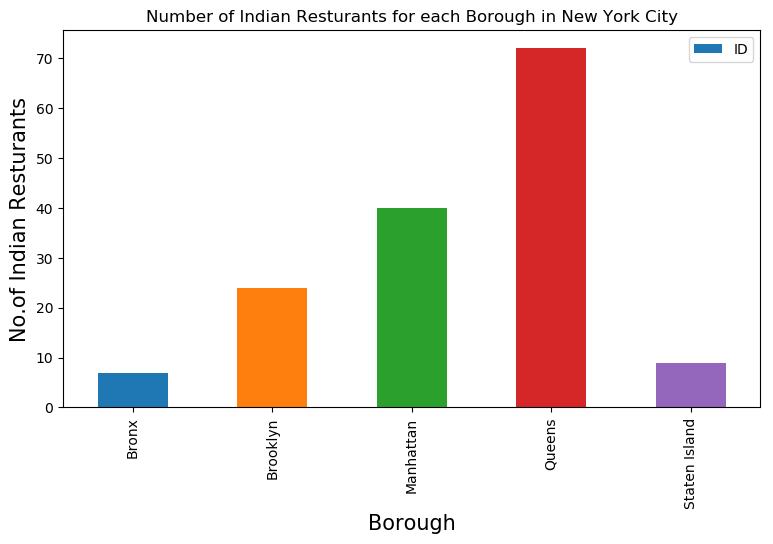

In [112]:
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Number of Indian Resturants for each Borough in New York City')
#On x-axis
plt.xlabel('Borough', fontsize = 15)
#On y-axis
plt.ylabel('No.of Indian Resturants', fontsize=15)
#giving a bar plot
indian_rest_ny.groupby('Borough')['ID'].count().plot(kind='bar')
#legend
plt.legend()
#displays the plot
plt.show()

We see that Queens has the largest number of indian resturants

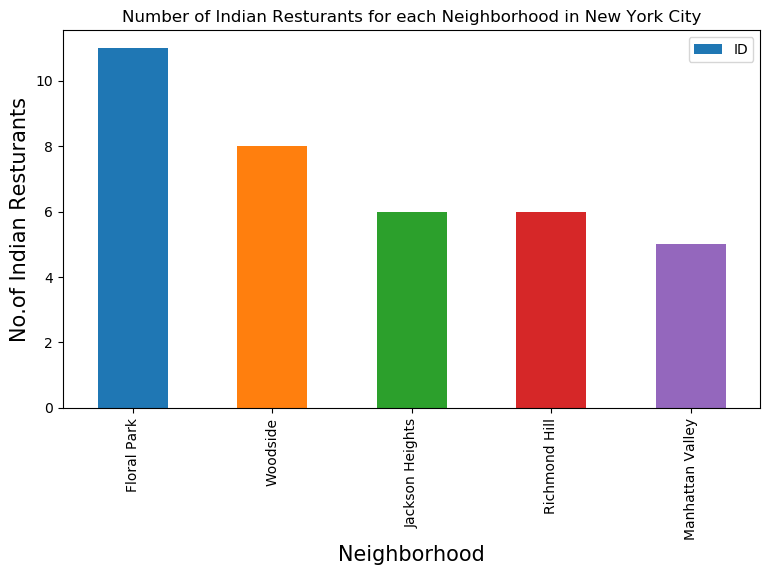

In [113]:
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Number of Indian Resturants for each Neighborhood in New York City')
#On x-axis
plt.xlabel('Neighborhood', fontsize = 15)
#On y-axis
plt.ylabel('No.of Indian Resturants', fontsize=15)
#giving a bar plot
indian_rest_ny.groupby('Neighborhood')['ID'].count().nlargest(5).plot(kind='bar')
#legend
plt.legend()
#displays the plot
plt.show()

In [114]:
indian_rest_ny[indian_rest_ny['Neighborhood']=='Floral Park']

,Borough,Neighborhood,ID,Name
101,Queens,Floral Park,527ffc0811d2d329d5e49abd,Jackson Diner
102,Queens,Floral Park,4b647b56f964a520c4b62ae3,Usha Foods & Usha Sweets
103,Queens,Floral Park,4e4e3e22bd4101d0d7a5c2d1,Kerala Kitchen
104,Queens,Floral Park,4b787c49f964a5209cd12ee3,Santoor Indian Restaurant
105,Queens,Floral Park,4c0c01e0bbc676b00d6b4cd5,Mumbai Xpress
106,Queens,Floral Park,4c76ff35a5676dcb72671721,Flavor Of India
107,Queens,Floral Park,4df0f39dd4c04d0392c853ea,Sagar Chinese
108,Queens,Floral Park,4c953a7672dd224bd8d1a191,Real Usha Sweets & Snacks Inc.
109,Queens,Floral Park,4cc642ed306e224b5bf2a76c,Shahi Darbar
110,Queens,Floral Park,51d84192498ea979a3c4f13d,Sunshine Grill & Restaurant


So Floral Park in Queens has the highest number of Indian Resturants with a total count of 9.

Now we will get the ranking of each resturant for further analysis.

In [145]:
# prepare neighborhood list that contains indian resturants
column_names=['Borough', 'Neighborhood', 'ID','Name','Likes','Rating','Tips']
indian_rest_stats_ny=pd.DataFrame(columns=column_names)
count=1


for row in indian_rest_ny.values.tolist():
    Borough,Neighborhood,ID,Name=row
    try:
        venue_details=get_venue_details(ID)
        print(venue_details)
        id,name,likes,rating,tips=venue_details.values.tolist()[0]
    except IndexError:
        print('No data available for id=',ID)
        # we will assign 0 value for these resturants as they may have been 
        #recently opened or details does not exist in FourSquare Database
        id,name,likes,rating,tips=[0]*5
    print('(',count,'/',len(indian_rest_ny),')','processed')
    indian_rest_stats_ny = indian_rest_stats_ny.append({'Borough': Borough,
                                                'Neighborhood': Neighborhood, 
                                                'ID': id,
                                                'Name' : name,
                                                'Likes' : likes,
                                                'Rating' : rating,
                                                'Tips' : tips
                                               }, ignore_index=True)
    count+=1

KeyError: 'venue'

In [116]:
indian_rest_stats_ny.head()

,Borough,Neighborhood,ID,Name,Likes,Rating,Tips
0,Bronx,Woodlawn,4c0448d9310fc9b6bf1dc761,Curry Spot,5,7.6,10
1,Bronx,Parkchester,4c194631838020a13e78e561,Melanies Roti Bar And Grill,3,5.8,2
2,Bronx,Spuyten Duyvil,4c04544df423a593ac83d116,Cumin Indian Cuisine,13,6.1,9
3,Bronx,Concourse,551b7f75498e86c00a0ed2e1,Hungry Bird,8,6.9,3
4,Bronx,Unionport,4c194631838020a13e78e561,Melanies Roti Bar And Grill,3,5.8,2


In [142]:
indian_rest_stats_ny.shape

(42, 7)

In [143]:
indian_rest_ny.shape

(152, 4)

So we got data for all resturants
Now lets save this data to a csv sheet. In case we by mistake modify it.
As the number of calls to get details for venue are premium call and have limit of 500 per day, we will refer to saved data sheet csv if required

In [144]:
indian_rest_stats_ny.to_csv('indian_rest_stats_ny.csv', index=False)

Lets verify the data from saved csv file

In [120]:
indian_rest_stats_ny_csv=pd.read_csv('indian_rest_stats_ny.csv')

In [121]:
indian_rest_stats_ny_csv.shape

(42, 7)

In [122]:
indian_rest_stats_ny_csv.head()

,Borough,Neighborhood,ID,Name,Likes,Rating,Tips
0,Bronx,Woodlawn,4c0448d9310fc9b6bf1dc761,Curry Spot,5,7.6,10
1,Bronx,Parkchester,4c194631838020a13e78e561,Melanies Roti Bar And Grill,3,5.8,2
2,Bronx,Spuyten Duyvil,4c04544df423a593ac83d116,Cumin Indian Cuisine,13,6.1,9
3,Bronx,Concourse,551b7f75498e86c00a0ed2e1,Hungry Bird,8,6.9,3
4,Bronx,Unionport,4c194631838020a13e78e561,Melanies Roti Bar And Grill,3,5.8,2


In [123]:
indian_rest_stats_ny.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 7 columns):
Borough         42 non-null object
Neighborhood    42 non-null object
ID              42 non-null object
Name            42 non-null object
Likes           42 non-null object
Rating          42 non-null float64
Tips            42 non-null object
dtypes: float64(1), object(6)
memory usage: 2.4+ KB


We see that values like Likes, Tips are strig values. We would need to convert them into float for further analysis

In [124]:
indian_rest_stats_ny['Likes']=indian_rest_stats_ny['Likes'].astype('float64')
indian_rest_stats_ny['Tips']=indian_rest_stats_ny['Tips'].astype('float64')
indian_rest_stats_ny.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 7 columns):
Borough         42 non-null object
Neighborhood    42 non-null object
ID              42 non-null object
Name            42 non-null object
Likes           42 non-null float64
Rating          42 non-null float64
Tips            42 non-null float64
dtypes: float64(3), object(4)
memory usage: 2.4+ KB


Now the data types looks correct

In [125]:
# Resturant with maximum Likes
indian_rest_stats_ny.iloc[indian_rest_stats_ny['Likes'].idxmax()]

Borough                        Manhattan
Neighborhood                     Midtown
ID              49d91c12f964a520015e1fe3
Name               The Kati Roll Company
Likes                                837
Rating                               8.8
Tips                                 258
Name: 37, dtype: object

In [126]:
# Resturant with maximum Rating
indian_rest_stats_ny.iloc[indian_rest_stats_ny['Rating'].idxmax()]

Borough                        Manhattan
Neighborhood                     Tribeca
ID              4bbb9dbded7776b0e1ad3e51
Name                    Tamarind TriBeCa
Likes                                589
Rating                               9.1
Tips                                 146
Name: 40, dtype: object

In [139]:
# Resturant with maximum Tips
indian_rest_stats_ny.iloc[indian_rest_stats_ny['Tips'].idxmax()]

Borough                        Manhattan
Neighborhood                     Midtown
ID              49d91c12f964a520015e1fe3
Name               The Kati Roll Company
Likes                                837
Rating                               8.8
Tips                                 258
Name: 37, dtype: object

Now lets visualize neighborhood with maximum average rating of resturants

In [140]:
ny_neighborhood_stats=indian_rest_stats_ny.groupby('Neighborhood',as_index=False).mean()[['Neighborhood','Rating']]
ny_neighborhood_stats.columns=['Neighborhood','Average Rating']
ny_neighborhood_stats.sort_values(['Average Rating'],ascending=False).head(10)

,Neighborhood,Average Rating
24,Tribeca,9.1
28,West Village,8.8
3,Chelsea,8.8
14,Midtown,8.8
15,Murray Hill,8.7
9,Fort Greene,8.7
30,Yorkville,8.6
16,North Side,8.5
22,South Side,8.5
0,Bay Ridge,8.4


Above are the top neighborhoods with top average rating of Indian resturants

In [141]:
ny_borough_stats=indian_rest_stats_ny.groupby('Borough',as_index=False).mean()[['Borough','Rating']]
ny_borough_stats.columns=['Borough','Average Rating']
ny_borough_stats.sort_values(['Average Rating'],ascending=False).head()

,Borough,Average Rating
2,Manhattan,8.141176
1,Brooklyn,7.810526
0,Bronx,5.366667


Similarly these are the average rating of Indian Resturants for each Borough

Lets visualize it

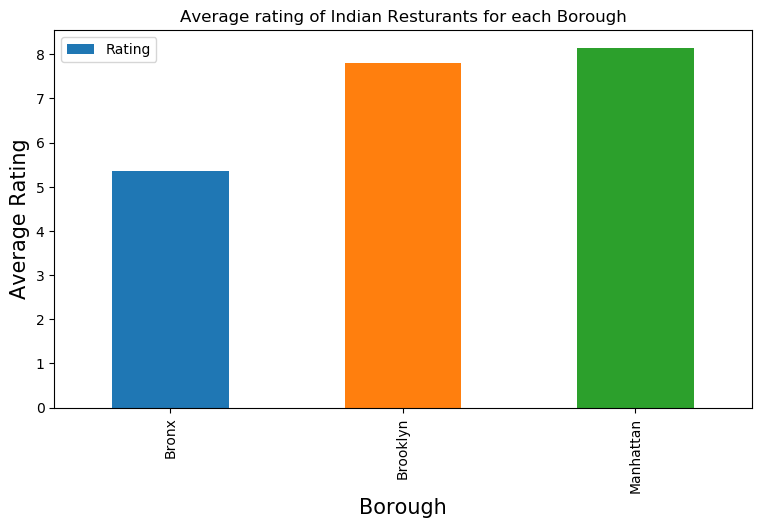

In [130]:
plt.figure(figsize=(9,5), dpi = 100)
# title
plt.title('Average rating of Indian Resturants for each Borough')
#On x-axis
plt.xlabel('Borough', fontsize = 15)
#On y-axis
plt.ylabel('Average Rating', fontsize=15)
#giving a bar plot
indian_rest_stats_ny.groupby('Borough').mean()['Rating'].plot(kind='bar')
#legend
plt.legend()
#displays the plot
plt.show()

We will consider all the neighborhoods with average rating greater or equal 9.0 to visualize on map

In [131]:
ny_neighborhood_stats=ny_neighborhood_stats[ny_neighborhood_stats['Average Rating']>=9.0]
ny_neighborhood_stats

,Neighborhood,Average Rating
24,Tribeca,9.1


We will join this dataset to original new york data to get lonitude and latitude

In [132]:
ny_neighborhood_stats=pd.merge(ny_neighborhood_stats,new_york_data, on='Neighborhood')
ny_neighborhood_stats=ny_neighborhood_stats[['Borough','Neighborhood','Latitude','Longitude','Average Rating']]
ny_neighborhood_stats

,Borough,Neighborhood,Latitude,Longitude,Average Rating
0,Manhattan,Tribeca,40.721522,-74.010683,9.1


Now we will show this data on a map

In [133]:
# create map and display it
ny_map = folium.Map(location=geo_location('New York'), zoom_start=12)


In [134]:
# instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()

# loop through the 100 crimes and add each to the incidents feature group
for lat, lng, in ny_neighborhood_stats[['Latitude','Longitude']].values:
    incidents.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=10, # define how big you want the circle markers to be
            color='yellow',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
        )
    )


Lets add a new field to dataframe for labeling purpose

In [135]:
ny_neighborhood_stats['Label']=ny_neighborhood_stats['Neighborhood']+', '+ny_neighborhood_stats['Borough']+'('+ny_neighborhood_stats['Average Rating'].map(str)+')'

In [136]:
# add pop-up text to each marker on the map
for lat, lng, label in ny_neighborhood_stats[['Latitude','Longitude','Label']].values:
    folium.Marker([lat, lng], popup=label).add_to(ny_map)        
# add incidents to map
ny_map.add_child(incidents)

Now that we have visualized the Neighborhoods.
<br>Lets Visualize Boroughs based on average Rating

In [99]:
ny_map = folium.Map(location=geo_location('New York'), zoom_start=9)
ny_geo = r'Borough Boundaries.geojson'

ny_map.choropleth(
    geo_data=ny_geo,
    data=ny_borough_stats,
    columns=['Borough', 'Average Rating'],
    key_on='feature.properties.boro_name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Average Rating'
)

# display map
ny_map
# To this is huge map data , we can save it as a html file
#ny_map.save('borough_rating.html')

C:\Users\PlayGOD\Anaconda3\lib\site-packages\folium\folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


### Conclusion 
- Astoria(Queens), Blissville(Queens), Civic Center(Manhattan) are some of the best neighborhoods for indian cuisine. 
- Manhattan have potential Indian Resturant Market/ 
- Staten Island	ranks last in average rating of Indian Resturants.
- Manhattan is the best place to stay if you prefer Indian Cuisine.

### Limitations 
- The ranking is purely on basis of rating of resturants
- The accuracy of data depends purely depends on the data provided by FourSquare